In [451]:
# GET READY
options(repr.plot.width=20, repr.plot.height=9)
source("./src_utils/merge_df.R")
source("./src_utils/my_toolbox.R")
source("./src_utils/my_components.R")
source("./src_utils/my_utils.R")
source("../../../Utils/ggplot/ggstyles.R")
source("./src_utils//my_hotspots.R")
source("./src_utils/my_prognosis_univariate.R")
library(ggplot2)
library(survival)

In [452]:
# -------------- DATA -------------- #
# CLINICAL DF
ddc = read.table("../../../DataFreeze/190308/mydata//df_clinical_cyto_selected_process_ippsr.tsv",stringsAsFactors=F,header=T,sep="\t")
# MUTATIONS MAF
ddmaf = read.table("./moredata/df_maf_driver_selected_annotated.tsv",stringsAsFactors=F,header=T,sep="\t")
# MUTATION WITH HOTSPOTS AND CYTO DF
ddhot = read.table("../../../DataFreeze/190308/mydata/df_mut_hotspot_cut5.tsv", stringsAsFactors=F,header=T,sep="\t")
ddcyto = read.table("../../../DataFreeze/190308/mydata/df_cyto_binary_impute_cut5.tsv",stringsAsFactors=F,header=T,sep="\t")
# ---------------------------------- #
if(identical(ddc$LEUKID,ddcyto$LEUKID)) print("all good")
ddcyto = ddcyto[,-1]
# TP53 STATUS
ddtp53 = read.table("./moredata/LEUKID_P53_status.tsv",sep="\t",header=T,stringsAsFactors=F)
rownames(ddtp53) = ddtp53$LEUKID
ddtp53$LEUKID = NULL
ddtp53 = ddtp53[ddc$LEUKID,]

[1] "all good"


In [453]:
table(ddtp53$TP53_monoallelic)
table(ddtp53$TP53_biallelic)


   0    1 
3131  158 


   0    1 
3048  241 

In [454]:
# ---------------------------------- #
# ADD COMPONENT
# ---------------------------------- #
ddcomp = read.table("./moredata/dd_clustered_component.tsv",header=T,sep="\t",stringsAsFactors=F)
ddcomp$predicted_component = paste0("comp_",as.character(ddcomp$predicted_component))
ddcomp = ddcomp[ddcomp$patient_key%in%ddc$LEUKID,]
if (identical(ddcomp$patient_key, ddc$LEUKID)) print("all good comp")
# ---------------------------------- #
#comp_10
#comp_9
#comp_8
#comp_6
#comp_2
# ---------------------------------- #
# ADD COMPONENT ITERATION
# ---------------------------------- #
hhcomp = read.table("./moredata/new_components_assignment.tsv",header=T,sep="\t",stringsAsFactors=F)
hhcomp$predicted_component = paste0("ncomp_",as.character(hhcomp$predicted_component))
hhcomp = hhcomp[rownames(hhcomp)%in%ddc$LEUKID,]
ffcomp = ddcomp[,"predicted_component",drop=F]
im = match(ddcomp$patient_key,rownames(hhcomp))
ffcomp[!is.na(im),"predicted_component"] = hhcomp[im[!is.na(im)],"predicted_component"]

[1] "all good comp"


In [455]:
table(ffcomp$predicted_component,exclude = F)


  comp_10    comp_2    comp_6    comp_8    comp_9   ncomp_0   ncomp_1   ncomp_2 
       17       363       284        77        26       294       720       449 
  ncomp_3   ncomp_4   ncomp_5   ncomp_6   ncomp_7 ncomp_NaN 
      374       221       199        40        70       155 

In [456]:
# -------------- ORGANIZE -------------- #
gene.features = names(rev(sort(apply(ddhot,2,sum))))
cyto.features = colnames(ddcyto)
molecular.features = c(gene.features,cyto.features)
components = names(sort(table(ffcomp$predicted_component)))
components = c("comp_10","comp_9","comp_8","comp_6","comp_2","ncomp_1","ncomp_6","ncomp_7","ncomp_5","ncomp_2","ncomp_4","ncomp_3","ncomp_0","ncomp_NaN")
ddalt = cbind(ddhot, ddcyto) # patients x all molecular features
ddall = cbind(ddc, ddalt, ffcomp) # patients X all info

In [457]:
# --- WRITE --- # 
bb = model.matrix(~ 0 + predicted_component, data=ffcomp)
colnames(bb) = gsub("predicted_component","predicted_component_",colnames(bb))
# MERGE ALL FOR ELLI
ddelli = cbind(ddall,bb)
write.table(ddelli,file="./moredata/tmp/df_all_clinical_gene_cyto_component_iteration.tsv",quote=F,sep="\t",row.names=F,col.names=T)

In [458]:
col.who = c("#e34a33","#33a02c","#b2df8a","#fa9fb5","#b2abd2","#6a3d9a","orchid4","#1f78b4","#a6cee3","#a8ddb5")
col.ipssr = c("#2ca25f","#99d8c9","#bcbddc","#fdbb84","#e34a33")
col.component = rep("#fec44f",length(components))
col.component.bis = c(brewer.pal(n=12, "Paired")[-11],"orchid3","darkcyan")
levels.who = c("MDS-del5q","MDS-SLD/MLD","MDS-RS-SLD/MLD","MDS-EB1/2","CMML","AML","aCML","MDS-U","MDS/MPN-RS-T","MDS/MPN-U")

In [459]:
# NUMBER OF GENE MUTATIONS AND NUMBER OF CYTOGENETICS EVENTS
ffmut = merge_clinical_mutation(dd_clinical=ddc, dd_maf=ddmaf, binary=FALSE, col_field="EVENT")$ddmut
ddc$number_driver_mutation = apply(ffmut,1,sum)
ddc$number_cyto_alteration = apply(ddcyto,1,sum)
# -> correct for r_1_7
j17 = which(ddcyto[,"r_1_7"]==1 & ddcyto[,"plus1q"]==1 & ddcyto[,"del7q"]==1)
ddc$num_cyto_aberrations[j17] = ddc$num_cyto_aberrations[j17] - 1
# -> correct for iso17q
jiso17 = which(ddcyto[,"iso17q"]==1 & ddcyto[,"del17p"]==1 & ddcyto[,"plus17q"]==1)
ddc$num_cyto_aberrations[jiso17] = ddc$num_cyto_aberrations[jiso17] - 1
ddall$number_driver_mutation = ddc$number_driver_mutation
ddall$number_cyto_alteration = ddc$number_cyto_alteration

# Motivation

Start to dive in each component.

# Overall Landcape

## Genomic

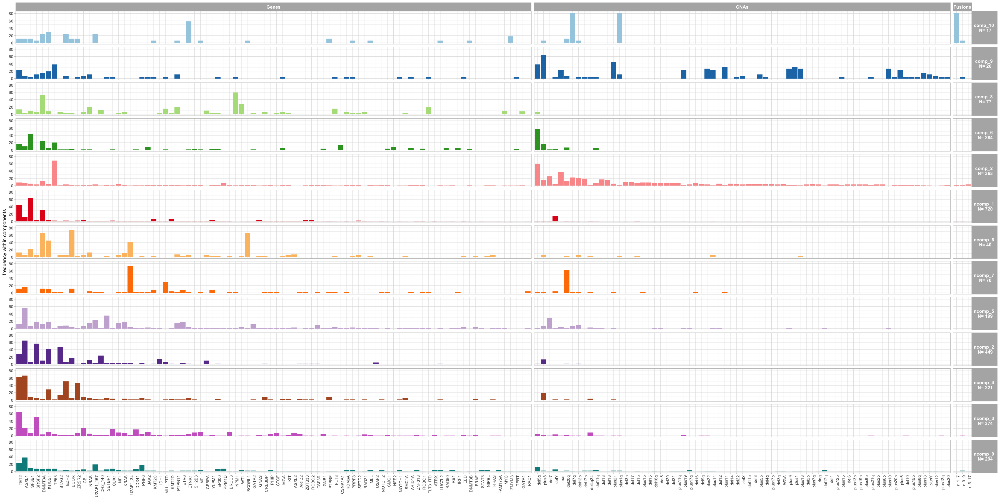

In [10]:
options(repr.plot.width=30, repr.plot.height=15)
OverallComponentLandscape(data=ddall, components=components[-14], gene.features=gene.features, cyto.features=cyto.features, maxcutfreq=3)

Below number of oncogenic gene mutations and number of cyto alterations per components

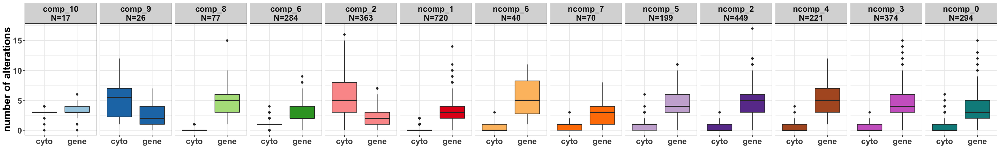

In [460]:
options(repr.plot.width=27, repr.plot.height=4)
hh = ddall
dh = data.frame(number=c(hh$number_driver_mutation,hh$number_cyto_alteration),component=rep(hh$predicted_component,2),type=rep(c("gene","cyto"),each=nrow(hh)))
dh = dh[!dh$component%in%"ncomp_NaN",]
tt = table(hh$predicted_component)[components[-14]]
dh$component = factor(dh$component, levels=components[-14])
dh$label = paste0(dh$component,"\n","N=",tt[dh$component])
dh$label = factor(dh$label, levels=unique(dh$label)[c(13,8,12,11,5,3,9,7,1,4,2,10,6)])

ggplot(dh) + geom_boxplot(aes(x=type,y=number,fill=component)) + facet_grid(.~label,scales="free") + theme1 + scale_fill_manual(values=col.component.bis) + noleg + ylab("number of alterations") + noxtitle

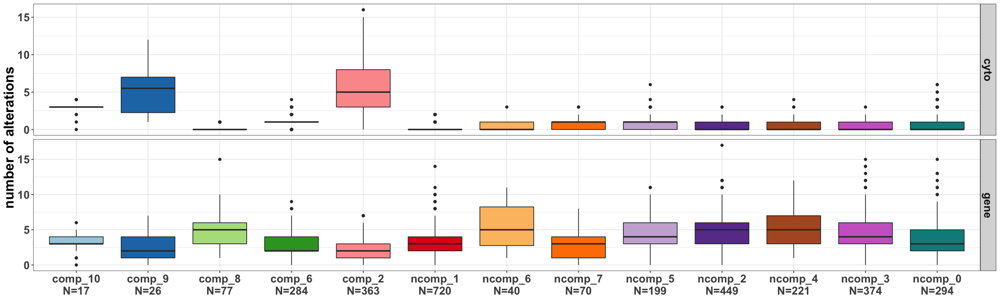

In [12]:
options(repr.plot.width=20, repr.plot.height=6)
ggplot(dh) + geom_boxplot(aes(x=label,y=number,fill=component)) + facet_grid(type~.,scales="free") + theme1 + scale_fill_manual(values=col.component.bis) + noleg + ylab("number of alterations") + noxtitle

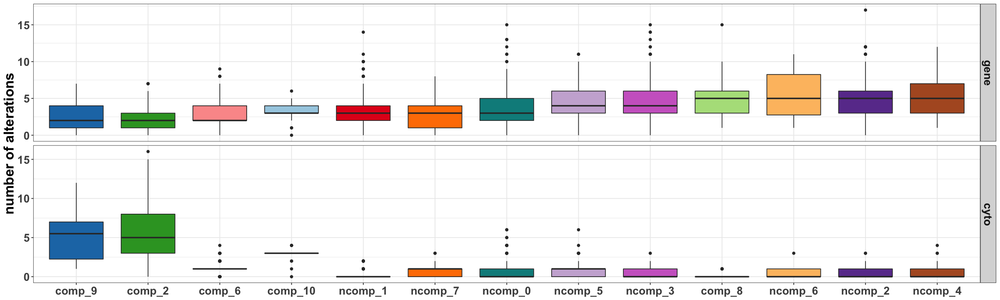

In [461]:
options(repr.plot.width=20, repr.plot.height=6)
ixsh = sort(sapply(levels(dh$component),function(c) median(hh[hh$predicted_component==c,"number_driver_mutation"])),index.r=T)$ix
#lgdh = names(sort(sapply(levels(dh$component),function(c) median(hh[hh$predicted_component==c,"number_driver_mutation"]))))
lgdh = levels(dh$component)[ixsh]
fh = dh
fh$component = factor(fh$component, levels=lgdh[c(1,3,2,4:13)])
fh$type = factor(fh$type, levels=c("gene","cyto"))
ggfh = ggplot(fh) + geom_boxplot(aes(x=component,y=number,fill=component)) + facet_grid(type~.,scales="free") + theme1 + scale_fill_manual(values=col.component.bis[ixsh]) + noleg + ylab("number of alterations") + noxtitle
ggfh

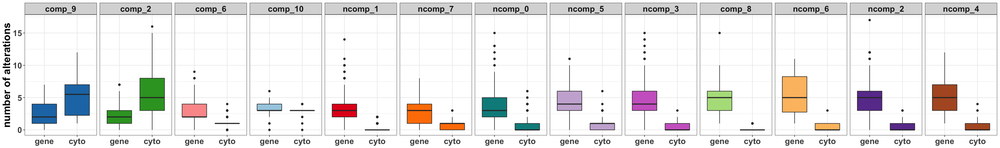

In [462]:
options(repr.plot.width=27, repr.plot.height=4)
ggplot(fh) + geom_boxplot(aes(x=type,y=number,fill=component)) + facet_grid(.~component,scales="free") + theme1 + scale_fill_manual(values=col.component.bis[ixsh]) + noleg + ylab("number of alterations") + noxtitle

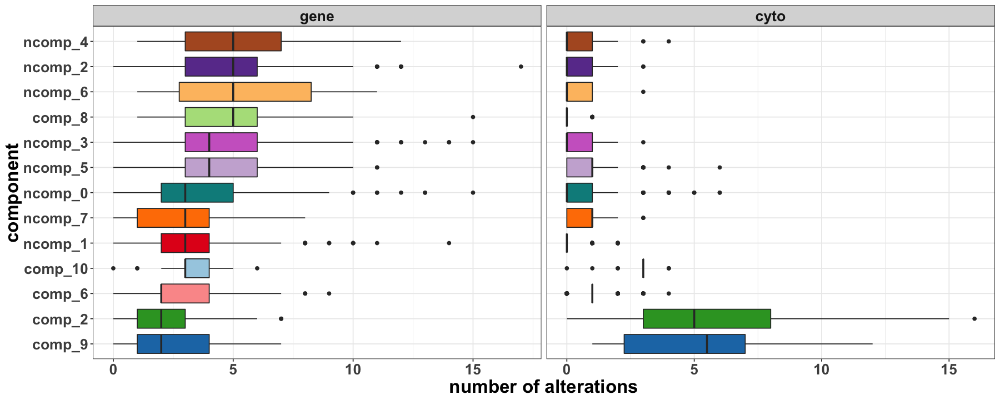

In [15]:
options(repr.plot.width=15, repr.plot.height=6)
ggplot(fh) + geom_boxplot(aes(x=component,y=number,fill=component)) + facet_grid(.~type,scales="free") + theme1 + scale_fill_manual(values=col.component.bis[ixsh]) + noleg + ylab("number of alterations")  + coord_flip()

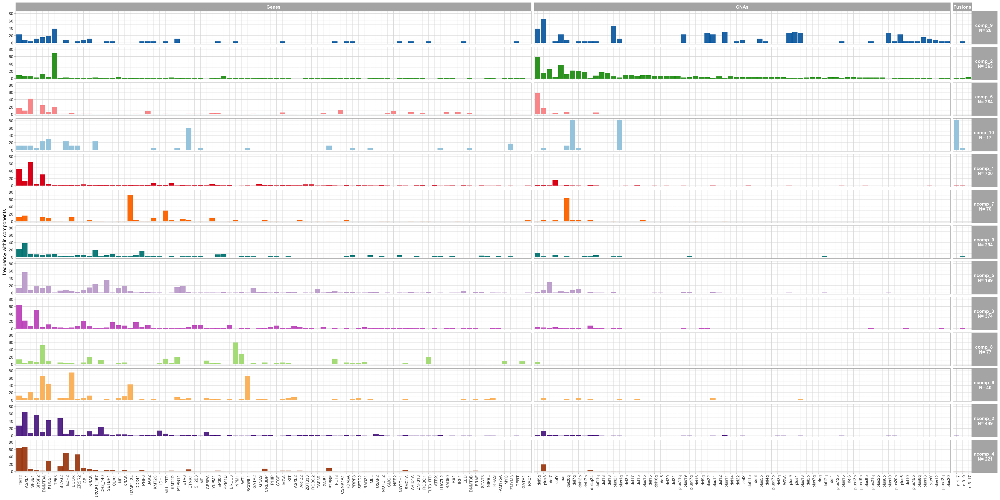

In [16]:
options(repr.plot.width=30, repr.plot.height=15)
OverallComponentLandscape(data=ddall, components=levels(fh$component), gene.features=gene.features, cyto.features=cyto.features, maxcutfreq=3,col.component=col.component.bis[ixsh])

## Clinical Correlates

In [465]:
options(repr.plot.width=30, repr.plot.height=15)
myclinical=c("AGE","HB","PLT","WBC","ANC","MONOCYTES","PB_BLAST","BM_BLAST","RINGED_SIDEROBLASTS")
data = ddall
data$AGE = data$AGE_AT_SAMPLE_TIME
hh = melt(data[,c(myclinical,"LEUKID","predicted_component")], id.vars=c("LEUKID","predicted_component"))
hh$components = factor(hh$predicted_component, levels=components)
#hh$label = paste0(hh$components," (N=",table(data$predicted_component)[as.vector(hh$components)],")")

Warning message:
“Removed 3622 rows containing non-finite values (stat_boxplot).”

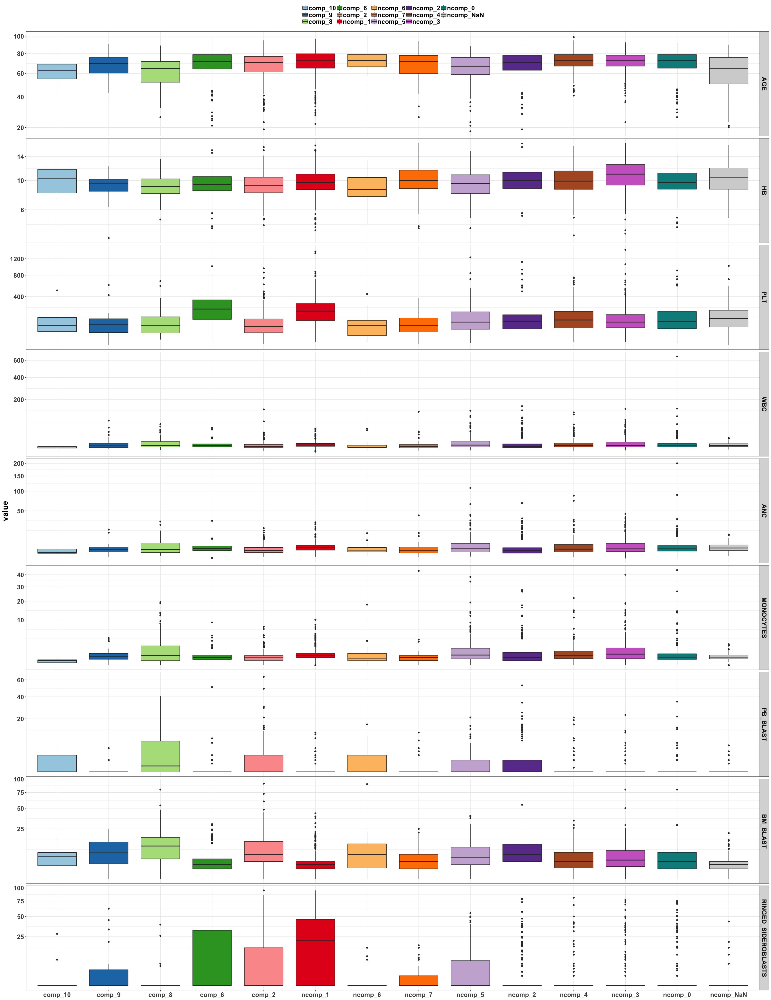

In [466]:
options(repr.plot.width=27, repr.plot.height=35)
ggplot(hh,aes(x=components,y=value,fill=components)) + geom_boxplot() + facet_grid(variable~.,scales="free") + theme1 + topleg + scale_fill_manual(values=c(col.component.bis,"lightgrey")) + nolegtitle + noxtitle + scale_y_sqrt()

Warning message:
“Removed 82 rows containing non-finite values (stat_boxplot).”Warning message:
“Removed 82 rows containing non-finite values (stat_compare_means).”

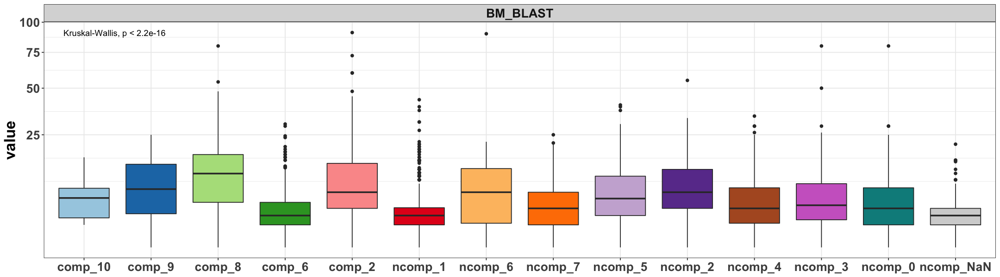

In [468]:
options(repr.plot.width=18, repr.plot.height=5)
ggplot(hh[hh$variable=="BM_BLAST",],aes(x=components,y=value,fill=components)) + geom_boxplot() + stat_compare_means() + facet_wrap(variable~.,scales="free") + theme1 + topleg + scale_fill_manual(values=c(col.component.bis,"lightgrey")) + noleg + noxtitle + scale_y_sqrt()

In [480]:
# BM BLASTS MEDIAN ORDERS
zbm = sapply(components, function(g) median(data$BM_BLAST[which(data$predicted_component==g)],na.rm=T))
bmlevels = rev(names(sort(zbm)))
zplt = sapply(components, function(g) median(data$PLT[which(data$predicted_component==g)],na.rm=T))
pltlevels = rev(names(sort(zplt)))
dbm = data ; dbm$predicted_component = factor(dbm$predicted_component, levels=bmlevels)
dplt = data ; dplt$predicted_component = factor(dplt$predicted_component, levels=pltlevels) 

In [496]:
cc = c(col.component.bis,"lightgrey")
cc[match(levels(dbm$predicted_component),components)]

[1] "#B2DF8A"   "#1F78B4"   "#6A3D9A"   "#FDBF6F"   "#FB9A99"   "#A6CEE3"  
 [7] "#CAB2D6"   "orchid3"   "darkcyan"  "#B15928"   "#FF7F00"   "lightgrey"
[13] "#E31A1C"   "#33A02C"

Warning message:
“Removed 82 rows containing non-finite values (stat_boxplot).”Warning message:
“Removed 82 rows containing non-finite values (stat_compare_means).”Warning message:
“Removed 97 rows containing non-finite values (stat_boxplot).”Warning message:
“Removed 97 rows containing non-finite values (stat_compare_means).”

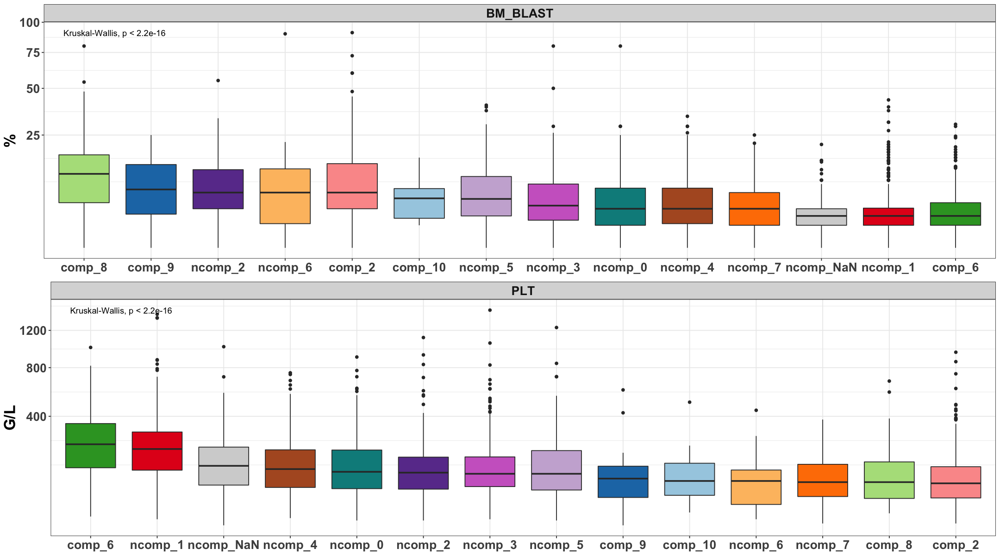

In [503]:
options(repr.plot.width=18, repr.plot.height=10)
bm.gg = ggplot(dbm,aes(x=predicted_component,y=BM_BLAST,fill=predicted_component)) + geom_boxplot() + stat_compare_means() + facet_wrap("BM_BLAST"~.,scales="free") + theme1 + topleg + 
scale_fill_manual(values=cc[match(levels(dbm$predicted_component),components)]) + noleg + noxtitle + scale_y_sqrt() + ylab("%")
bm.plt = ggplot(dplt,aes(x=predicted_component,y=PLT,fill=predicted_component)) + geom_boxplot() + stat_compare_means() + facet_wrap("PLT"~.,scales="free") + theme1 + topleg + 
scale_fill_manual(values=cc[match(levels(dplt$predicted_component),components)]) + noleg + noxtitle + scale_y_sqrt() + ylab("G/L")


grid.arrange(bm.gg,bm.plt,ncol=1)

Warning message:
“Removed 82 rows containing non-finite values (stat_ydensity).”Warning message:
“Removed 82 rows containing non-finite values (stat_compare_means).”Warning message:
“Removed 97 rows containing non-finite values (stat_ydensity).”Warning message:
“Removed 97 rows containing non-finite values (stat_compare_means).”

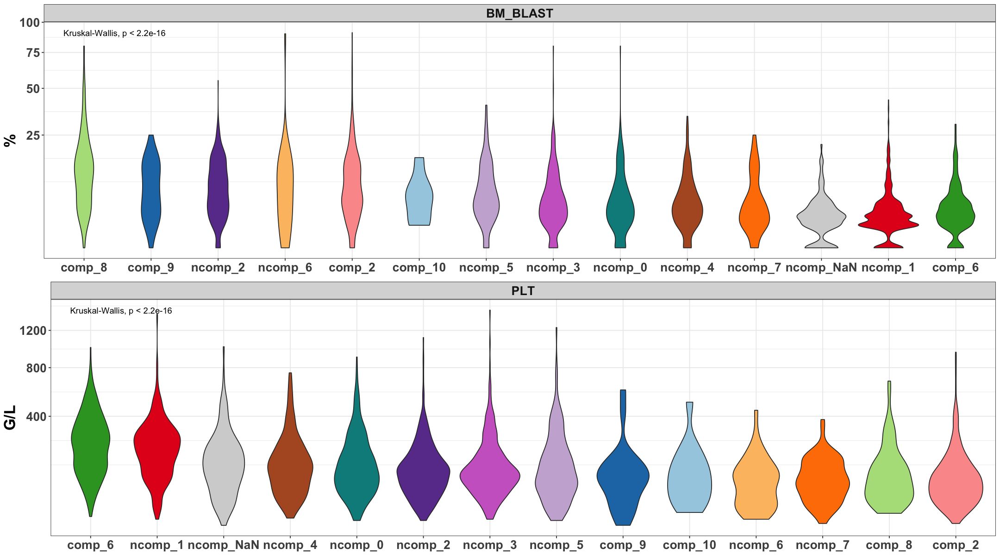

In [505]:
options(repr.plot.width=18, repr.plot.height=10)
bm.gg = ggplot(dbm,aes(x=predicted_component,y=BM_BLAST,fill=predicted_component)) + geom_violin() + stat_compare_means() + facet_wrap("BM_BLAST"~.,scales="free") + theme1 + topleg + 
scale_fill_manual(values=cc[match(levels(dbm$predicted_component),components)]) + noleg + noxtitle + scale_y_sqrt() + ylab("%")
bm.plt = ggplot(dplt,aes(x=predicted_component,y=PLT,fill=predicted_component)) + geom_violin() + stat_compare_means() + facet_wrap("PLT"~.,scales="free") + theme1 + topleg + 
scale_fill_manual(values=cc[match(levels(dplt$predicted_component),components)]) + noleg + noxtitle + scale_y_sqrt() + ylab("G/L")


grid.arrange(bm.gg,bm.plt,ncol=1)

Warning message:
“Removed 97 rows containing non-finite values (stat_boxplot).”Warning message:
“Removed 97 rows containing non-finite values (stat_compare_means).”

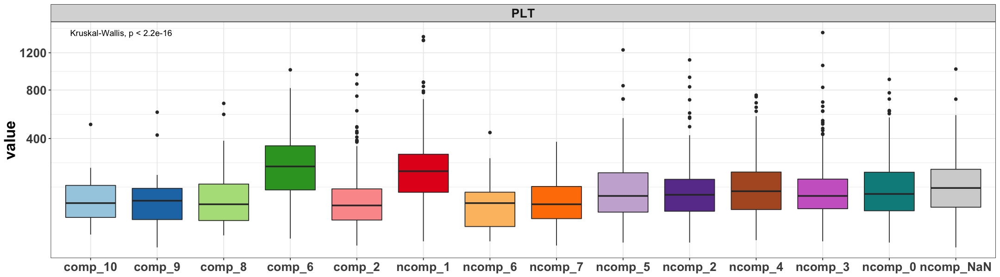

In [22]:
ggplot(hh[hh$variable=="PLT",],aes(x=components,y=value,fill=components)) + geom_boxplot() + stat_compare_means() + facet_wrap(variable~.,scales="free") + theme1 + topleg + scale_fill_manual(values=c(col.component.bis,"lightgrey")) + noleg + noxtitle + scale_y_sqrt()

Warning message:
“Removed 3622 rows containing non-finite values (stat_ydensity).”

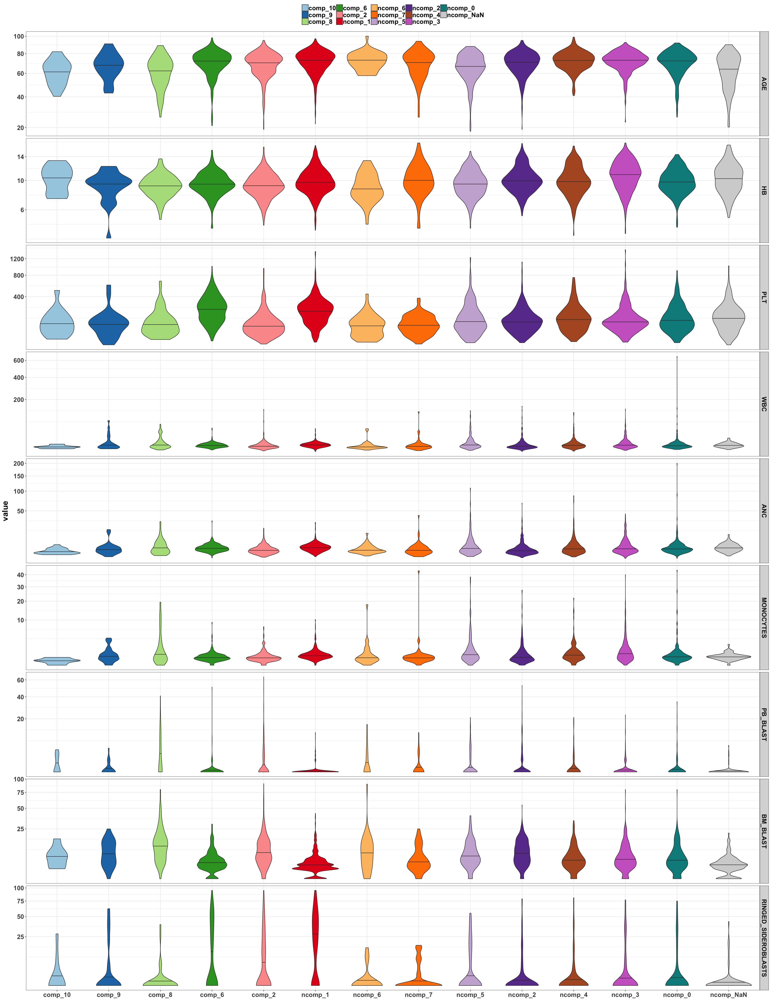

In [24]:
options(repr.plot.width=27, repr.plot.height=35)
ggplot(hh,aes(x=components,y=value,fill=components)) + geom_violin(draw_quantiles = c(0.5)) + facet_grid(variable~.,scales="free") + theme1 + topleg + scale_fill_manual(values=c(col.component.bis,"lightgrey")) + nolegtitle + noxtitle + scale_y_sqrt()

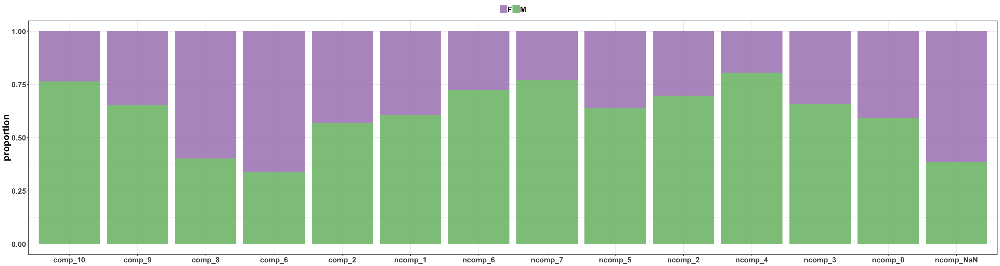

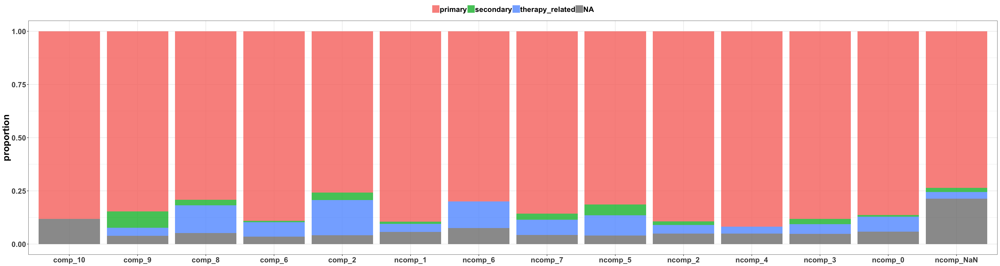

In [26]:
data$label = paste0(data$predicted_component,"\n","(N=",table(data$predicted_component)[as.vector(data$predicted_component)],")")
options(repr.plot.width=30, repr.plot.height=8)
data$predicted_component = factor(data$predicted_component, levels=components)
ggplot(data) + geom_bar(aes(x=predicted_component,fill=SEX),position="fill",alpha=.9) + theme1 + topleg + noxtitle + ylab("proportion") + nolegtitle + scale_fill_manual(values=c("#af8dc3","#7fbf7b"))
ggplot(data) + geom_bar(aes(x=predicted_component,fill=MDS_TYPE),position="fill",alpha=.8) + theme1 + topleg + noxtitle + ylab("proportion") + nolegtitle

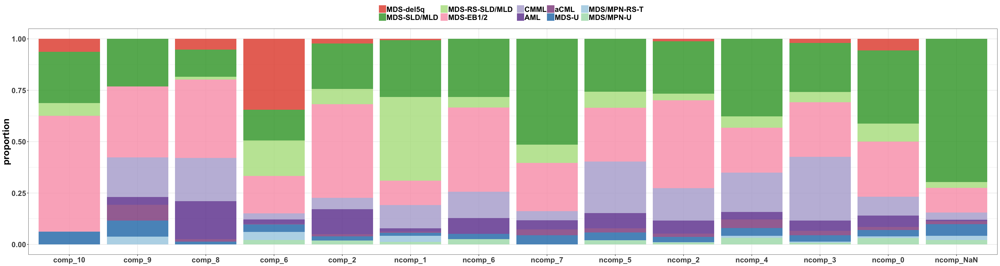

In [27]:
data = data[data$WHO_2016_SIMPLIFY_2%in%levels.who,]
data$WHO_2016_SIMPLIFY_2 = factor(data$WHO_2016_SIMPLIFY_2,levels=levels.who)
ggplot(data[]) + geom_bar(aes(x=predicted_component,fill=WHO_2016_SIMPLIFY_2),position="fill",alpha=.8) + theme1 + topleg + noxtitle + ylab("proportion") + nolegtitle + scale_fill_manual(values=col.who)

## Outcome

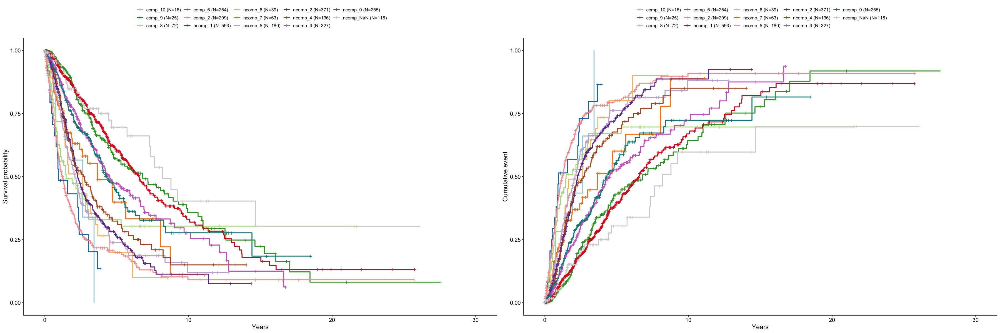

In [28]:
options(repr.plot.width=30, repr.plot.height=10)
# Overall Survival
ff = as.formula(paste("Surv(os_diag_years,os_status)~predicted_component"))
kmfit = survfit(ff,data=data)
kmfit$call$formula <- ff
myleg = paste0(gsub("predicted_component=","",names(kmfit$strata))," (N=",kmfit$strata,")")
ggOS = ggsurvplot(kmfit, data = data, legend.title="",legend.labs=myleg,conf.int=F)$plot + scale_color_manual(values=c(col.component.bis,"lightgrey")) + xlab("Years")
# AML
ff = as.formula(paste("Surv(os_diag_years,os_status)~predicted_component"))
kmfit = survfit(ff,data=data)
kmfit$call$formula <- ff
myleg = paste0(gsub("predicted_component=","",names(kmfit$strata))," (N=",kmfit$strata,")")
ggAML = ggsurvplot(kmfit, data = data, legend.title="",legend.labs=myleg,conf.int=F,fun="event")$plot + scale_color_manual(values=c(col.component.bis,"lightgrey")) + xlab("Years")
grid.arrange(ggOS,ggAML,ncol=2)

# Component 10

In [16]:
paste("count is ",sum(ddall$predicted_component=="comp_10"))
paste("freq is ",round(100*sum(ddall$predicted_component=="comp_10")/nrow(ddall),2),"%")

[1] "count is  17"

[1] "freq is  0.52 %"

In [17]:
table(ddall[ddall$predicted_component=="comp_10","CENTER"])


 CGM  DUS  HMS   KI   PV RMCN 
   4    3    1    3    1    5 

In [18]:
res = ComponentEventFreq(data=ddall, mycomponent="comp_10", molecular.features=molecular.features, mycol=col.component[10], mycut=1)

## Count and Frequency within component

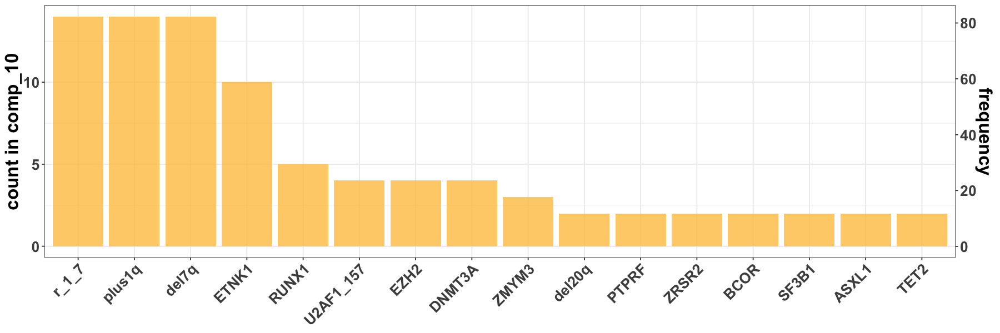

In [19]:
options(repr.plot.width=15, repr.plot.height=5)
res$gbar

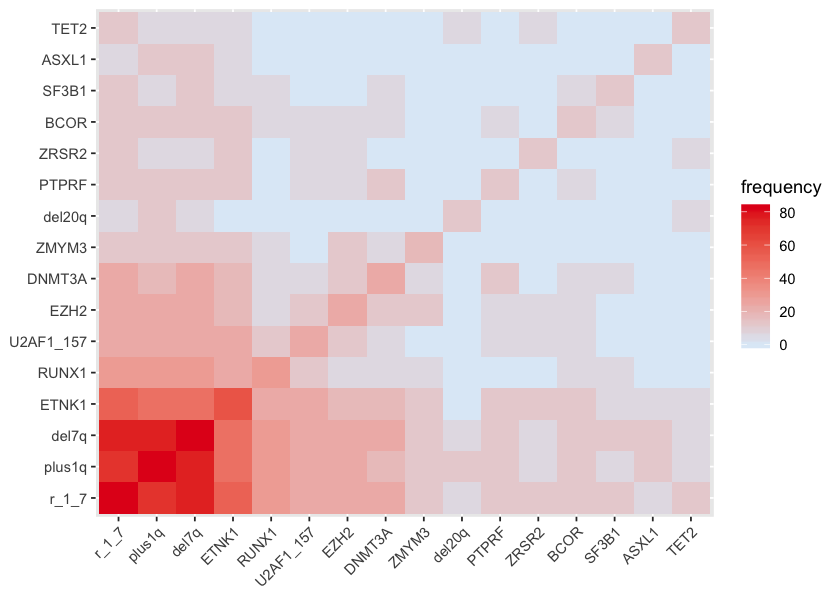

In [20]:
options(repr.plot.width=7, repr.plot.height=5)
res$gfreq

## Clinical Correlations

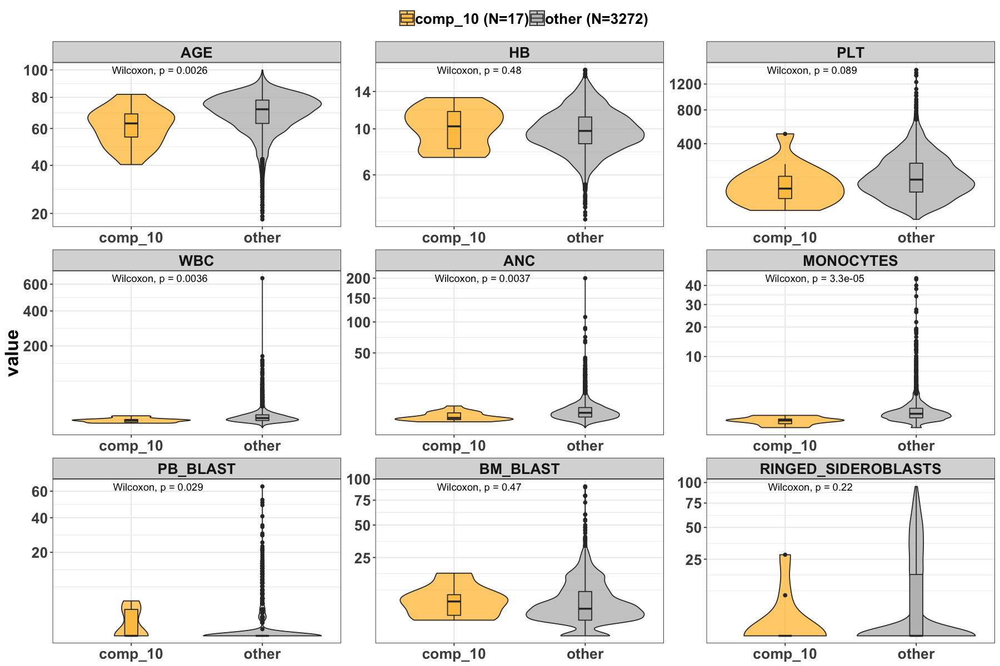

In [21]:
options(warn=-1)
options(repr.plot.width=15, repr.plot.height=10)
ComponentContinuousClinical(data=ddall, mycomponent="comp_10", mycol=col.component[10])

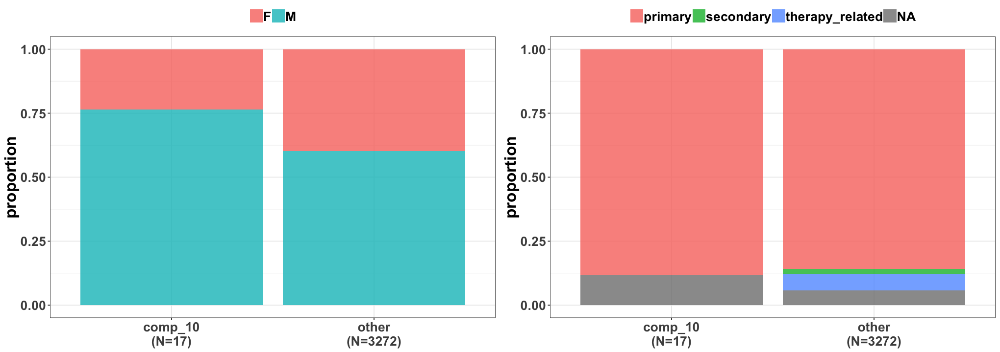

In [22]:
options(repr.plot.width=17, repr.plot.height=6)
gsex = ComponentDiscreteClinical(data=ddall, mycomponent="comp_10", mydiscrete="SEX") 
gmds = ComponentDiscreteClinical(data=ddall, mycomponent="comp_10", mydiscrete="MDS_TYPE")
grid.arrange(gsex,gmds,ncol=2)

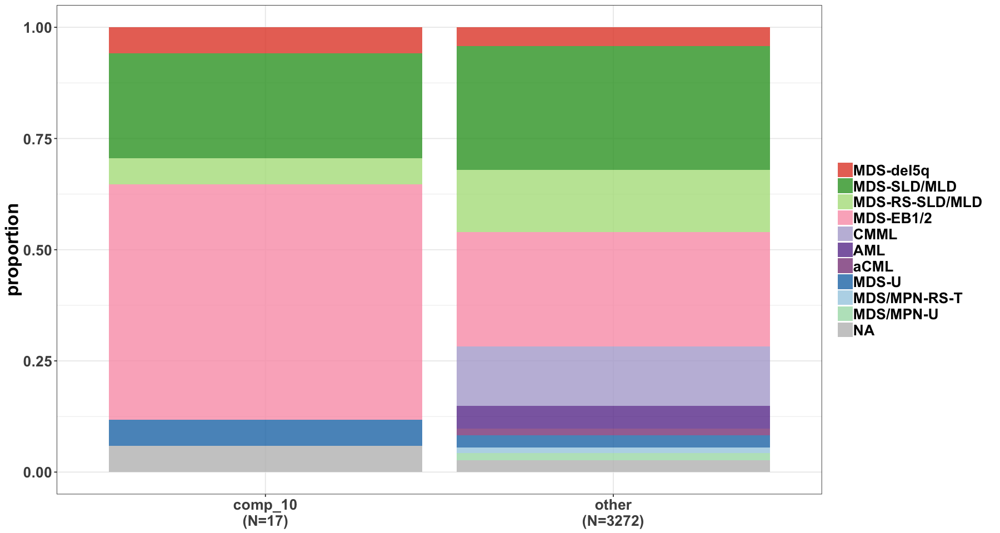

In [23]:
options(repr.plot.width=15, repr.plot.height=8)
ComponentWHO(data=ddall, mycomponent="comp_10")

## Outcome

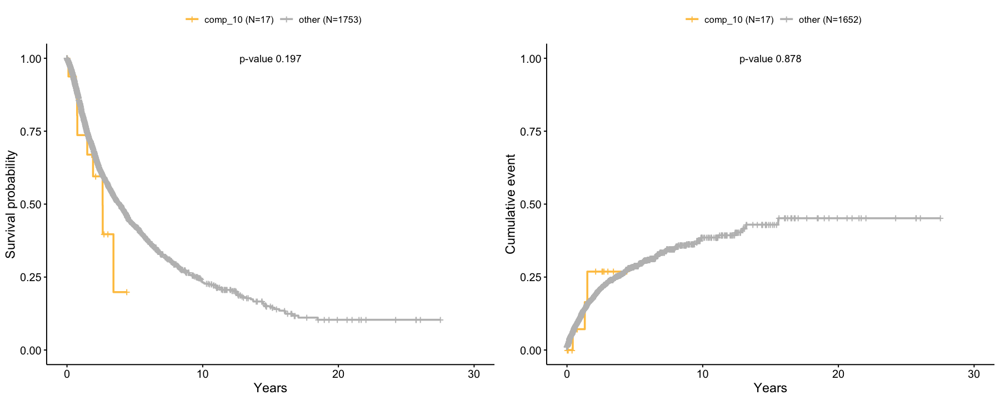

In [24]:
options(repr.plot.width=15, repr.plot.height=6)
res = ComponentOutcome(data=ddall, mycomponent="comp_10", mycol=col.component[10])
grid.arrange(res$ggOS,res$ggAML,ncol=2)

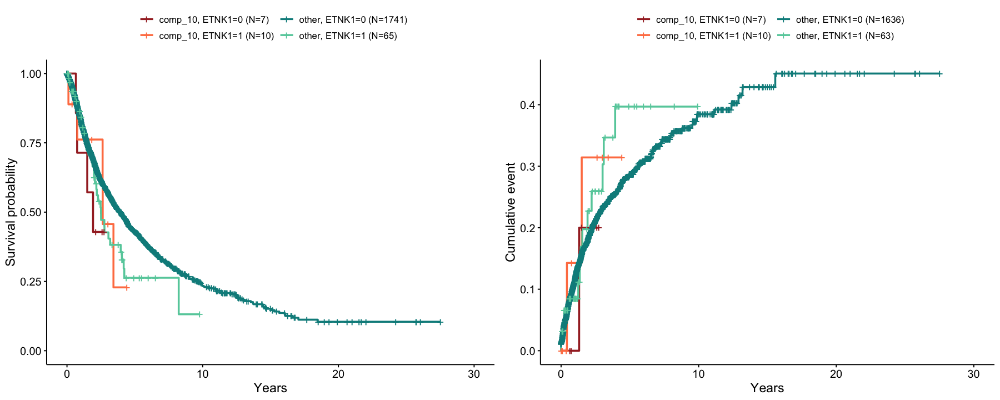

In [25]:
res = MiscComponentOutcome(data=ddall, mycomponent="comp_10", covariate="ETNK1")
grid.arrange(res$ggOS,res$ggAML,ncol=2)

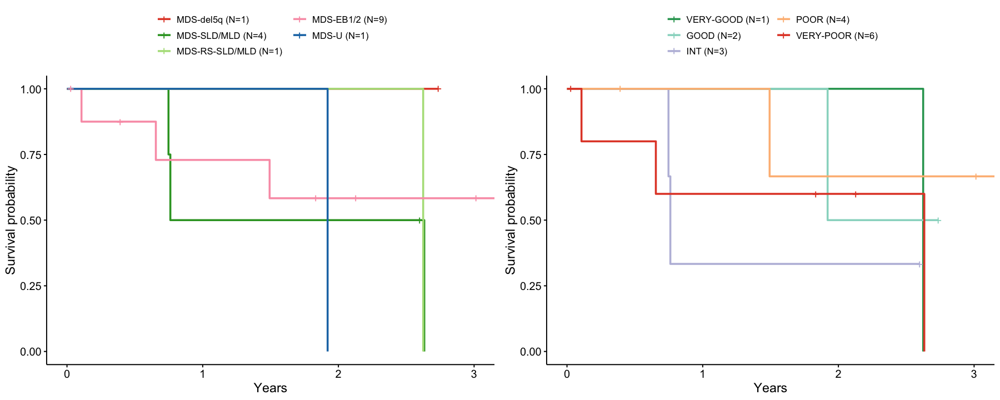

In [26]:
res = ComponentOutcomeStratified(data=ddall,mycomponent="comp_10") 
grid.arrange(res$ggwho,res$ggipssr,ncol=2)

## Conclusion

Component 10 seems

- to be really a der(1,7) and ETNK1 class
- enriched in youger and male individuals 
- to have low WBC | ANC | Monocytes
- ...



# Component 9

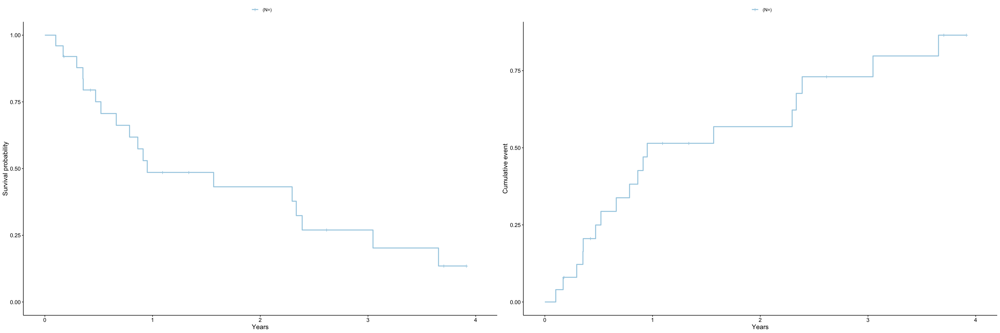

In [27]:
data = ddall[ddall$predicted_component%in%c("comp_9","comp2"),]
options(repr.plot.width=30, repr.plot.height=10)
# Overall Survival
ff = as.formula(paste("Surv(os_diag_years,os_status)~predicted_component"))
kmfit = survfit(ff,data=data)
kmfit$call$formula <- ff
myleg = paste0(gsub("predicted_component=","",names(kmfit$strata))," (N=",kmfit$strata,")")
ggOS = ggsurvplot(kmfit, data = data, legend.title="",legend.labs=myleg,conf.int=F)$plot + scale_color_manual(values=c(col.component.bis,"lightgrey")) + xlab("Years")
# AML
ff = as.formula(paste("Surv(os_diag_years,os_status)~predicted_component"))
kmfit = survfit(ff,data=data)
kmfit$call$formula <- ff
myleg = paste0(gsub("predicted_component=","",names(kmfit$strata))," (N=",kmfit$strata,")")
ggAML = ggsurvplot(kmfit, data = data, legend.title="",legend.labs=myleg,conf.int=F,fun="event")$plot + scale_color_manual(values=c(col.component.bis,"lightgrey")) + xlab("Years")
grid.arrange(ggOS,ggAML,ncol=2)

In [28]:
paste("count is ",sum(ddall$predicted_component=="comp_9"))
paste("freq is ",round(100*sum(ddall$predicted_component=="comp_9")/nrow(ddall),2),"%")

[1] "count is  26"

[1] "freq is  0.79 %"

In [29]:
res = ComponentEventFreq(data=ddall, mycomponent="comp_9", molecular.features=molecular.features, mycol=col.component[9], mycut=1)

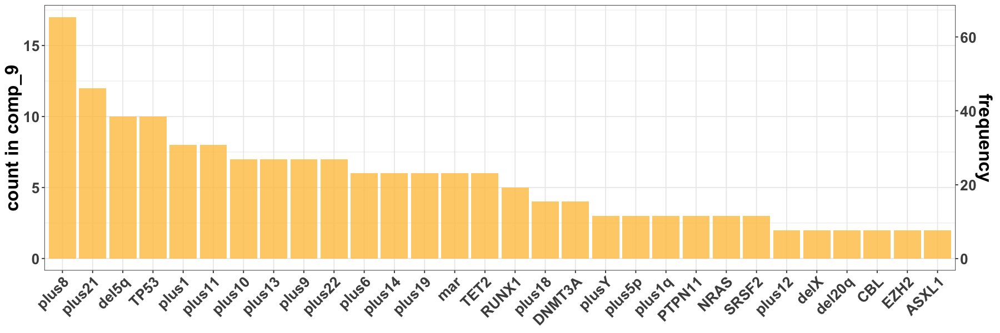

In [30]:
options(repr.plot.width=15, repr.plot.height=5)
res$gbar

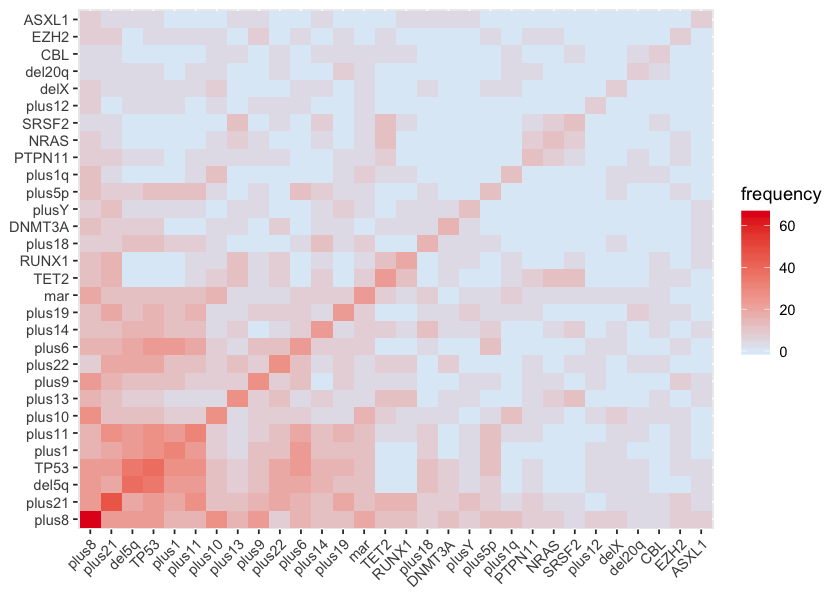

In [31]:
options(repr.plot.width=7, repr.plot.height=5)
res$gfreq

Note that you have here co-occurence of plus21 and RUNX1. Those cases show a VAF consistent with amplification of mutated RUNX1,
with a recurrence in amino-acid R162.

In [32]:
aa = ddall[ddall$predicted_component=="comp_9",]
ddmaf[ddmaf$TARGET_NAME%in%aa[which(aa$plus21==1 & aa$RUNX1==1),"LEUKID"] & ddmaf$EVENT=="RUNX1",c("EVENT","PROTEIN_CHANGE","VAF","VAF_CORRECTED")]

,EVENT,PROTEIN_CHANGE,VAF,VAF_CORRECTED
1406,RUNX1,p.R162S,0.619,0.46425
1442,RUNX1,p.N136Y,0.592,0.44400
1952,RUNX1,p.R162K,0.699,0.52425
9141,RUNX1,p.R162G,0.068,0.06800


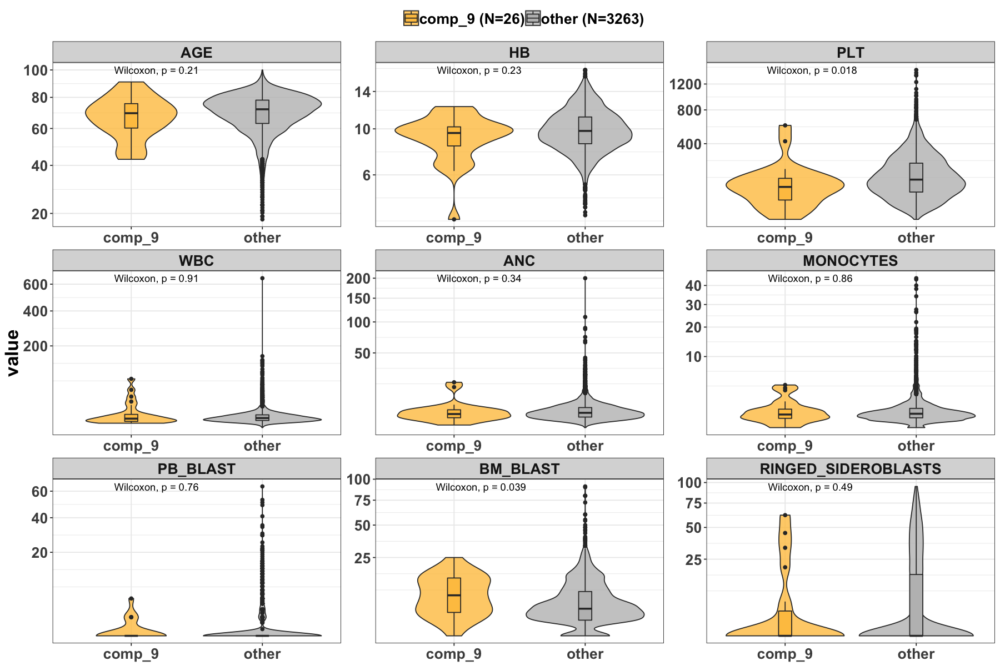

In [33]:
options(warn=-1)
options(repr.plot.width=15, repr.plot.height=10)
ComponentContinuousClinical(data=ddall, mycomponent="comp_9", mycol=col.component[9])

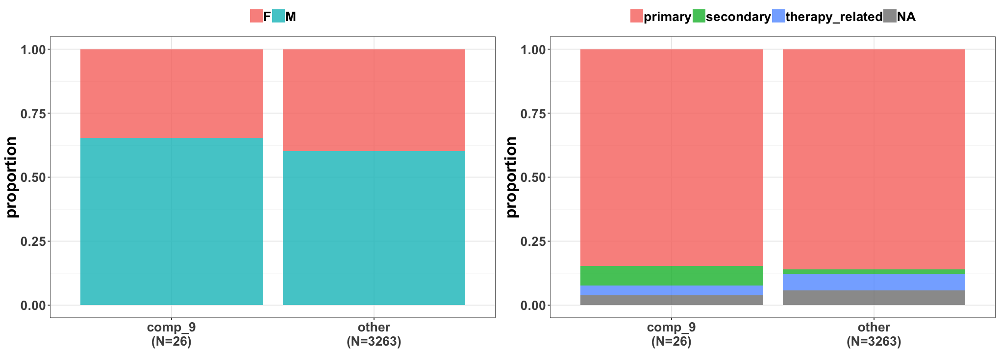

In [34]:
options(repr.plot.width=17, repr.plot.height=6)
gsex = ComponentDiscreteClinical(data=ddall, mycomponent="comp_9", mydiscrete="SEX") 
gmds = ComponentDiscreteClinical(data=ddall, mycomponent="comp_9", mydiscrete="MDS_TYPE")
grid.arrange(gsex,gmds,ncol=2)

In [35]:
table(ddall[ddall$predicted_component=="comp_9","MDS_TYPE"])
summary(apply(ddall[ddall$predicted_component=="comp_9",cyto.features],1,sum))


        primary       secondary therapy_related 
             22               2               1 

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
  1.000   2.250   5.500   5.462   7.000  12.000 

**Overall complex karyotype cases**

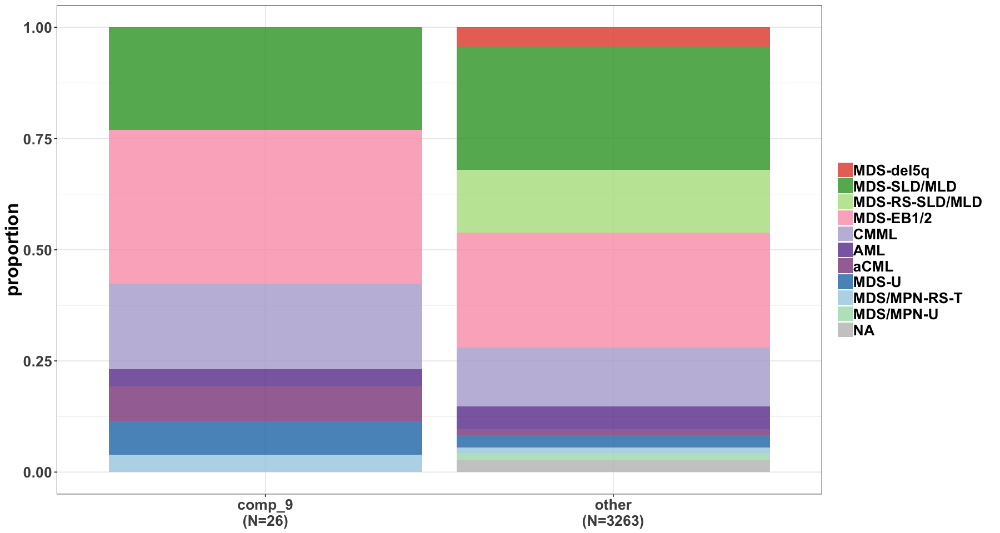

In [36]:
options(repr.plot.width=15, repr.plot.height=8)
ComponentWHO(data=ddall, mycomponent="comp_9")

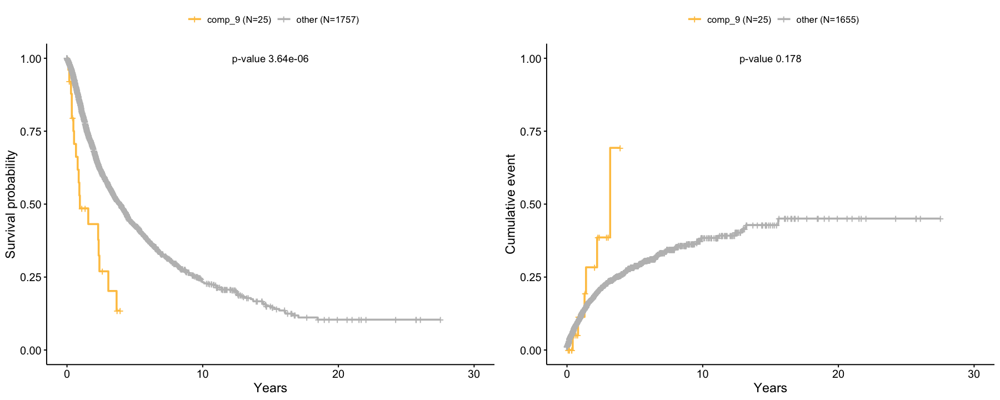

In [37]:
options(repr.plot.width=15, repr.plot.height=6)
res = ComponentOutcome(data=ddall, mycomponent="comp_9", mycol=col.component[9])
grid.arrange(res$ggOS,res$ggAML,ncol=2)

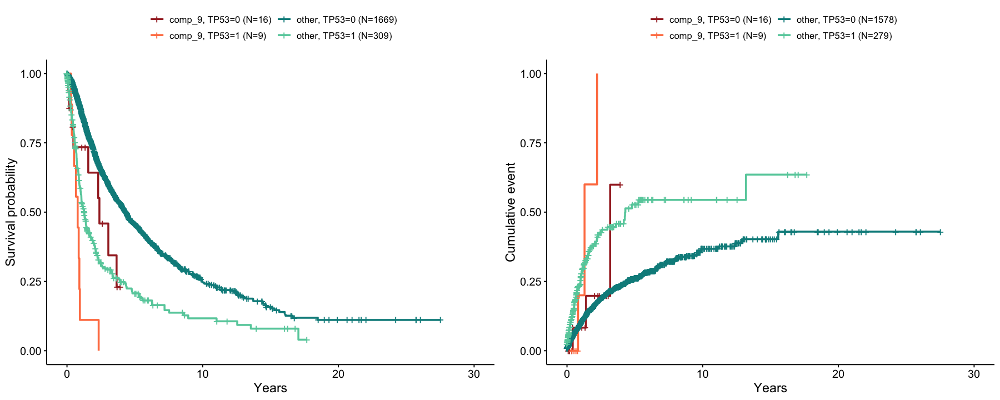

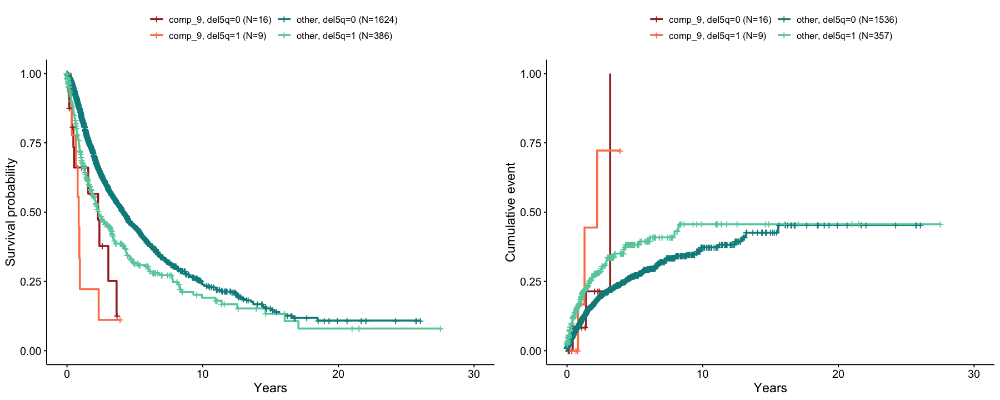

In [38]:
res = MiscComponentOutcome(data=ddall, mycomponent="comp_9", covariate="TP53")
grid.arrange(res$ggOS,res$ggAML,ncol=2)
res = MiscComponentOutcome(data=ddall, mycomponent="comp_9", covariate="del5q")
grid.arrange(res$ggOS,res$ggAML,ncol=2)

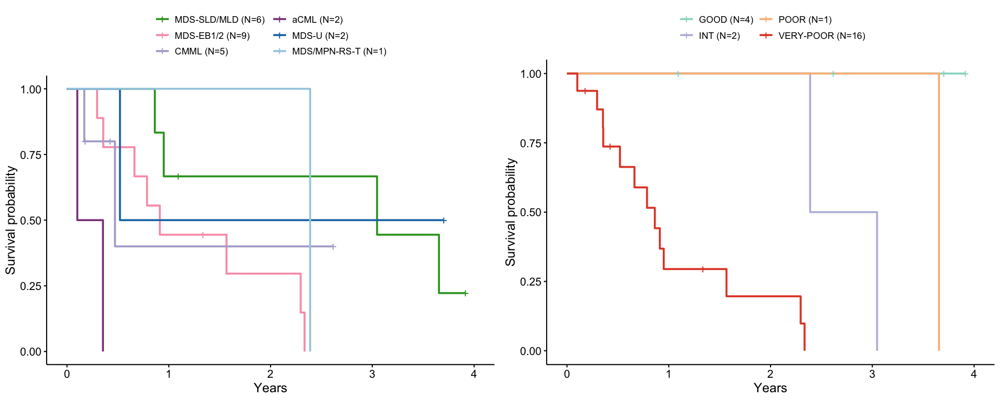

In [39]:
res = ComponentOutcomeStratified(data=ddall,mycomponent="comp_9") 
grid.arrange(res$ggwho,res$ggipssr,ncol=2)

## Conclusion

Component 9 is:

- a cluster of plus and TP53

- it has some R162 RUNX1 amplified

- relatively high blasts and poor outcome


NB: **TP53 status:**

In [40]:
j = which(ddall$predicted_component=="comp_9" & ddall$TP53==1)
ddtp53[j,]

,TP53_monoallelic,TP53_biallelic
E-H-105628-T1-1-D1-1,0,1
E-H-116751-T1-1-D1-1,0,1
E-H-116475-T1-1-D1-1,1,0
E-H-116438-T1-1-D1-1,0,1
E-H-121102-T1-1-D1-3,0,1
E-H-117997-T1-1-D1-1,0,1
E-H-118034-T1-1-D1-1,0,1
E-H-131492-T1-1-D1-1,0,1
E-H-118179-T1-1-D1-1,0,1
E-H-102707-T1-1-D1-1,0,1


In [41]:
ddmaf[ddmaf$TARGET_NAME%in%ddall$LEUKID[j] & ddmaf$GENE=="TP53",c("TARGET_NAME","GENE","PROTEIN_CHANGE","VAF","VAF_CORRECTED")]

,TARGET_NAME,GENE,PROTEIN_CHANGE,VAF,VAF_CORRECTED
1598,E-H-102707-T1-1-D1-1,TP53,p.P177_C182delPHHERC,0.6591,0.32955
2773,E-H-105628-T1-1-D1-1,TP53,p.?,0.8400,0.42000
5578,E-H-116438-T1-1-D1-1,TP53,p.V173M,0.4230,0.42300
5579,E-H-116438-T1-1-D1-1,TP53,p.R110L,0.4270,0.42700
5673,E-H-116475-T1-1-D1-1,TP53,p.T170M,0.4960,0.49600
6461,E-H-116751-T1-1-D1-1,TP53,p.R248Q,0.9600,0.48000
7112,E-H-117997-T1-1-D1-1,TP53,p.L194R,0.7500,0.37500
7204,E-H-118034-T1-1-D1-1,TP53,p.I232T,0.7750,0.38750
7350,E-H-118179-T1-1-D1-1,TP53,p.M237I,0.2900,0.29000
8918,E-H-121102-T1-1-D1-3,TP53,p.S215fs*32,0.6001,0.30005


NB: high ringed sideroblasts?

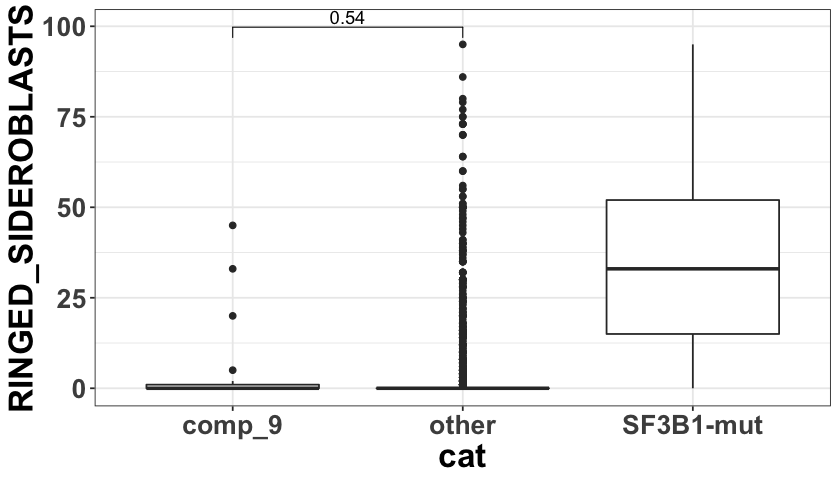

In [42]:
options(repr.plot.width=7, repr.plot.height=4)
options(warn=-1)
aa = ddall
aa$cat = "other"
aa$cat[aa$predicted_component=="comp_9"] = "comp_9"
aa$cat[aa$SF3B1==1] = "SF3B1-mut"
ggplot(aa,aes(x=cat,y=RINGED_SIDEROBLASTS)) + geom_boxplot() + stat_compare_means(comparisons = list(c(1,2))) + theme1

...not really

# Component 8

In [43]:
paste("count is ",sum(ddall$predicted_component=="comp_8"))
paste("freq is ",round(100*sum(ddall$predicted_component=="comp_8")/nrow(ddall),2),"%")

[1] "count is  77"

[1] "freq is  2.34 %"

In [44]:
res = ComponentEventFreq(data=ddall, mycomponent="comp_8", molecular.features=molecular.features, mycol=col.component[8], mycut=2)

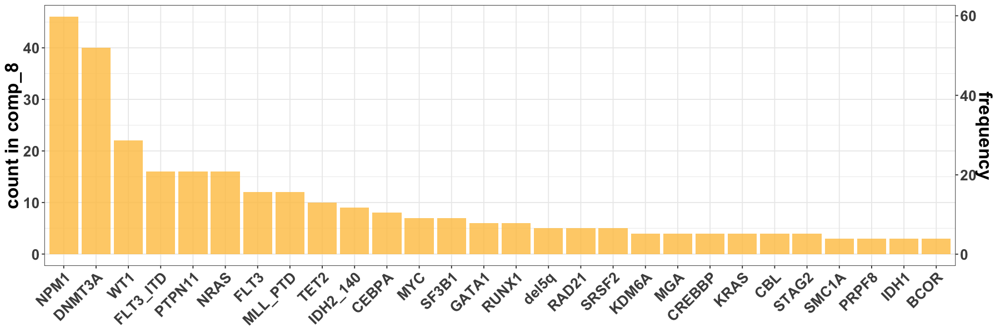

In [45]:
options(repr.plot.width=15, repr.plot.height=5)
res$gbar

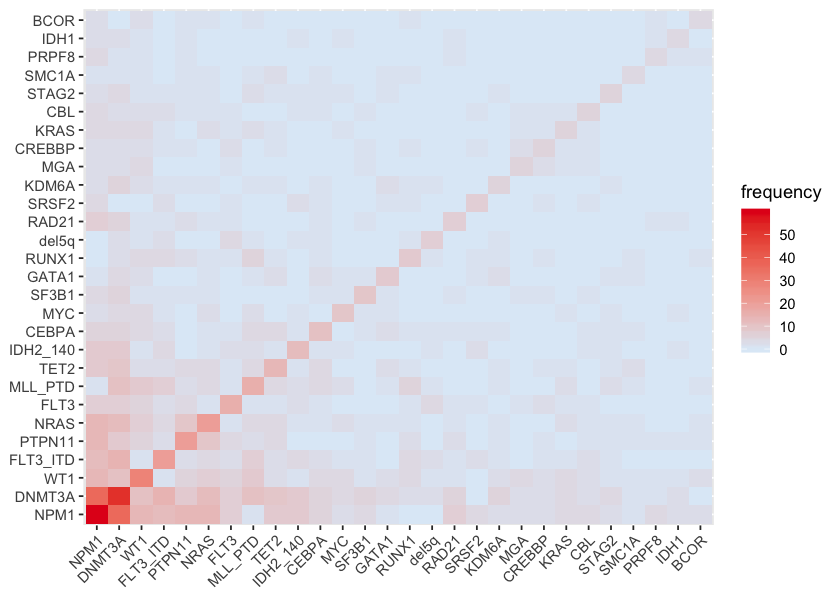

In [46]:
options(repr.plot.width=7, repr.plot.height=5)
res$gfreq

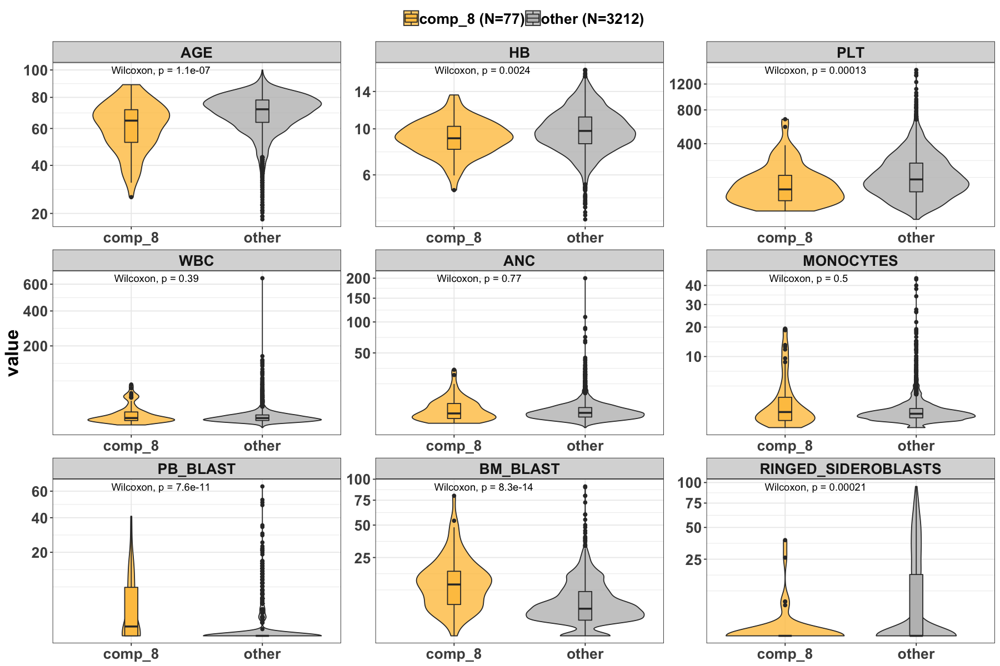

In [47]:
options(warn=-1)
options(repr.plot.width=15, repr.plot.height=10)
ComponentContinuousClinical(data=ddall, mycomponent="comp_8", mycol=col.component[8])

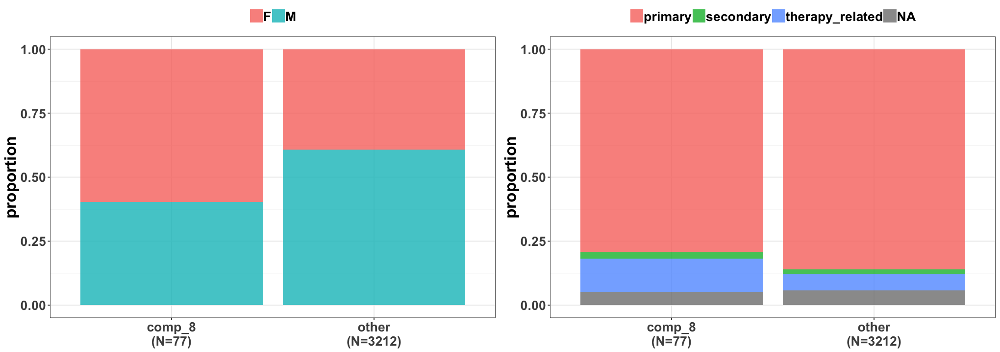

In [48]:
options(repr.plot.width=17, repr.plot.height=6)
gsex = ComponentDiscreteClinical(data=ddall, mycomponent="comp_8", mydiscrete="SEX") 
gmds = ComponentDiscreteClinical(data=ddall, mycomponent="comp_8", mydiscrete="MDS_TYPE")
grid.arrange(gsex,gmds,ncol=2)

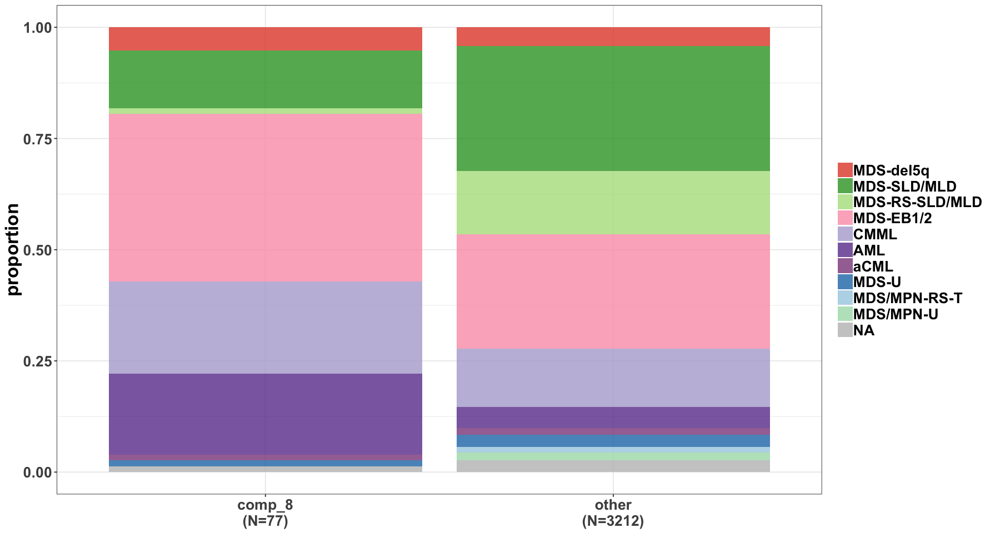

In [49]:
options(repr.plot.width=15, repr.plot.height=8)
ComponentWHO(data=ddall, mycomponent="comp_8")

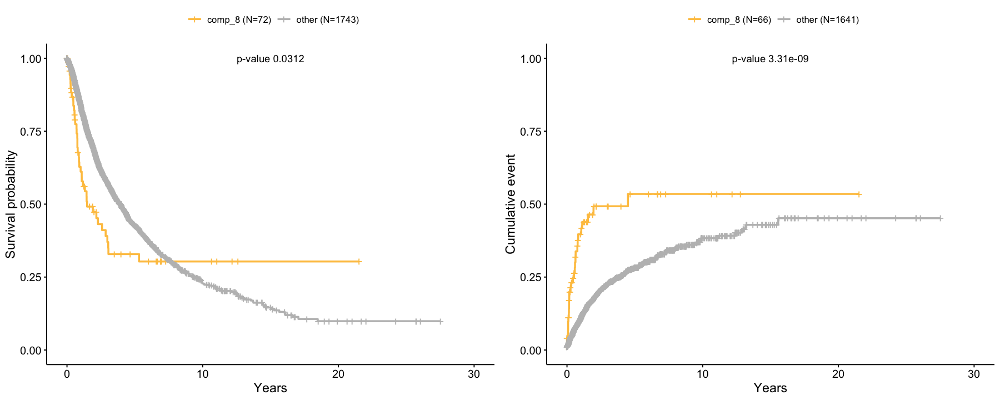

In [50]:
options(repr.plot.width=15, repr.plot.height=6)
res = ComponentOutcome(data=ddall, mycomponent="comp_8", mycol=col.component[8])
grid.arrange(res$ggOS,res$ggAML,ncol=2)

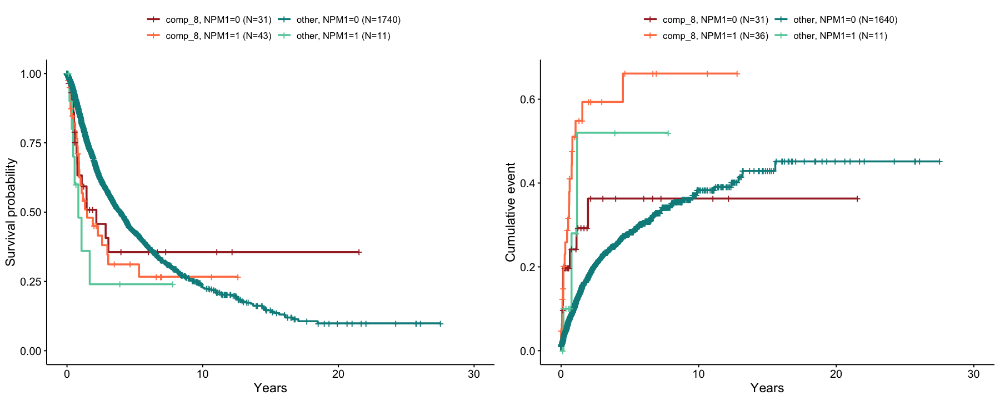

In [51]:
res = MiscComponentOutcome(data=ddall, mycomponent="comp_8", mycol="orange", covariate="NPM1")
grid.arrange(res$ggOS,res$ggAML,ncol=2)

In [52]:
table(ddall[ddall$NPM1==1,"predicted_component"])


 comp_2  comp_8  comp_9 ncomp_0 ncomp_2 ncomp_4 ncomp_5 ncomp_7 
      2      46       1       2       1       1       2       2 

In [53]:
summary(ddall[ddall$predicted_component=="comp_8","BM_BLAST"])
summary(ddall[ddall$NPM1==1,"BM_BLAST"])

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max.    NA's 
   0.00    4.00   10.75   13.97   17.00   80.00       1 

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max.    NA's 
   2.00    6.00   13.00   16.45   22.25   80.00       1 

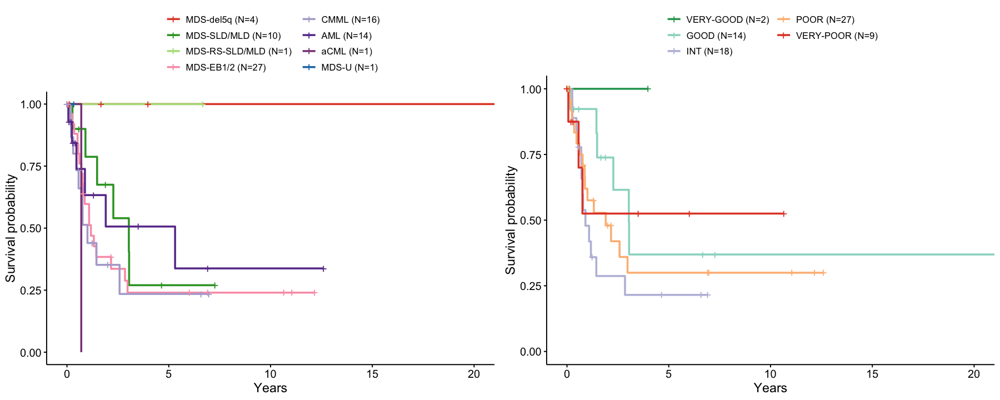

In [54]:
res = ComponentOutcomeStratified(data=ddall,mycomponent="comp_8") 
grid.arrange(res$ggwho,res$ggipssr,ncol=2)

## Conclusion:

Component 8 is:

- very AML like molecularly with NPM1 with WT1 and FLT3-ITD and MLD-PTD with WT1

- younger age, low Hb, low Plt, very high Blast.

- enriched in Female

- enriched in WHO EB1/2, CMML, AML.

- very strong progression to AML.

- **importantly,** in that class the WHO category segregates together in OS (AML,CMML,EB1/2,MLD/SLD). The IPSSR-INT also segregates with the Poor.

# NPM1

In [411]:
aa =  ddall[ddall$NPM1==1,]
paste("Number of NPM1 mutated is",nrow(aa))

[1] "Number of NPM1 mutated is 57"

In [412]:
table(aa$predicted_component)


 comp_2  comp_8  comp_9 ncomp_0 ncomp_2 ncomp_4 ncomp_5 ncomp_7 
      2      46       1       2       1       1       2       2 

**Mostly in component 8 but 11 other cases across other components. Note that above we showed that they also do bad, similarly to component 8**

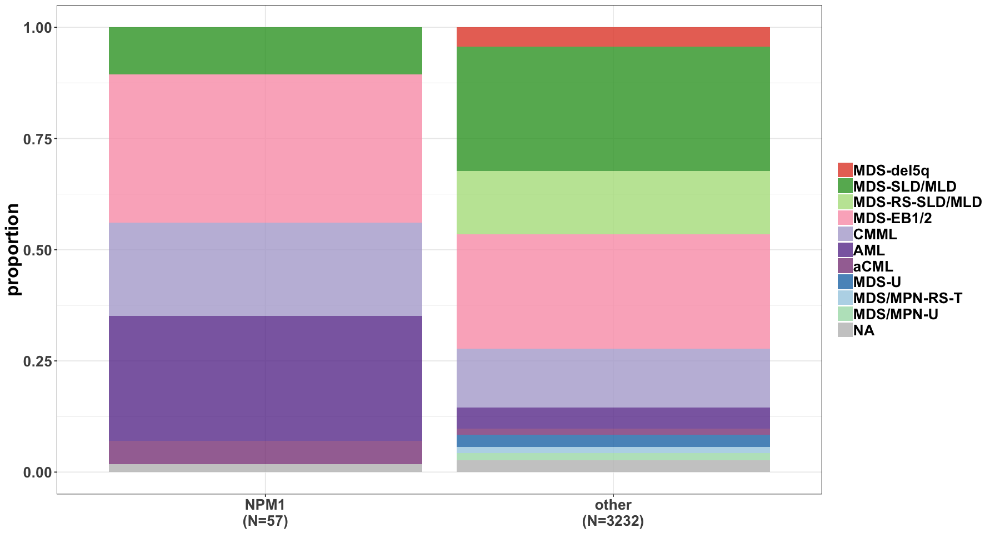

In [413]:
options(repr.plot.width=15, repr.plot.height=8)
data = ddall
data$category = "other"
data$category[data$NPM1==1] = "NPM1"
data$WHO_2016_SIMPLIFY_2[which(data$WHO_2016_SIMPLIFY_2=="other")]=NA
data$WHO_2016_SIMPLIFY_2[data$BM_BLAST>20]="AML" # one guy to correct
data$mywho = data$WHO_2016_SIMPLIFY_2
data$mywho = factor(data$mywho, levels=c("MDS-del5q","MDS-SLD/MLD","MDS-RS-SLD/MLD","MDS-EB1/2","CMML","AML","aCML","MDS-U","MDS/MPN-RS-T","MDS/MPN-U"))
data$label = paste0(data$category,"\n","(N=",table(data$category)[as.vector(data$category)],")")
ggplot(data) + geom_bar(aes(x=label,fill=mywho),position="fill",alpha=.8) + theme1 + noxtitle + ylab("proportion") + scale_fill_manual(values=col.who,na.value="grey") + nolegtitle

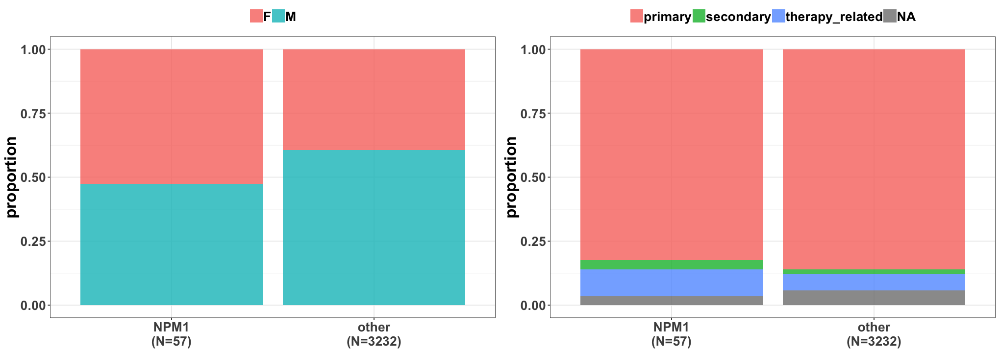

In [414]:
options(repr.plot.width=17, repr.plot.height=6)
gsex = ggplot(data) + geom_bar(aes(x=label,fill=SEX),position="fill",alpha=.8) + theme1 + topleg + noxtitle + ylab("proportion") + nolegtitle
gmds = ggplot(data) + geom_bar(aes(x=label,fill=MDS_TYPE),position="fill",alpha=.8) + theme1 + topleg + noxtitle + ylab("proportion") + nolegtitle
grid.arrange(gsex,gmds,ncol=2)

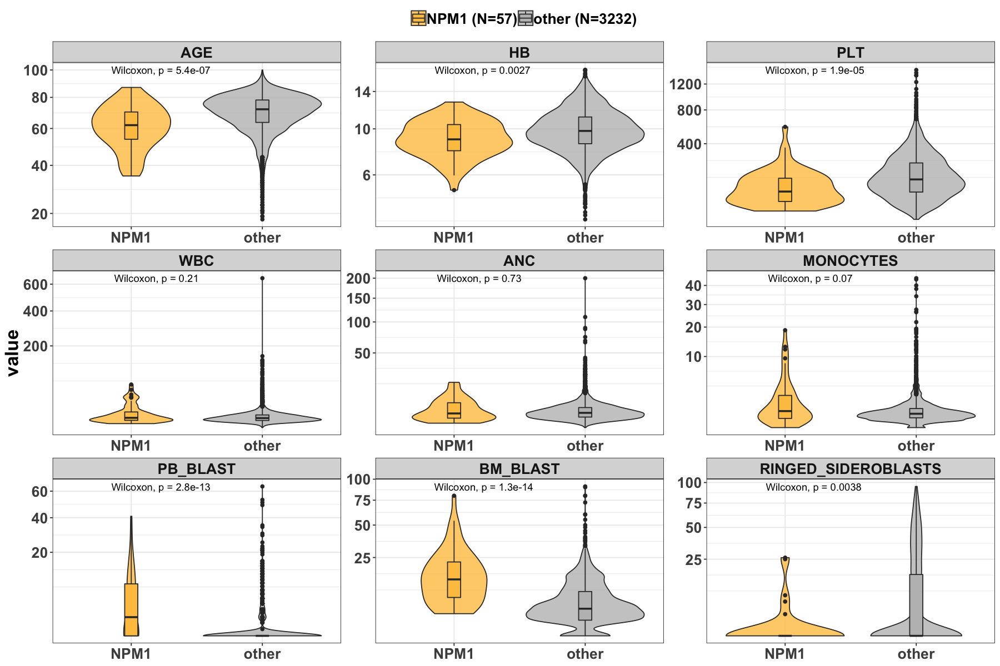

In [59]:
options(repr.plot.width=15, repr.plot.height=10)
data$AGE = data$AGE_AT_SAMPLE_TIME
myclinical = c("AGE","HB","PLT","WBC","ANC","MONOCYTES","PB_BLAST","BM_BLAST","RINGED_SIDEROBLASTS")
hh = melt(data[,c(myclinical,"LEUKID","category")], id.vars=c("LEUKID","category"))
hh$category = factor(hh$category, levels=c("NPM1","other"))
hh$label = paste0(hh$category," (N=",table(data$category)[as.vector(hh$category)],")")
ggplot(hh,aes(x=category,y=value,fill=label)) + geom_violin(alpha=0.8) + geom_boxplot(width=0.1) + facet_wrap(~variable,scales="free") + theme1 + topleg + scale_fill_manual(values=c(col.component[1],"grey")) + nolegtitle + noxtitle + stat_compare_means() + scale_y_sqrt()

**Clearly high blast**, but some cases are below 20% ie the AML cutoff.

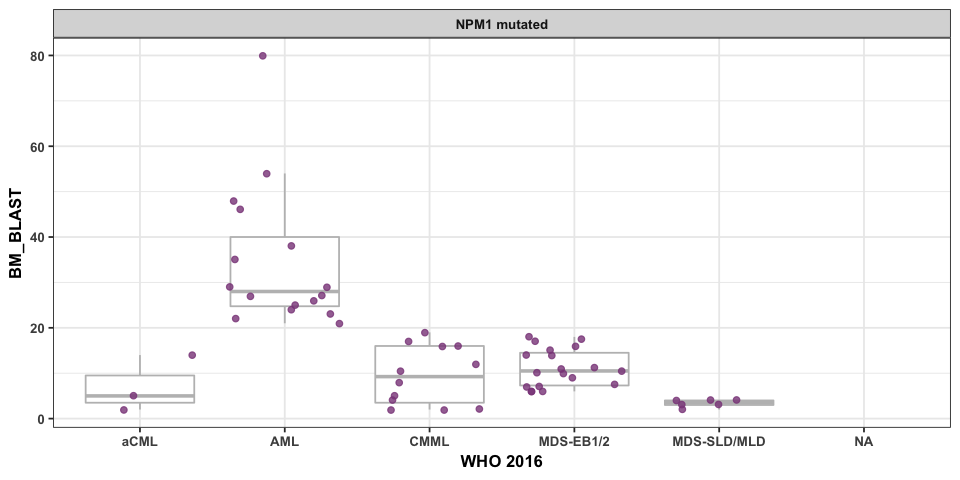

In [60]:
options(repr.plot.width=8, repr.plot.height=4)
ggplot(data[data$category=="NPM1",], aes(x=WHO_2016_SIMPLIFY_2,y=BM_BLAST)) + geom_boxplot(col="grey",outlier.shape=NA) + theme0 + facet_grid(.~"NPM1 mutated") + xlab("WHO 2016") + geom_jitter(alpha=0.8,col="orchid4")

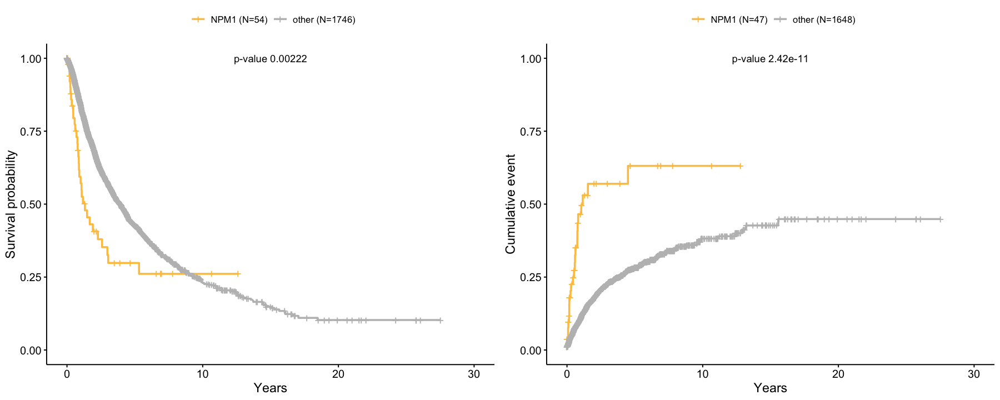

In [61]:
options(repr.plot.width=15, repr.plot.height=6)
# Overall Survival
ff = as.formula(paste("Surv(os_diag_years,os_status)~category"))
kmfit = survfit(ff,data=data)
kmfit$call$formula <- ff
myleg = paste0(gsub("category=","",names(kmfit$strata))," (N=",kmfit$strata,")")
ggs = ggsurvplot(kmfit, data = data, legend.title="",legend.labs=myleg,conf.int=F)$plot + scale_color_manual(values=c(col.component[1],"grey")) + xlab("Years")
pt = pairwise_survdiff(formula=ff, data=data, p.adjust.method = "BH")
ggOS = ggs + annotate("text",label=paste0("p-value ",signif(pt$p.value[1,1],3)),x=15,y=1)
# AML incidence
ff = as.formula(paste("Surv(aml_diag_years,aml_status)~category"))
kmfit = survfit(ff,data=data)
kmfit$call$formula <- ff
myleg = paste0(gsub("category=","",names(kmfit$strata))," (N=",kmfit$strata,")")
ggs = ggsurvplot(kmfit, data = data, legend.title="",legend.labs=myleg,conf.int=F,fun="event")$plot + scale_color_manual(values=c(col.component[1],"grey")) + xlab("Years")
pt = pairwise_survdiff(formula=ff, data=data, p.adjust.method = "BH")
ggAML = ggs + annotate("text",label=paste0("p-value ",signif(pt$p.value[1,1],3)),x=15,y=1)
grid.arrange(ggOS,ggAML,ncol=2)

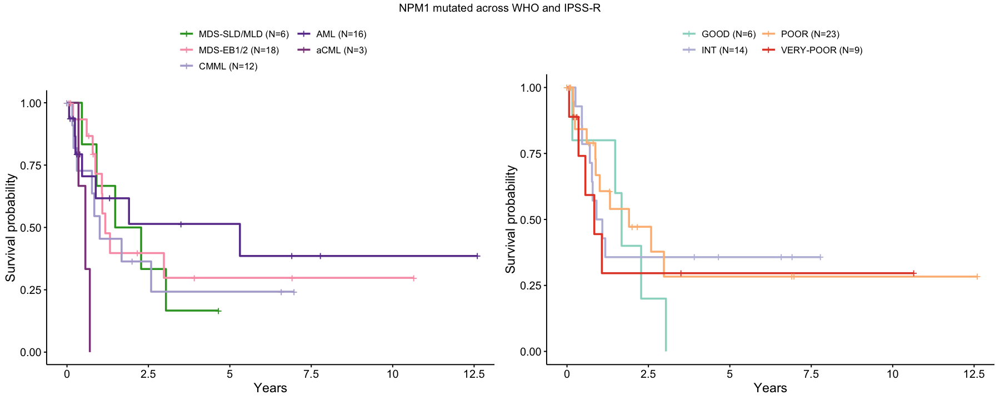

In [62]:
data$mywho = data$WHO_2016_SIMPLIFY_2
levels.who = c("MDS-del5q","MDS-SLD/MLD","MDS-RS-SLD/MLD","MDS-EB1/2","CMML","AML","aCML","MDS-U","MDS/MPN-RS-T","MDS/MPN-U")
data$mywho = factor(data$mywho, levels=levels.who)

kmfit = survfit(Surv(os_diag_years,os_status)~mywho,data=data[data$category=="NPM1",])
myleg = paste0(gsub("mywho=","",names(kmfit$strata))," (N=",kmfit$strata,")")
mycolwho = col.who[levels.who%in%gsub("mywho=","",names(kmfit$strata))]
ggwho = ggsurvplot(kmfit, data = data, legend.title="",legend.labs=myleg,conf.int=F)$plot + scale_color_manual(values=mycolwho) + xlab("Years") + guides(colour=guide_legend(ncol=2))

levels.ipssr = c("VERY-GOOD","GOOD","INT","POOR","VERY-POOR")
data$IPSSR_CALCULATED = factor(data$IPSSR_CALCULATED, levels=levels.ipssr)
kmfit = survfit(Surv(os_diag_years,os_status)~IPSSR_CALCULATED,data=data[data$category=="NPM1",])
myleg = paste0(gsub("IPSSR_CALCULATED=","",names(kmfit$strata))," (N=",kmfit$strata,")")
mycolipssr = col.ipssr[levels.ipssr%in%gsub("IPSSR_CALCULATED=","",names(kmfit$strata))]
ggipssr = ggsurvplot(kmfit, data = data, legend.title="",legend.labs=myleg,conf.int=F)$plot + scale_color_manual(values=mycolipssr) + xlab("Years") + guides(colour=guide_legend(ncol=2))
grid.arrange(ggwho,ggipssr,ncol=2,top="NPM1 mutated across WHO and IPSS-R")

Now we look at any difference between NPM1-AML and NPM1-other (any other WHO)

In [63]:
aa = ddall
aa$category = "other"
aa$category[aa$NPM1==1 & aa$WHO_2016_SIMPLIFY_2!="AML"] = "NPM1-other"
aa$category[aa$NPM1==1 & aa$WHO_2016_SIMPLIFY_2=="AML"] = "NPM1-AML"
table(aa$category)


  NPM1-AML NPM1-other      other 
        15         41       3233 

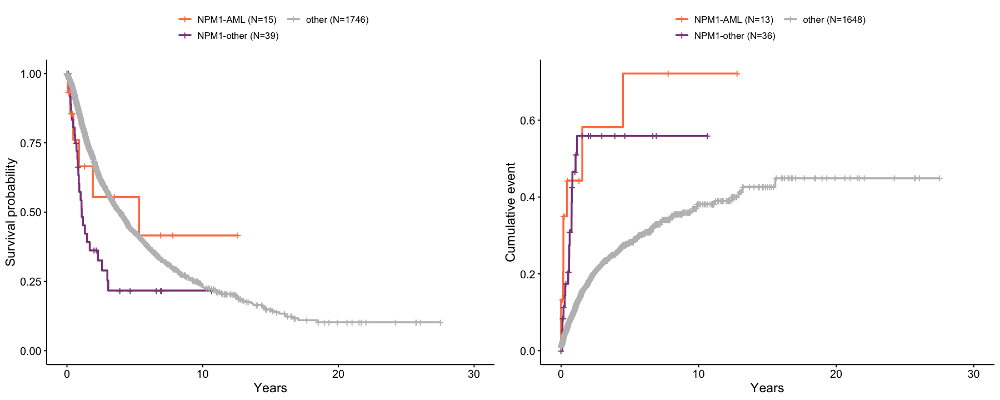

In [64]:
kmfit = survfit(Surv(os_diag_years,os_status)~category,aa)
myleg = paste0(gsub("category=","",names(kmfit$strata))," (N=",kmfit$strata,")")
ggOS = ggsurvplot(kmfit, data = data, legend.title="",legend.labs=myleg,conf.int=F)$plot + scale_color_manual(values=c("coral","orchid4","grey")) + xlab("Years") + guides(colour=guide_legend(ncol=2))
kmfit = survfit(Surv(aml_diag_years,aml_status)~category,aa)
myleg = paste0(gsub("category=","",names(kmfit$strata))," (N=",kmfit$strata,")")
ggAML = ggsurvplot(kmfit, data = data, legend.title="",legend.labs=myleg,conf.int=F,fun="event")$plot + scale_color_manual(values=c("coral","orchid4","grey")) + xlab("Years") + guides(colour=guide_legend(ncol=2))
grid.arrange(ggOS, ggAML, ncol=2)

In [65]:
table(aa$category)


  NPM1-AML NPM1-other      other 
        15         41       3233 

In [66]:
ddnpm1 = data.frame(NPM1_AML=rep(0,nrow(ddalt)),NPM1_other=rep(0,nrow(ddalt)))
ddnpm1$NPM1_AML[aa$category=="NPM1-AML"] = 1
ddnpm1$NPM1_other[aa$category=="NPM1-other"] = 1

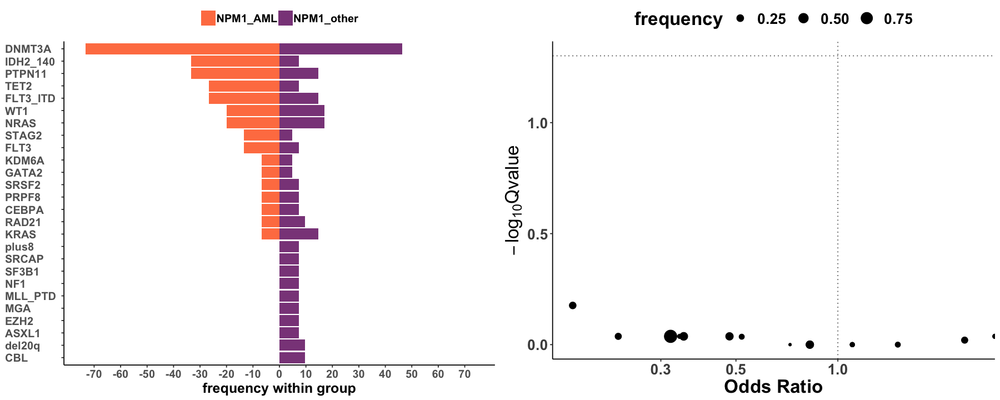

In [67]:
res.com = barplot_volcano_hotspot(dd_hotspot=ddnpm1,
                             ddalt=ddalt,
                             gene="NPM1",loose.cutoff=3,
                             col_for_groups = c("coral","orchid4"))
options(repr.plot.width=15, repr.plot.height=6)
grid.arrange(res.com$barplot, res.com$volcano, ncol=2)

In [68]:
bb = merge_clinical_mutation(dd_clinical=ddc, dd_maf=ddmaf, binary=FALSE, col_field="EVENT")$ddmut
bb = bb[,-grep("NPM1",colnames(bb))]
aa$number_comutations = apply(bb,1,sum)

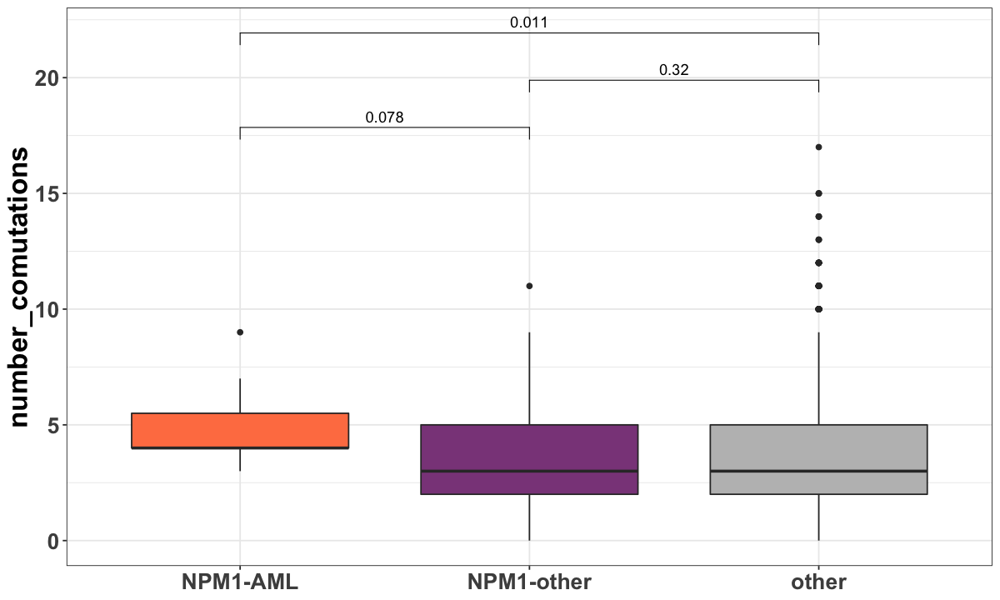

In [69]:
options(repr.plot.width=10, repr.plot.height=6)
ggplot(aa,aes(x=category,y=number_comutations,fill=category)) + geom_boxplot() + stat_compare_means(comparisons=list(c(1,2),c(2,3),c(1,3))) + theme1 + scale_fill_manual(values=c("coral","orchid4","grey")) + noleg + noxtitle

# MLL-PTD



In [422]:
aa =  ddall[ddall$MLL_PTD==1,]
paste("Number of MLL_PTD mutated is",nrow(aa))

[1] "Number of MLL_PTD mutated is 88"

In [424]:
table(aa$predicted_component)


 comp_2  comp_6  comp_8  comp_9 ncomp_0 ncomp_1 ncomp_2 ncomp_3 ncomp_4 ncomp_7 
      7       5      12       1       4       6      25       3       4      21 

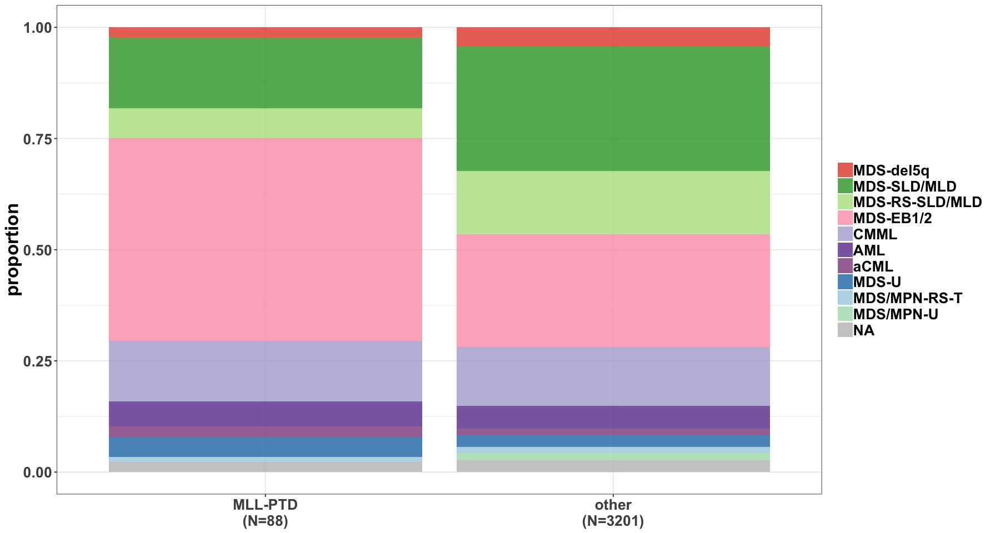

In [423]:
options(repr.plot.width=15, repr.plot.height=8)
data = ddall
data$category = "other"
data$category[data$MLL_PTD==1] = "MLL-PTD"
data$WHO_2016_SIMPLIFY_2[which(data$WHO_2016_SIMPLIFY_2=="other")]=NA
data$WHO_2016_SIMPLIFY_2[data$BM_BLAST>20]="AML" # one guy to correct
data$mywho = data$WHO_2016_SIMPLIFY_2
data$mywho = factor(data$mywho, levels=c("MDS-del5q","MDS-SLD/MLD","MDS-RS-SLD/MLD","MDS-EB1/2","CMML","AML","aCML","MDS-U","MDS/MPN-RS-T","MDS/MPN-U"))
data$label = paste0(data$category,"\n","(N=",table(data$category)[as.vector(data$category)],")")
ggplot(data) + geom_bar(aes(x=label,fill=mywho),position="fill",alpha=.8) + theme1 + noxtitle + ylab("proportion") + scale_fill_manual(values=col.who,na.value="grey") + nolegtitle

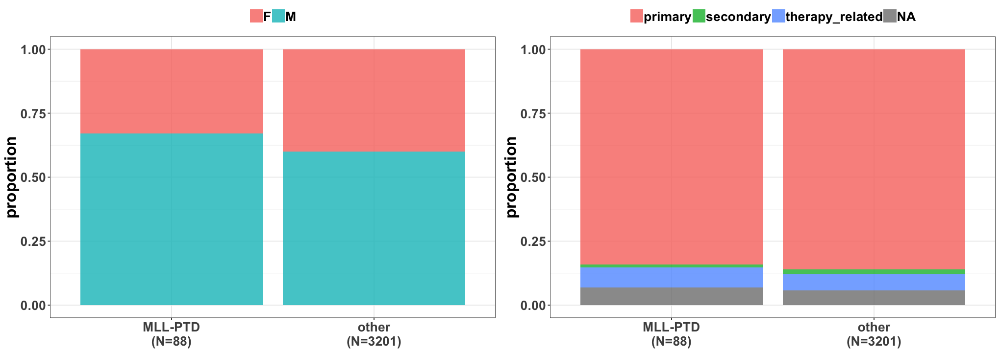

In [425]:
options(repr.plot.width=17, repr.plot.height=6)
gsex = ggplot(data) + geom_bar(aes(x=label,fill=SEX),position="fill",alpha=.8) + theme1 + topleg + noxtitle + ylab("proportion") + nolegtitle
gmds = ggplot(data) + geom_bar(aes(x=label,fill=MDS_TYPE),position="fill",alpha=.8) + theme1 + topleg + noxtitle + ylab("proportion") + nolegtitle
grid.arrange(gsex,gmds,ncol=2)

Warning message:
“Removed 3622 rows containing non-finite values (stat_ydensity).”Warning message:
“Removed 3622 rows containing non-finite values (stat_boxplot).”Warning message:
“Removed 3622 rows containing non-finite values (stat_compare_means).”

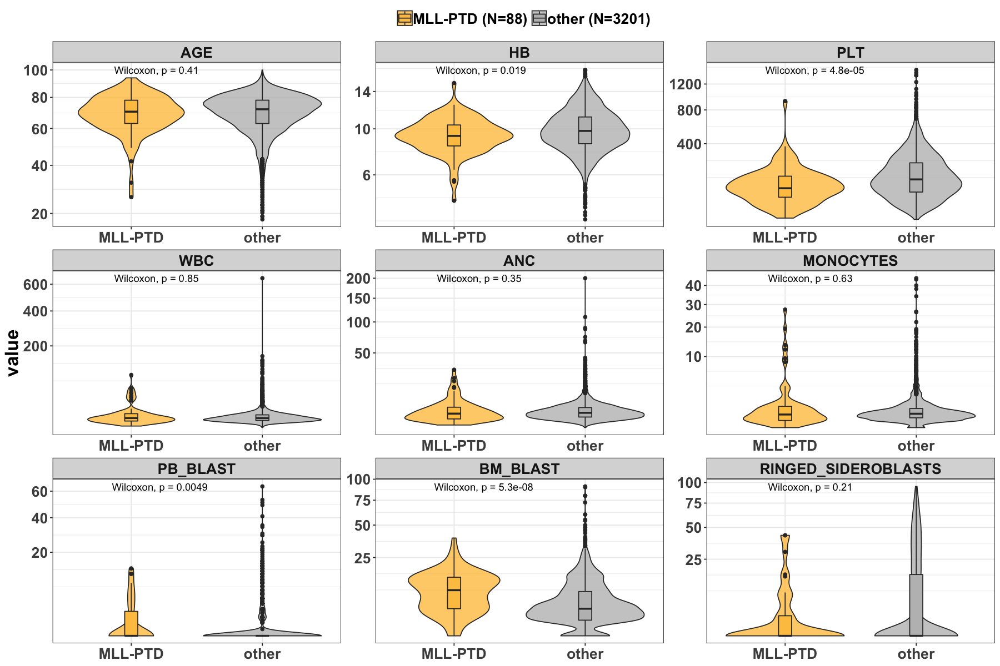

In [428]:
options(repr.plot.width=15, repr.plot.height=10)
data$AGE = data$AGE_AT_SAMPLE_TIME
myclinical = c("AGE","HB","PLT","WBC","ANC","MONOCYTES","PB_BLAST","BM_BLAST","RINGED_SIDEROBLASTS")
hh = melt(data[,c(myclinical,"LEUKID","category")], id.vars=c("LEUKID","category"))
hh$category = factor(hh$category, levels=c("MLL-PTD","other"))
hh$label = paste0(hh$category," (N=",table(data$category)[as.vector(hh$category)],")")
ggplot(hh,aes(x=category,y=value,fill=label)) + geom_violin(alpha=0.8) + geom_boxplot(width=0.1) + facet_wrap(~variable,scales="free") + theme1 + topleg + scale_fill_manual(values=c(col.component[1],"grey")) + nolegtitle + noxtitle + stat_compare_means() + scale_y_sqrt()

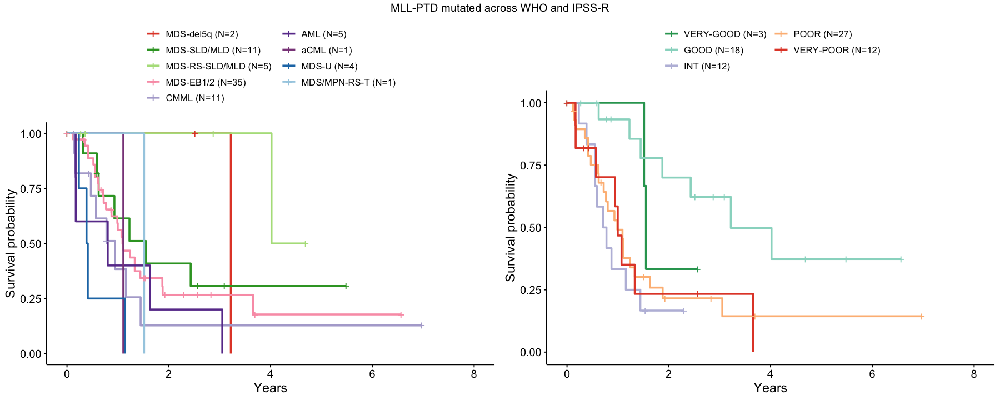

In [432]:
#options(repr.plot.width=8, repr.plot.height=4)
options(repr.plot.width=15, repr.plot.height=6)

data$mywho = data$WHO_2016_SIMPLIFY_2
levels.who = c("MDS-del5q","MDS-SLD/MLD","MDS-RS-SLD/MLD","MDS-EB1/2","CMML","AML","aCML","MDS-U","MDS/MPN-RS-T","MDS/MPN-U")
data$mywho = factor(data$mywho, levels=levels.who)

kmfit = survfit(Surv(os_diag_years,os_status)~mywho,data=data[data$category=="MLL-PTD",])
myleg = paste0(gsub("mywho=","",names(kmfit$strata))," (N=",kmfit$strata,")")
mycolwho = col.who[levels.who%in%gsub("mywho=","",names(kmfit$strata))]
ggwho = ggsurvplot(kmfit, data = data, legend.title="",legend.labs=myleg,conf.int=F)$plot + scale_color_manual(values=mycolwho) + xlab("Years") + guides(colour=guide_legend(ncol=2))

levels.ipssr = c("VERY-GOOD","GOOD","INT","POOR","VERY-POOR")
data$IPSSR_CALCULATED = factor(data$IPSSR_CALCULATED, levels=levels.ipssr)
kmfit = survfit(Surv(os_diag_years,os_status)~IPSSR_CALCULATED,data=data[data$category=="MLL-PTD",])
myleg = paste0(gsub("IPSSR_CALCULATED=","",names(kmfit$strata))," (N=",kmfit$strata,")")
mycolipssr = col.ipssr[levels.ipssr%in%gsub("IPSSR_CALCULATED=","",names(kmfit$strata))]
ggipssr = ggsurvplot(kmfit, data = data, legend.title="",legend.labs=myleg,conf.int=F)$plot + scale_color_manual(values=mycolipssr) + xlab("Years") + guides(colour=guide_legend(ncol=2))
grid.arrange(ggwho,ggipssr,ncol=2,top="MLL-PTD mutated across WHO and IPSS-R")

In [435]:
table(aa$WHO_2016_SIMPLIFY_2)


          aCML            AML           CMML      MDS-del5q      MDS-EB1/2 
             2              5             12              2             40 
MDS-RS-SLD/MLD    MDS-SLD/MLD          MDS-U   MDS/MPN-RS-T 
             6             14              4              1 

In [449]:
bb = aa[,colnames(ddhot)]
resbb = sort(apply(bb,2,sum),decreasing=T)
#resbb[1:15]

In [436]:
ddmll = data.frame(MLL_PTD=rep(0,nrow(ddalt)),NPM1_other=rep(0,nrow(ddalt)))
ddmll$NPM1_AML[aa$category=="NPM1-AML"] = 1
ddmll$NPM1_other[aa$category=="NPM1-other"] = 1
res.com = barplot_volcano_hotspot(dd_hotspot=ddnpm1,
                             ddalt=ddalt,
                             gene="NPM1",loose.cutoff=3,
                             col_for_groups = c("coral","orchid4"))
options(repr.plot.width=15, repr.plot.height=6)
grid.arrange(res.com$barplot, res.com$volcano, ncol=2)

ERROR: Error in eval(expr, envir, enclos): object 'ddmut' not found


# Component 6

In [70]:
paste("count is ",sum(ddall$predicted_component=="comp_6"))
paste("freq is ",round(100*sum(ddall$predicted_component=="comp_6")/nrow(ddall),2),"%")

[1] "count is  284"

[1] "freq is  8.63 %"

In [71]:
res = ComponentEventFreq(data=ddall, mycomponent="comp_6", molecular.features=molecular.features, mycol=col.component[6], mycut=6)

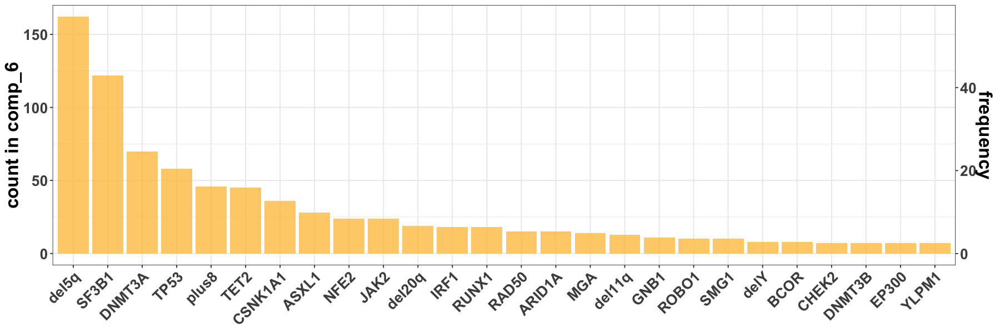

In [72]:
options(repr.plot.width=15, repr.plot.height=5)
res$gbar

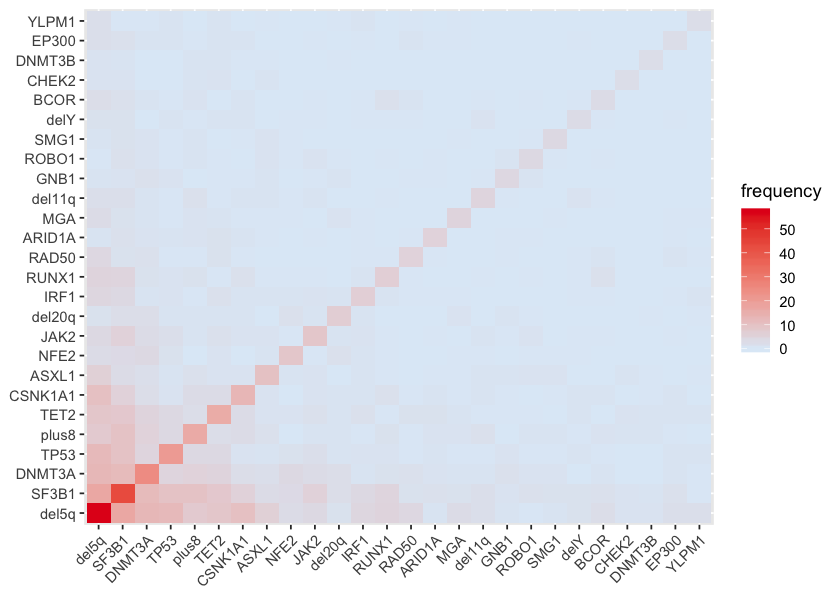

In [73]:
options(repr.plot.width=7, repr.plot.height=5)
res$gfreq

In [74]:
aa = ddall[ddall$predicted_component=="comp_6",]
table(aa$lenalidomid,exclude=F)


  0   1 
237  47 

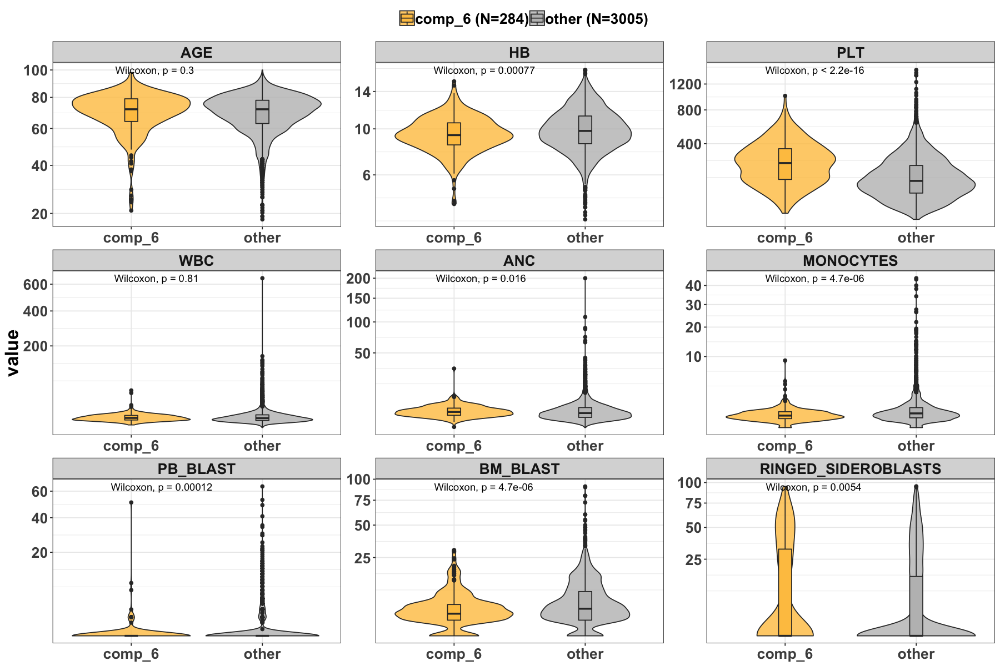

In [75]:
options(warn=-1)
options(repr.plot.width=15, repr.plot.height=10)
ComponentContinuousClinical(data=ddall, mycomponent="comp_6", mycol=col.component[6])

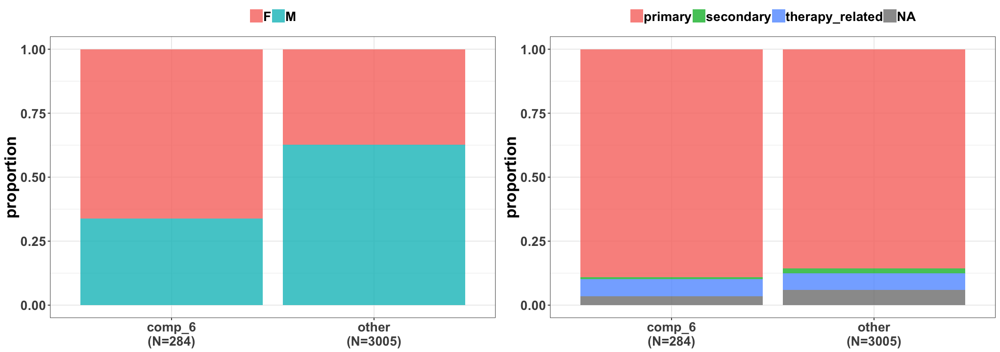

In [76]:
options(repr.plot.width=17, repr.plot.height=6)
gsex = ComponentDiscreteClinical(data=ddall, mycomponent="comp_6", mydiscrete="SEX") 
gmds = ComponentDiscreteClinical(data=ddall, mycomponent="comp_6", mydiscrete="MDS_TYPE")
grid.arrange(gsex,gmds,ncol=2)

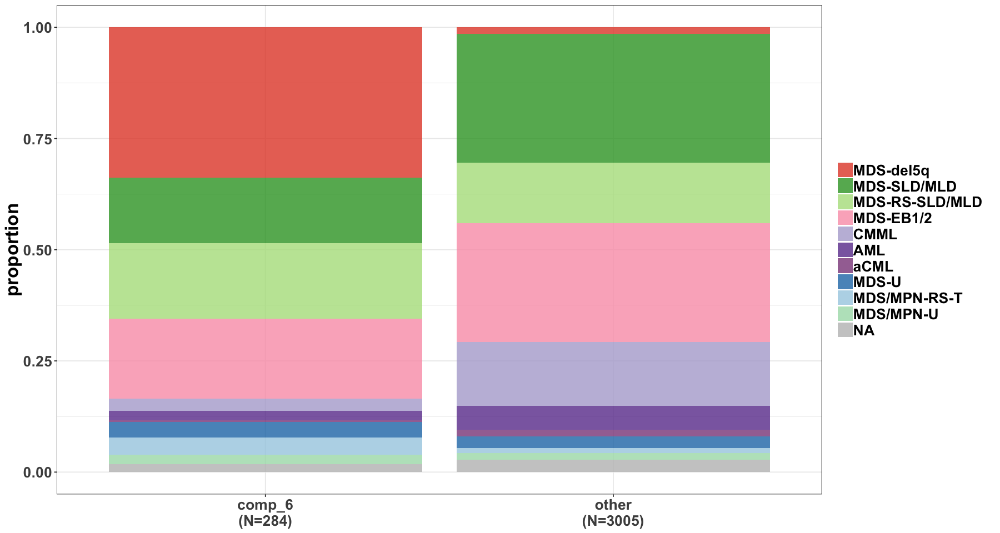

In [77]:
options(repr.plot.width=15, repr.plot.height=8)
ComponentWHO(data=ddall, mycomponent="comp_6")

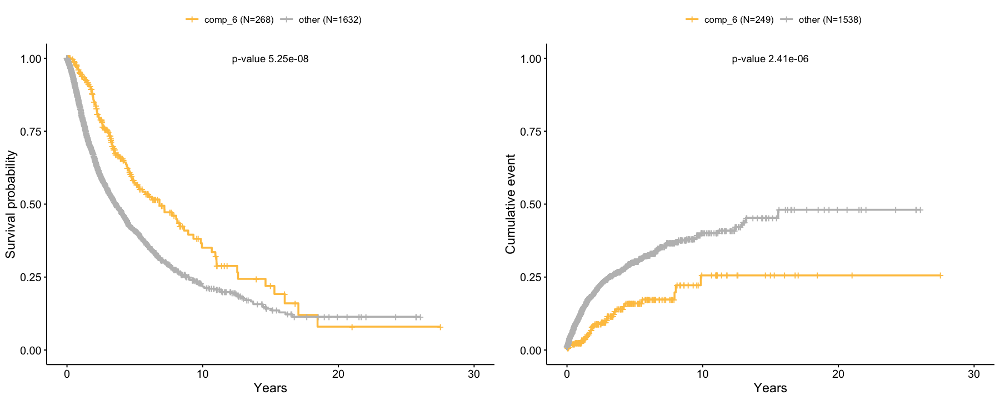

In [78]:
options(repr.plot.width=15, repr.plot.height=6)
res = ComponentOutcome(data=ddall, mycomponent="comp_6", mycol=col.component[6])
grid.arrange(res$ggOS,res$ggAML,ncol=2)

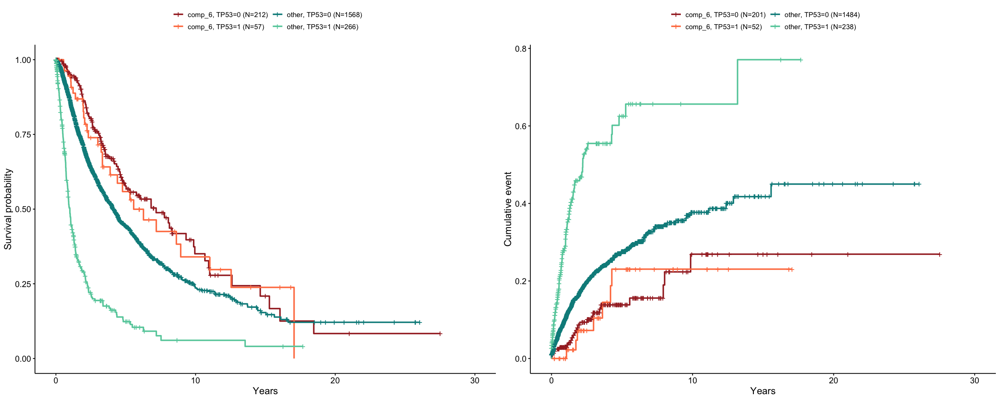

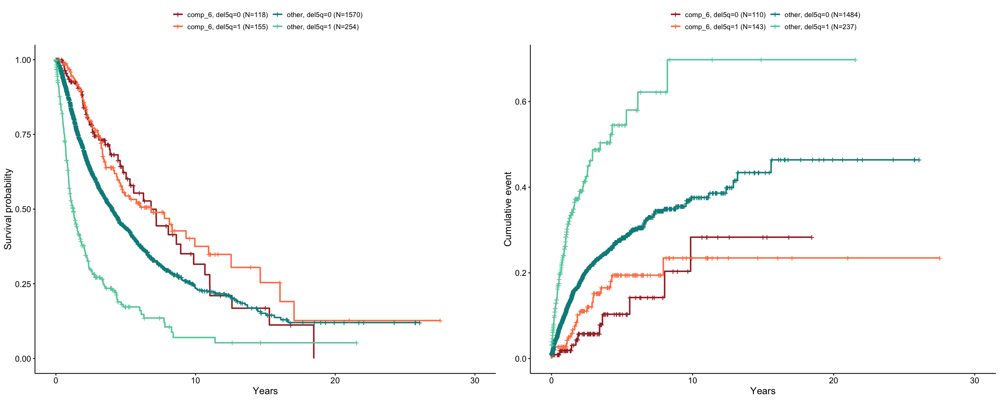

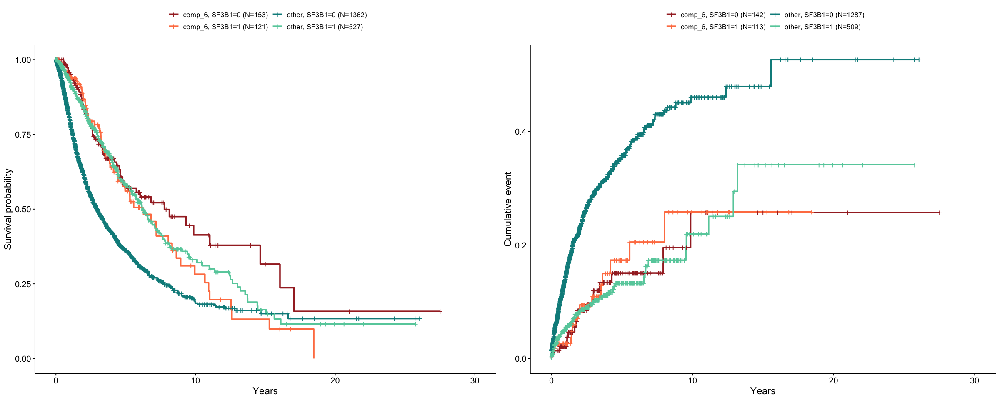

In [321]:
res = MiscComponentOutcome(data=ddall, mycomponent="comp_6", covariate="TP53")
grid.arrange(res$ggOS,res$ggAML,ncol=2)
res = MiscComponentOutcome(data=ddall, mycomponent="comp_6", covariate="del5q")
grid.arrange(res$ggOS,res$ggAML,ncol=2)
res = MiscComponentOutcome(data=ddall, mycomponent="comp_6", covariate="SF3B1")
grid.arrange(res$ggOS,res$ggAML,ncol=2)

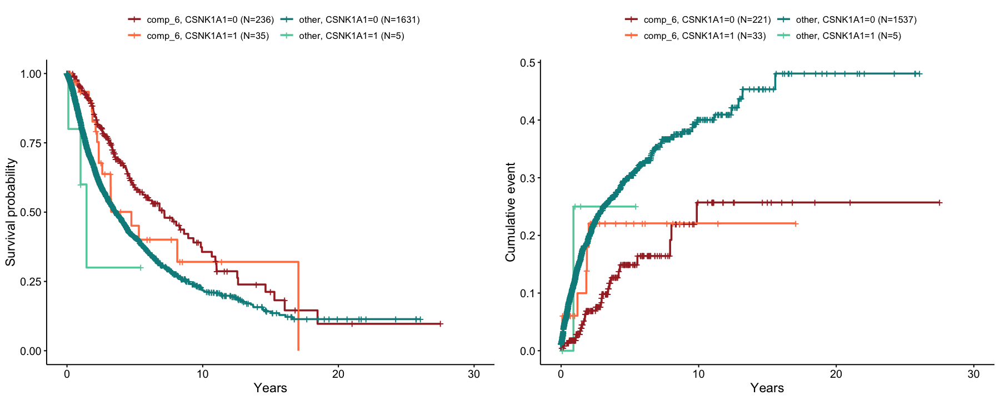

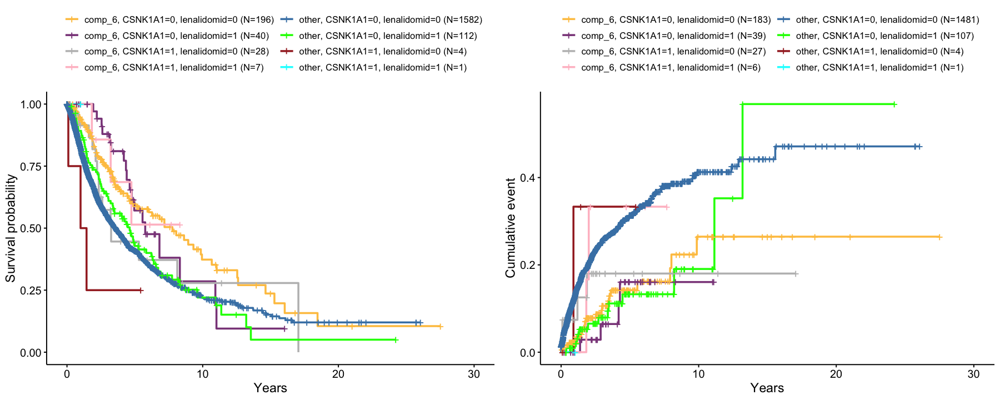

In [80]:
#res = MiscTwoComponent6Outcome(data=ddall, mycomponent="comp_6", mycol=col.component[6])
res = MiscComponentOutcome(data=ddall, mycomponent="comp_6", covariate="CSNK1A1")
grid.arrange(res$ggOS,res$ggAML,ncol=2)
res = MiscLenComponent6Outcome(data=ddall, mycomponent="comp_6", mycol=col.component[6])
grid.arrange(res$ggOS,res$ggAML,ncol=2)

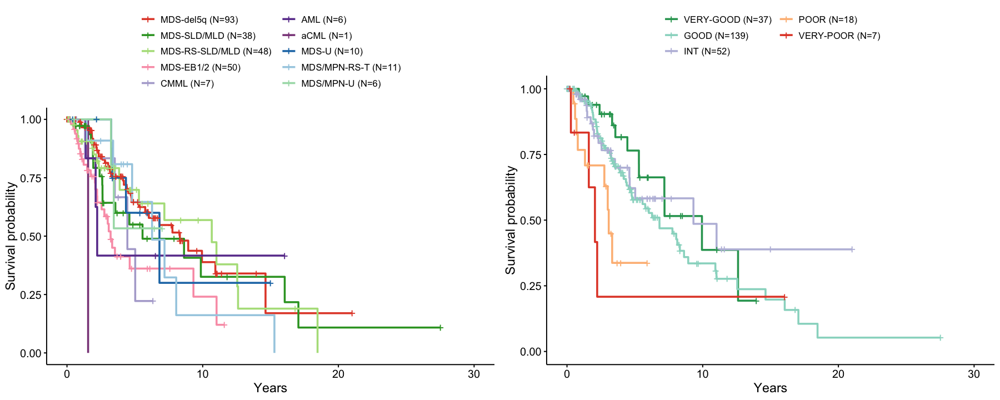

In [81]:
res = ComponentOutcomeStratified(data=ddall,mycomponent="comp_6") 
grid.arrange(res$ggwho,res$ggipssr,ncol=2)

## Conclusion

Component 6 is

- del5q with also SF3B1 | TP53 as well as CSNK1A1

- enriched in WHO MDS-del5q

- enriched in Female

- overall low Blast and good outcome

- **importantly**, the good outcome is preserved when TP53 present.

- here the IPSSR-INT segregates with the good.

NB: **TP53 status:**

In [82]:
j = which(ddall$predicted_component=="comp_6" & ddall$TP53==1)
table(ddtp53[j,"TP53_monoallelic"])
table(ddtp53[j,"TP53_biallelic"])


 0  1 
 8 50 


 0  1 
50  8 

TODO stratified from comp_6 by TP53 and status to see those 8 guys.

# Component 2

In [83]:
paste("count is ",sum(ddall$predicted_component=="comp_2"))
paste("freq is ",round(100*sum(ddall$predicted_component=="comp_2")/nrow(ddall),2),"%")

[1] "count is  363"

[1] "freq is  11.04 %"

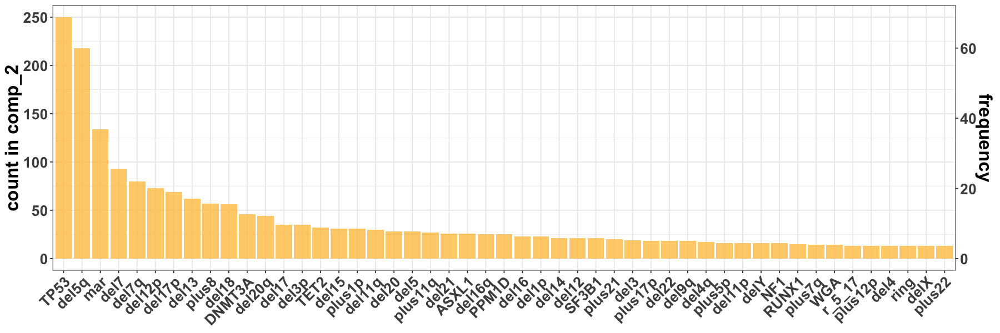

In [84]:
res = ComponentEventFreq(data=ddall, mycomponent="comp_2", molecular.features=molecular.features, mycol=col.component[2], mycut=12)

options(repr.plot.width=15, repr.plot.height=5)
res$gbar

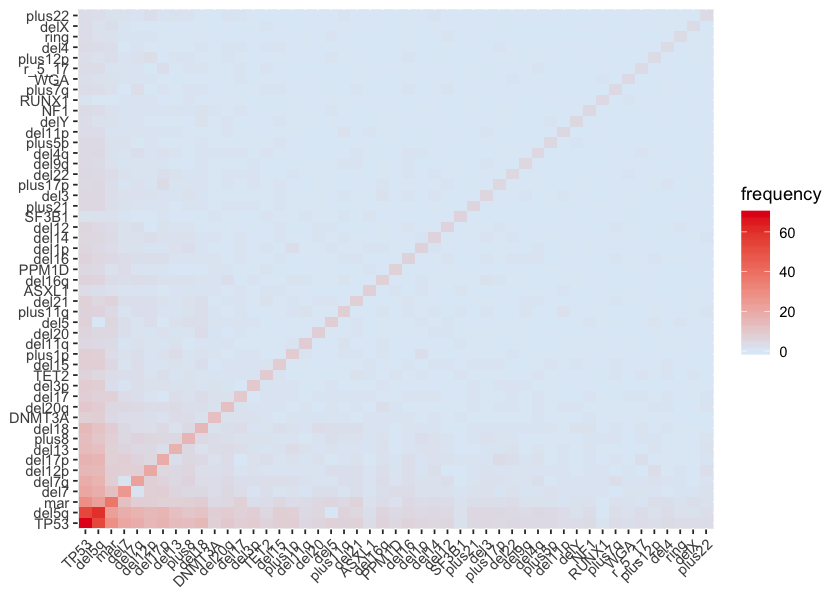

In [85]:
options(repr.plot.width=7, repr.plot.height=5)
res$gfreq

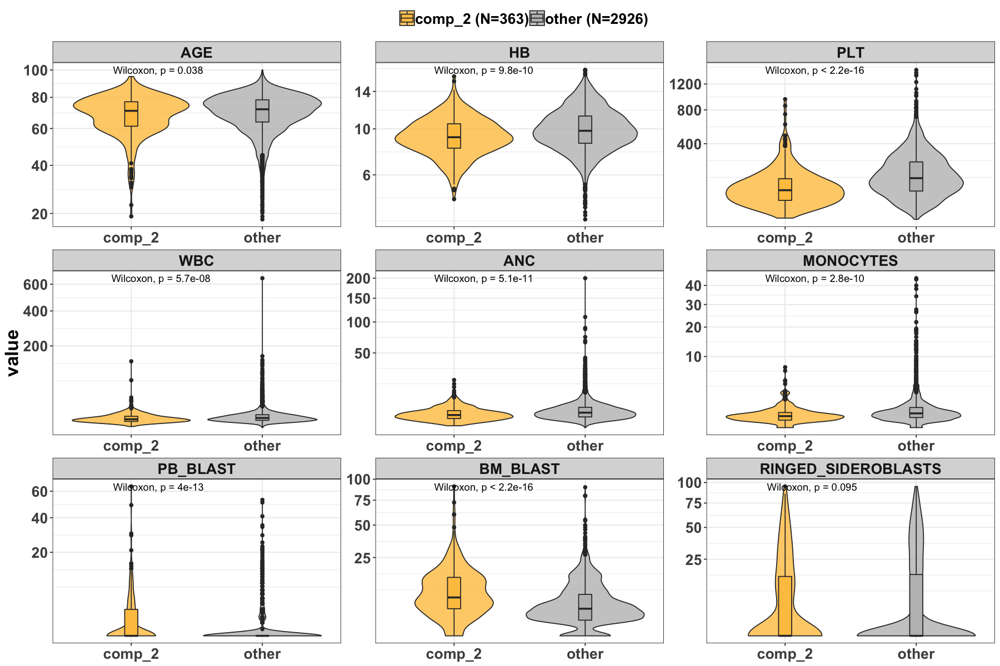

In [86]:
options(warn=-1)
options(repr.plot.width=15, repr.plot.height=10)
ComponentContinuousClinical(data=ddall, mycomponent="comp_2", mycol=col.component[2])

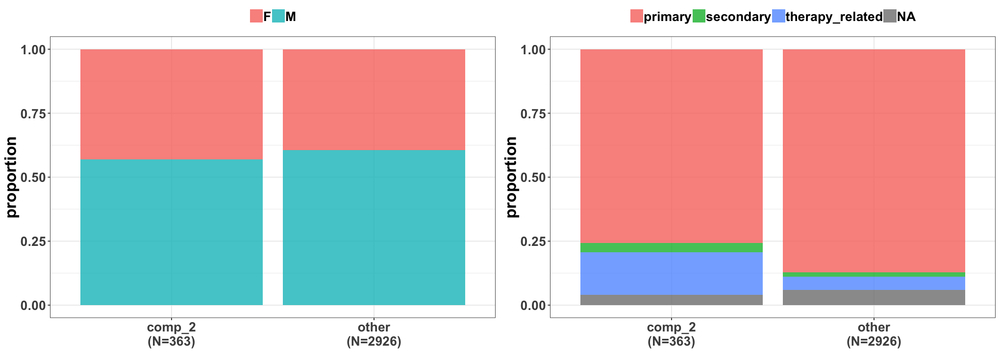

In [87]:
options(repr.plot.width=17, repr.plot.height=6)
gsex = ComponentDiscreteClinical(data=ddall, mycomponent="comp_2", mydiscrete="SEX") 
gmds = ComponentDiscreteClinical(data=ddall, mycomponent="comp_2", mydiscrete="MDS_TYPE")
grid.arrange(gsex,gmds,ncol=2)

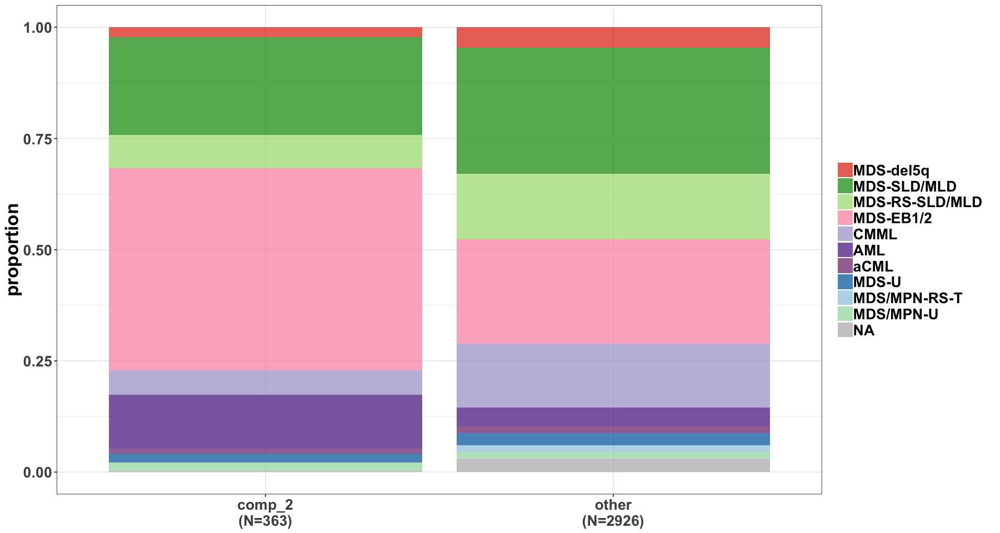

In [88]:
options(repr.plot.width=15, repr.plot.height=8)
ComponentWHO(data=ddall, mycomponent="comp_2")

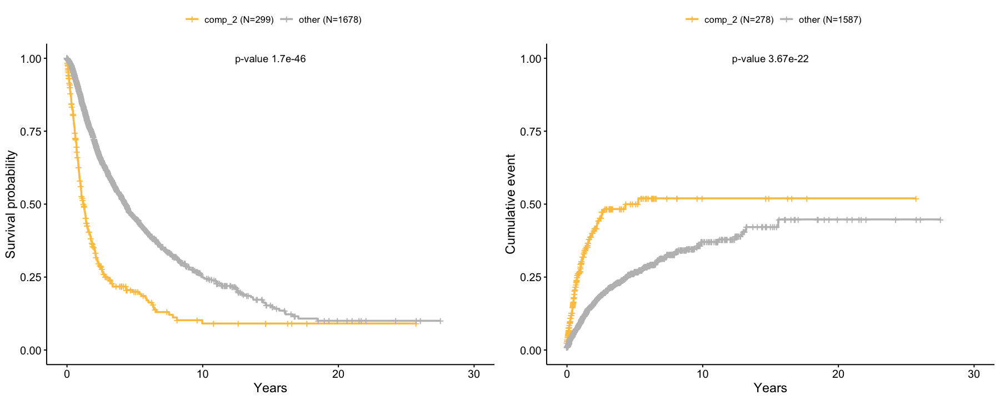

In [89]:
options(repr.plot.width=15, repr.plot.height=6)
res = ComponentOutcome(data=ddall, mycomponent="comp_2", mycol=col.component[2])
grid.arrange(res$ggOS,res$ggAML,ncol=2)

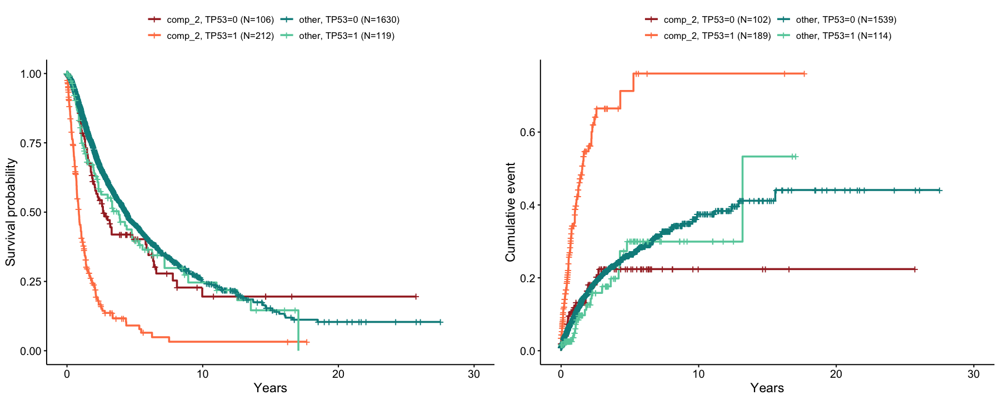

In [90]:
res = MiscComponentOutcome(data=ddall, mycomponent="comp_2", covariate="TP53")
grid.arrange(res$ggOS,res$ggAML,ncol=2)

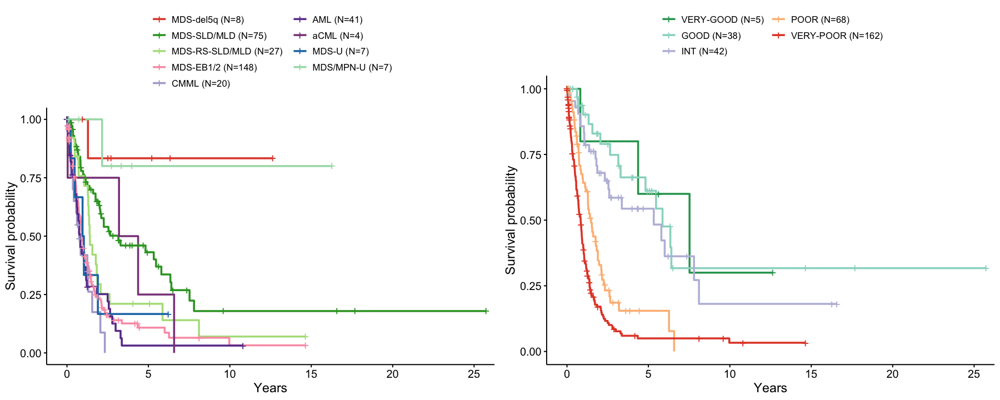

In [91]:
res = ComponentOutcomeStratified(data=ddall,mycomponent="comp_2") 
grid.arrange(res$ggwho,res$ggipssr,ncol=2)

## Conclusion

Component 2 is driven by TP53.

- TP53 | complex. PPM1D also.

- enriched in therapy-related.

- the MDS EB1/2 segregates with the AML.

NB: TP53 status

In [92]:
j = which(ddall$predicted_component=="comp_2" & ddall$TP53==1)
table(ddtp53[j,"TP53_monoallelic"])
table(ddtp53[j,"TP53_biallelic"])


  0   1 
214  36 


  0   1 
 36 214 

TODO stratified with TP53 status as well here. And by CK.

In [93]:
table(ddall[ddall$predicted_component=="comp_2","MDS_TYPE"])
summary(apply(ddall[ddall$predicted_component=="comp_2",cyto.features],1,sum))


        primary       secondary therapy_related 
            275              13              60 

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
  0.000   3.000   5.000   5.625   8.000  16.000 

# nComponent 1

In [94]:
paste("count is ",sum(ddall$predicted_component=="ncomp_1"))
paste("freq is ",round(100*sum(ddall$predicted_component=="ncomp_1")/nrow(ddall),2),"%")

[1] "count is  720"

[1] "freq is  21.89 %"

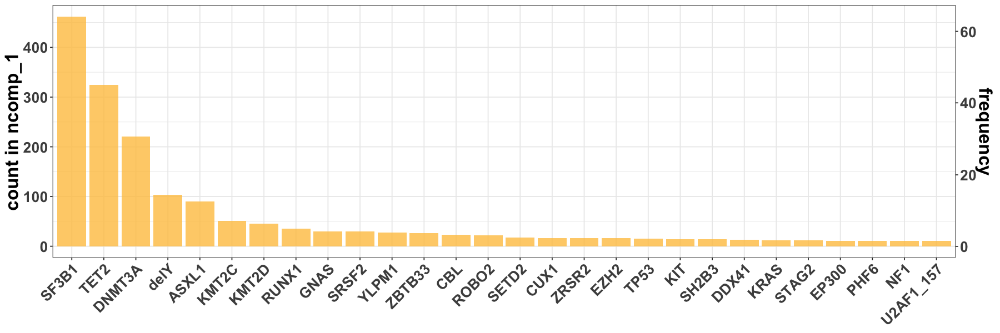

In [95]:
res = ComponentEventFreq(data=ddall, mycomponent="ncomp_1", molecular.features=molecular.features, mycol=col.component[10], mycut=10)
options(repr.plot.width=15, repr.plot.height=5)
res$gbar

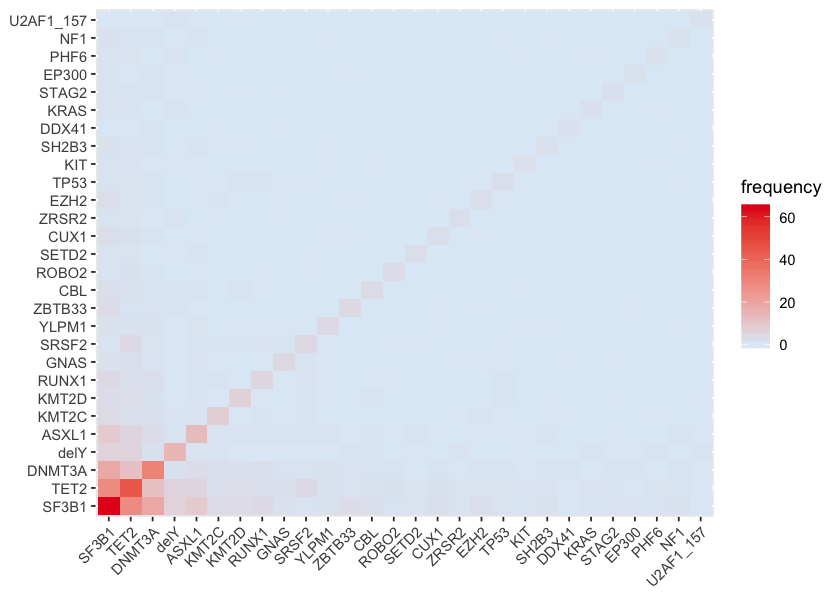

In [96]:
options(repr.plot.width=7, repr.plot.height=5)
res$gfreq

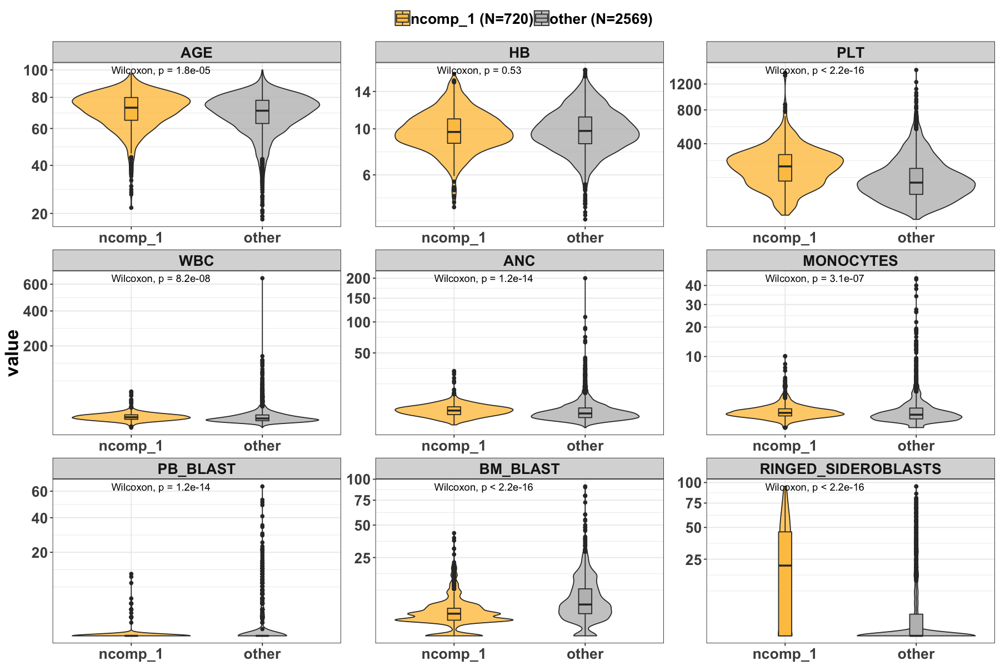

In [97]:
options(warn=-1)
options(repr.plot.width=15, repr.plot.height=10)
ComponentContinuousClinical(data=ddall, mycomponent="ncomp_1", mycol=col.component[4])

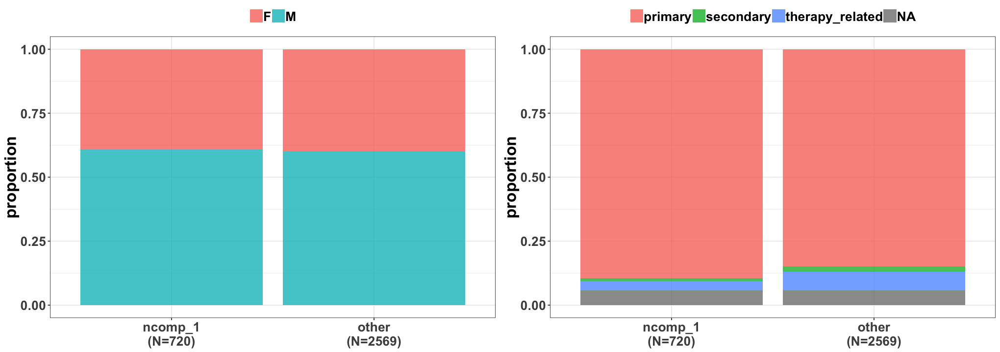

In [98]:
options(repr.plot.width=17, repr.plot.height=6)
gsex = ComponentDiscreteClinical(data=ddall, mycomponent="ncomp_1", mydiscrete="SEX") 
gmds = ComponentDiscreteClinical(data=ddall, mycomponent="ncomp_1", mydiscrete="MDS_TYPE")
grid.arrange(gsex,gmds,ncol=2)

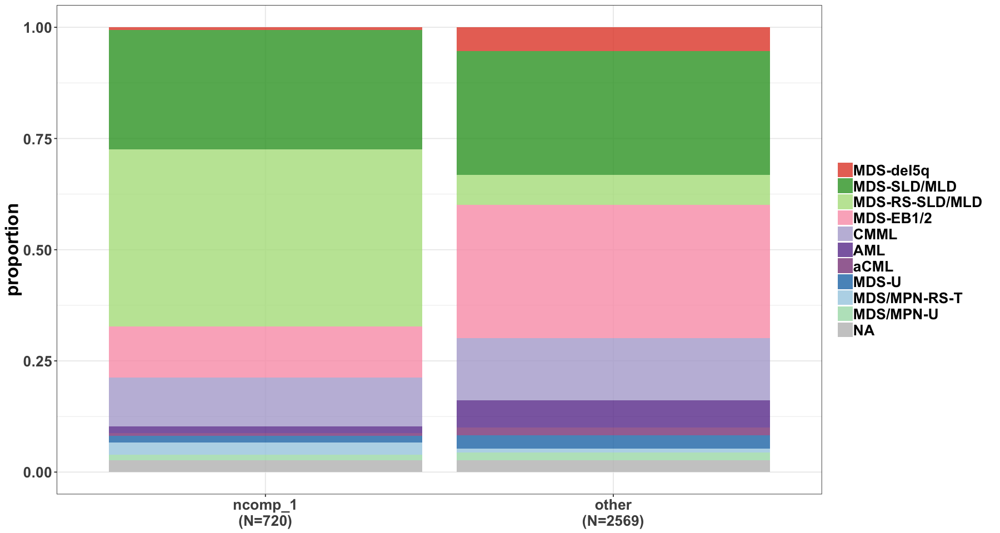

In [99]:
options(repr.plot.width=15, repr.plot.height=8)
ComponentWHO(data=ddall, mycomponent="ncomp_1")

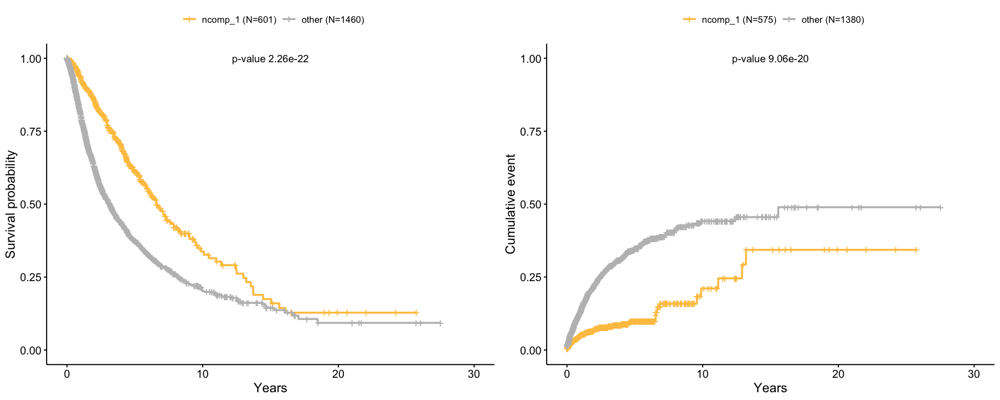

In [100]:
options(repr.plot.width=15, repr.plot.height=6)
res = ComponentOutcome(data=ddall, mycomponent="ncomp_1", mycol=col.component[4])
grid.arrange(res$ggOS,res$ggAML,ncol=2)

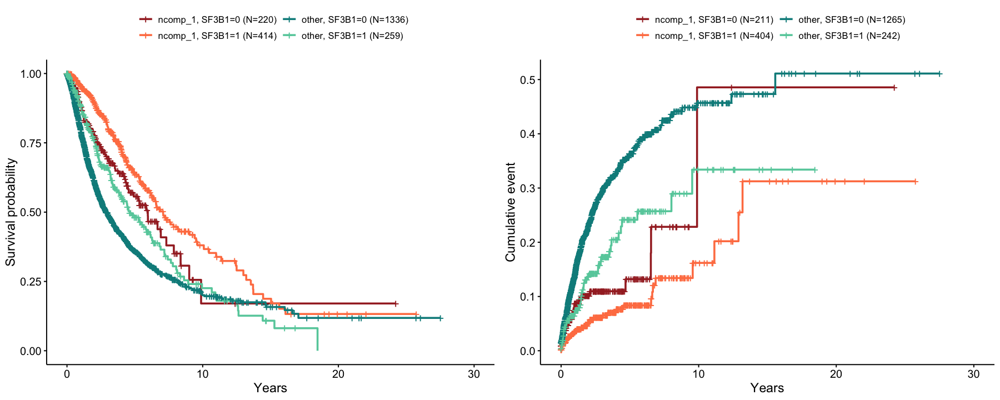

In [101]:
res = MiscComponentOutcome(data=ddall, mycomponent="ncomp_1", covariate="SF3B1")
grid.arrange(res$ggOS,res$ggAML,ncol=2)

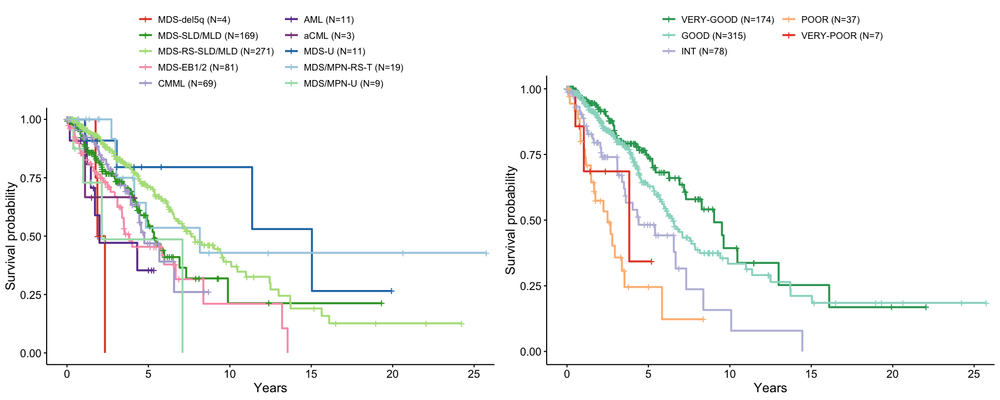

In [102]:
res = ComponentOutcomeStratified(data=ddall,mycomponent="ncomp_1") 
grid.arrange(res$ggwho,res$ggipssr,ncol=2)

## Conlusion:

nComponent 1 is:

- a SF3B1 strong component

- enriched in MDS-RS-SLD/MLS of course

- high Plt, high WBC, low Blasts, high ringed sideroblasts

- Importantly, the patients from that class without SF3B1 retain good outcome

- **TODO, is there TET2 DNMT3A only in that class?**

# nComponent 6

In [103]:
paste("count is ",sum(ddall$predicted_component=="ncomp_6"))
paste("freq is ",round(100*sum(ddall$predicted_component=="ncomp_6")/nrow(ddall),2),"%")

[1] "count is  40"

[1] "freq is  1.22 %"

In [104]:
res = ComponentEventFreq(data=ddall, mycomponent="ncomp_6", molecular.features=molecular.features, mycol=col.component[3], mycut=1)

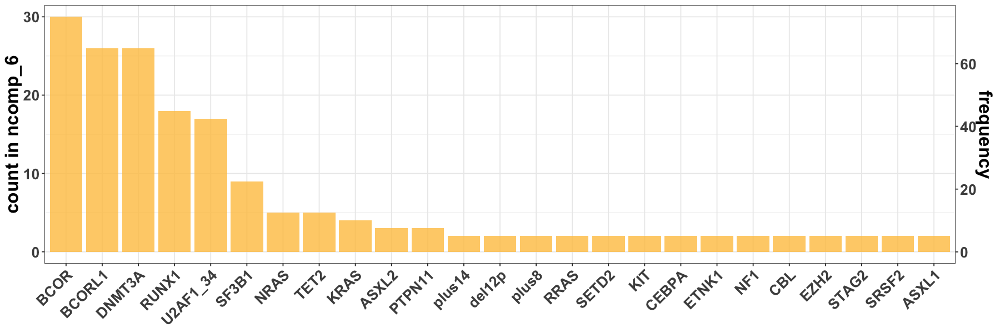

In [105]:
options(repr.plot.width=15, repr.plot.height=5)
res$gbar

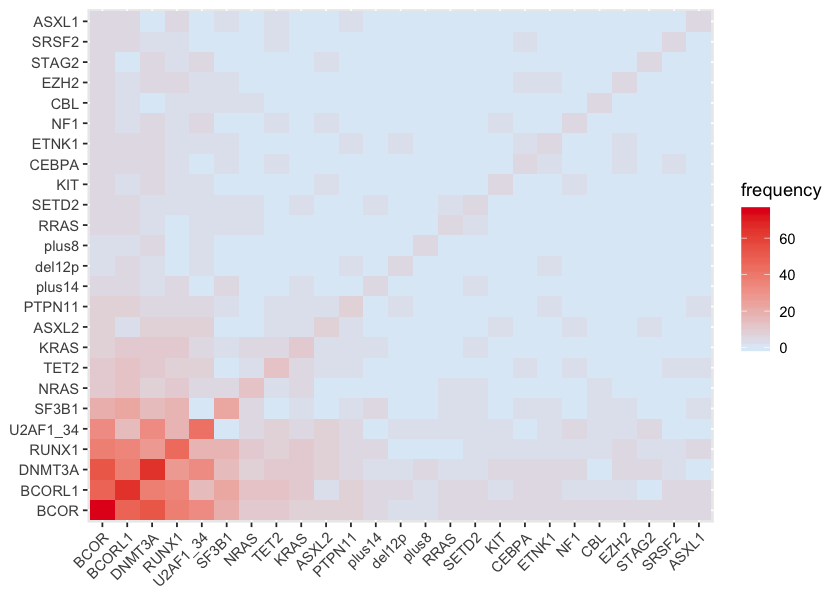

In [106]:
options(repr.plot.width=7, repr.plot.height=5)
res$gfreq

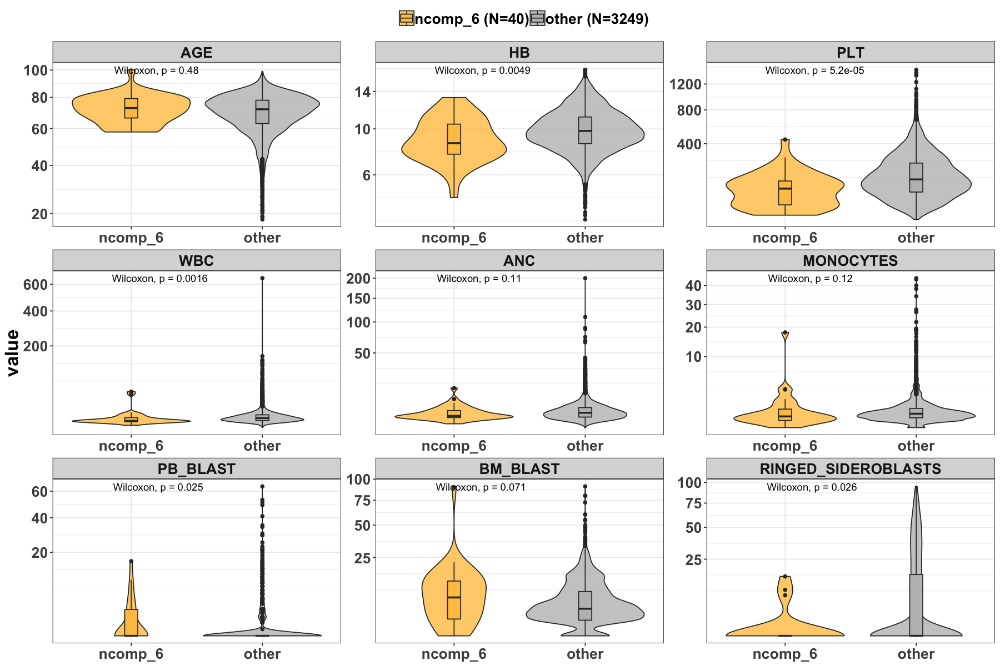

In [107]:
options(warn=-1)
options(repr.plot.width=15, repr.plot.height=10)
ComponentContinuousClinical(data=ddall, mycomponent="ncomp_6", mycol=col.component[3])

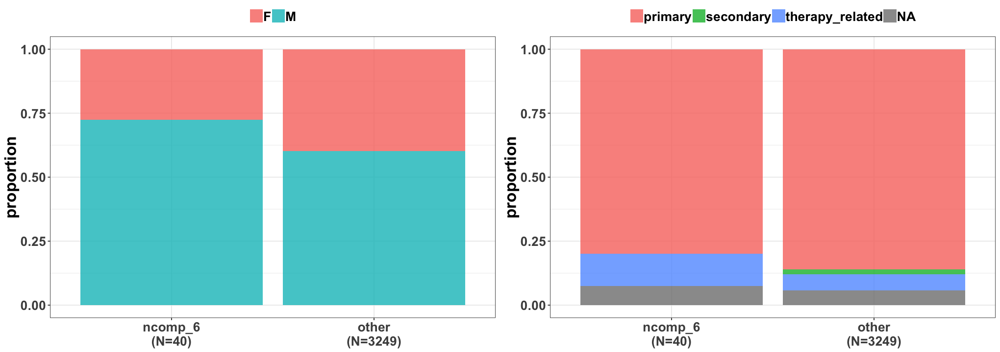

In [108]:
options(repr.plot.width=17, repr.plot.height=6)
gsex = ComponentDiscreteClinical(data=ddall, mycomponent="ncomp_6", mydiscrete="SEX") 
gmds = ComponentDiscreteClinical(data=ddall, mycomponent="ncomp_6", mydiscrete="MDS_TYPE")
grid.arrange(gsex,gmds,ncol=2)

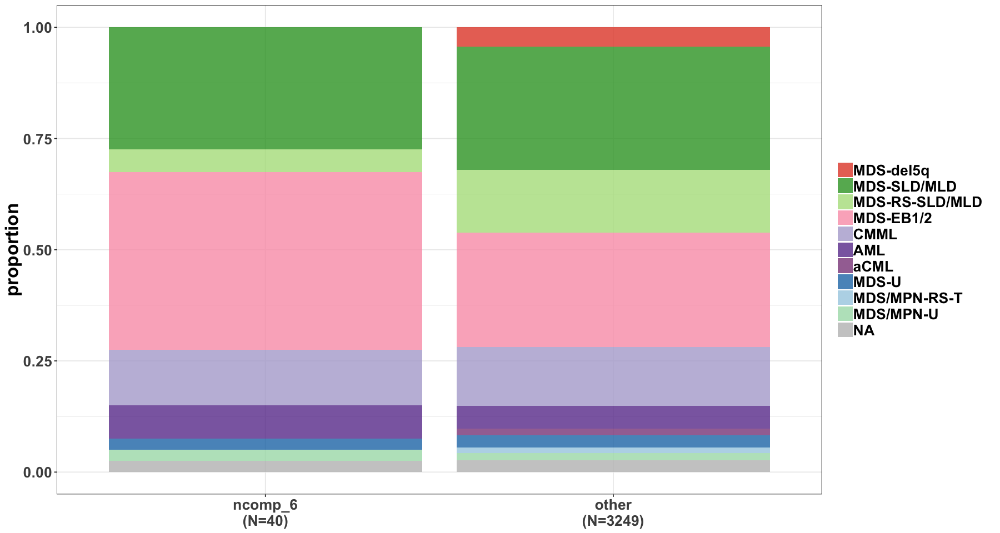

In [109]:
options(repr.plot.width=15, repr.plot.height=8)
ComponentWHO(data=ddall, mycomponent="ncomp_6")

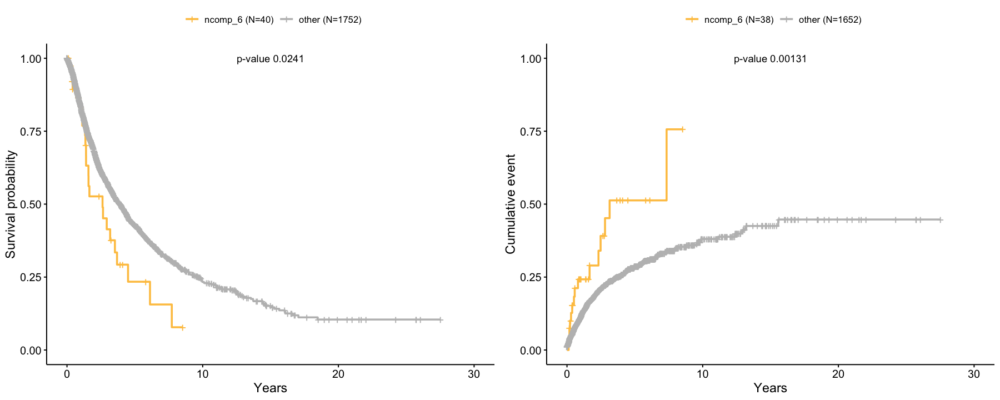

In [110]:
options(repr.plot.width=15, repr.plot.height=6)
res = ComponentOutcome(data=ddall, mycomponent="ncomp_6", mycol=col.component[3])
grid.arrange(res$ggOS,res$ggAML,ncol=2)

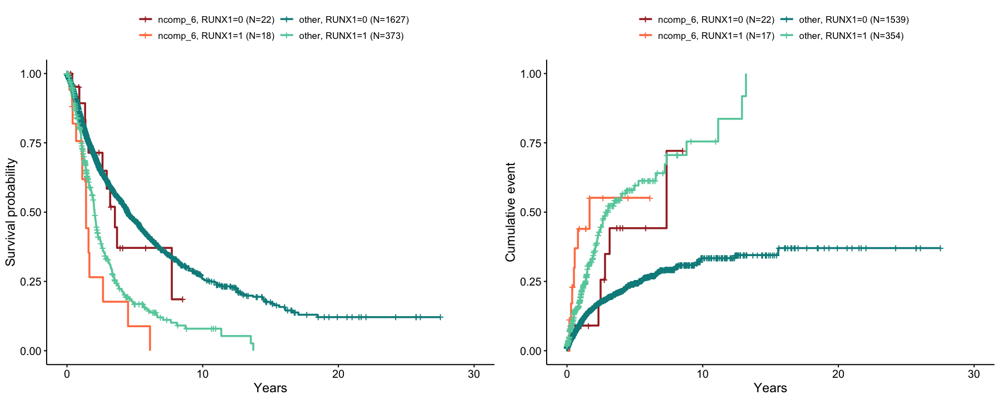

In [111]:
res = MiscComponentOutcome(data=ddall, mycomponent="ncomp_6", covariate="RUNX1")
grid.arrange(res$ggOS,res$ggAML,ncol=2)

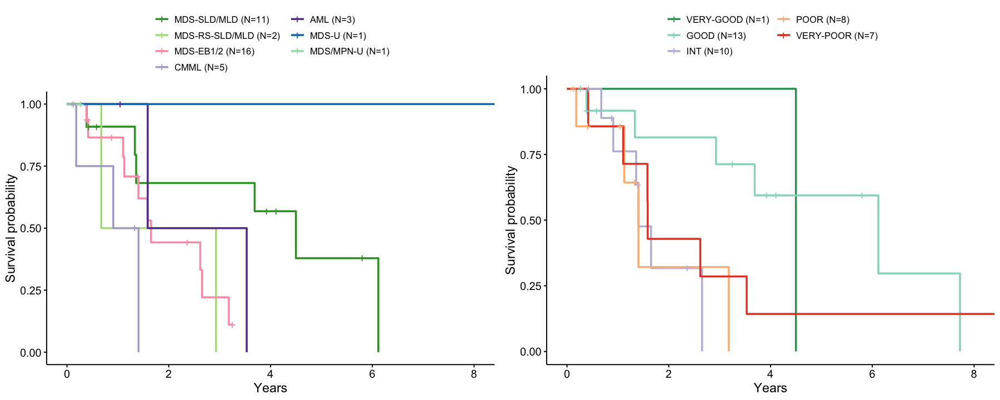

In [112]:
res = ComponentOutcomeStratified(data=ddall,mycomponent="ncomp_6") 
grid.arrange(res$ggwho,res$ggipssr,ncol=2)

## Conclusion:

nComp6 is:

- enriched in BCOR BCORL1 RUNX1 (which are overall co-mutated)

- low Hb, low Plt, low WBC

- poor outcome, with a RUNX1 dichotomoy though

- the IPSS-R Int segregates with the Poor here

# nComponent 7

In [113]:
paste("count is ",sum(ddall$predicted_component=="ncomp_7"))
paste("freq is ",round(100*sum(ddall$predicted_component=="ncomp_7")/nrow(ddall),2),"%")

[1] "count is  70"

[1] "freq is  2.13 %"

In [114]:
res = ComponentEventFreq(data=ddall, mycomponent="ncomp_7", molecular.features=molecular.features, mycol=col.component[1], mycut=2)

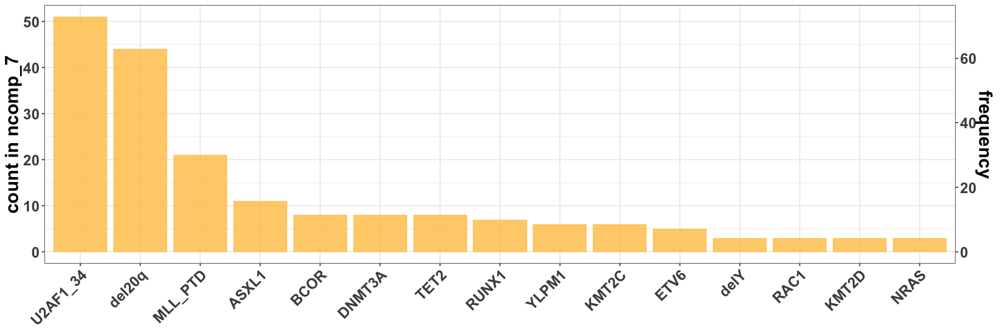

In [115]:
options(repr.plot.width=15, repr.plot.height=5)
res$gbar

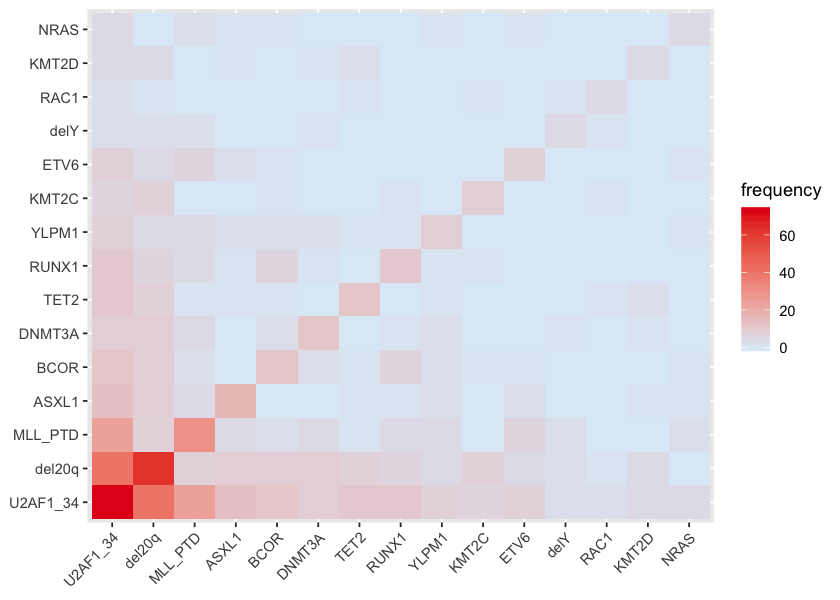

In [116]:
options(repr.plot.width=7, repr.plot.height=5)
res$gfreq

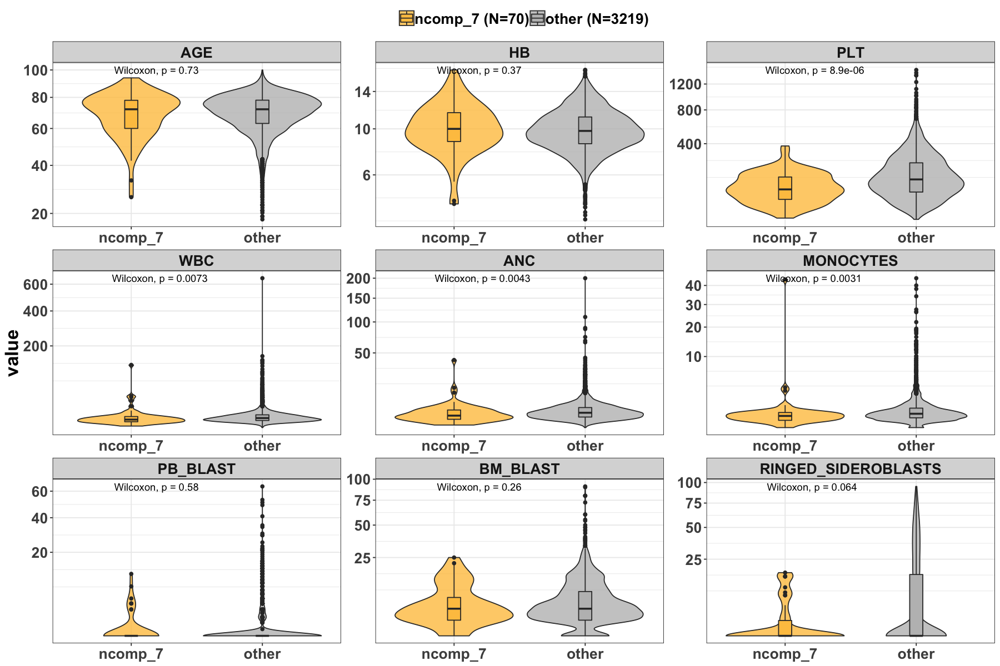

In [117]:
options(warn=-1)
options(repr.plot.width=15, repr.plot.height=10)
ComponentContinuousClinical(data=ddall, mycomponent="ncomp_7", mycol=col.component[1])

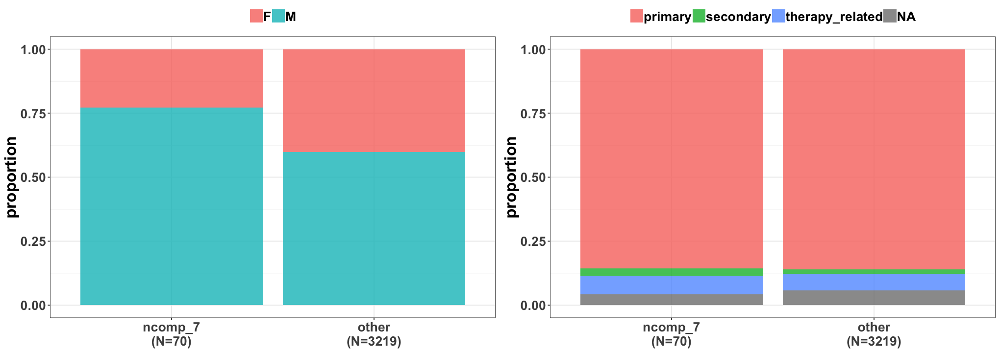

In [118]:
options(repr.plot.width=17, repr.plot.height=6)
gsex = ComponentDiscreteClinical(data=ddall, mycomponent="ncomp_7", mydiscrete="SEX") 
gmds = ComponentDiscreteClinical(data=ddall, mycomponent="ncomp_7", mydiscrete="MDS_TYPE")
grid.arrange(gsex,gmds,ncol=2)

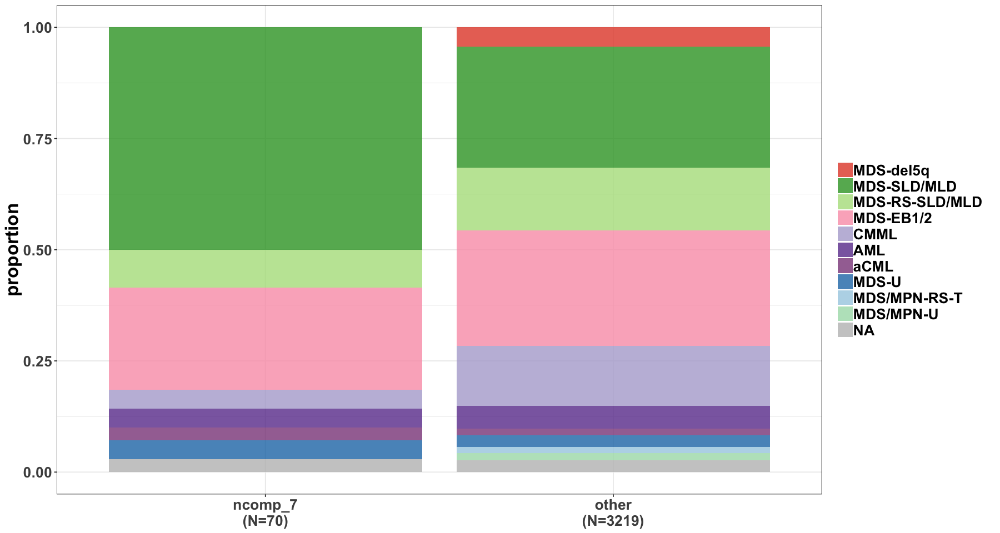

In [119]:
options(repr.plot.width=15, repr.plot.height=8)
ComponentWHO(data=ddall, mycomponent="ncomp_7")

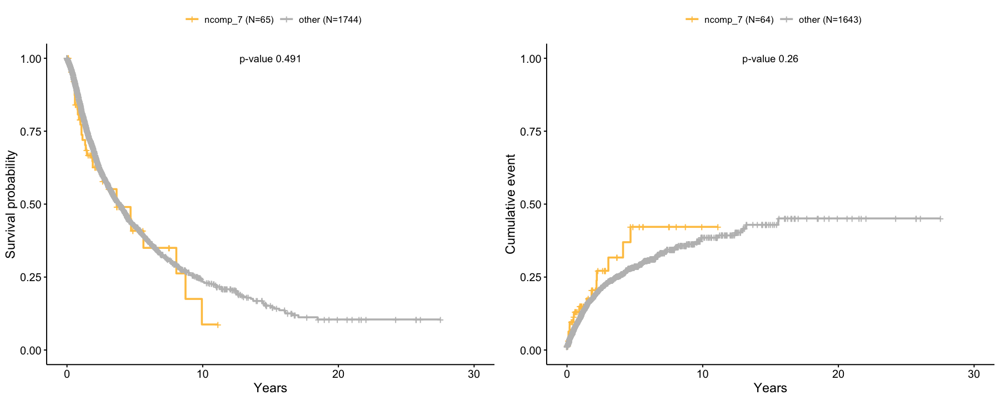

In [120]:
options(repr.plot.width=15, repr.plot.height=6)
res = ComponentOutcome(data=ddall, mycomponent="ncomp_7", mycol=col.component[1])
grid.arrange(res$ggOS,res$ggAML,ncol=2)

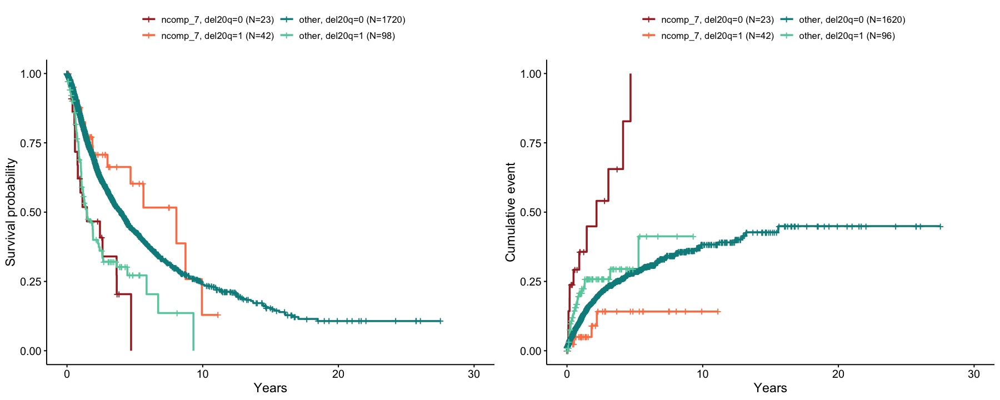

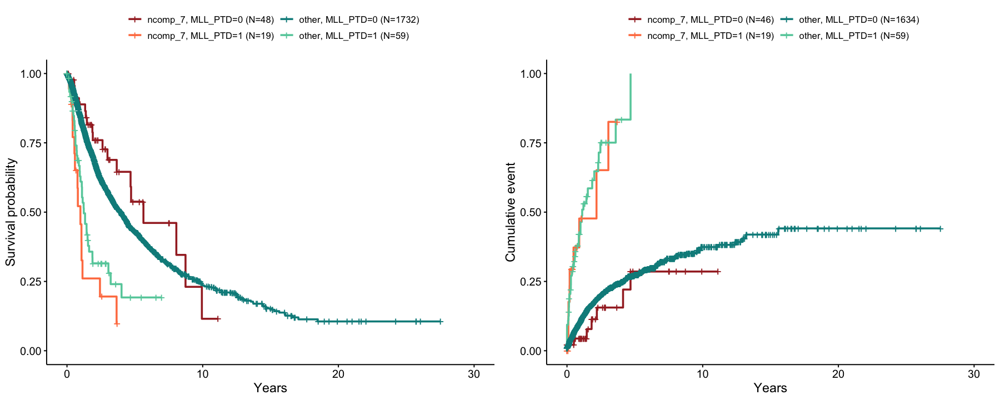

In [121]:
res = MiscComponentOutcome(data=ddall, mycomponent="ncomp_7", covariate="del20q")
grid.arrange(res$ggOS,res$ggAML,ncol=2)
res = MiscComponentOutcome(data=ddall, mycomponent="ncomp_7", covariate="MLL_PTD")
grid.arrange(res$ggOS,res$ggAML,ncol=2)

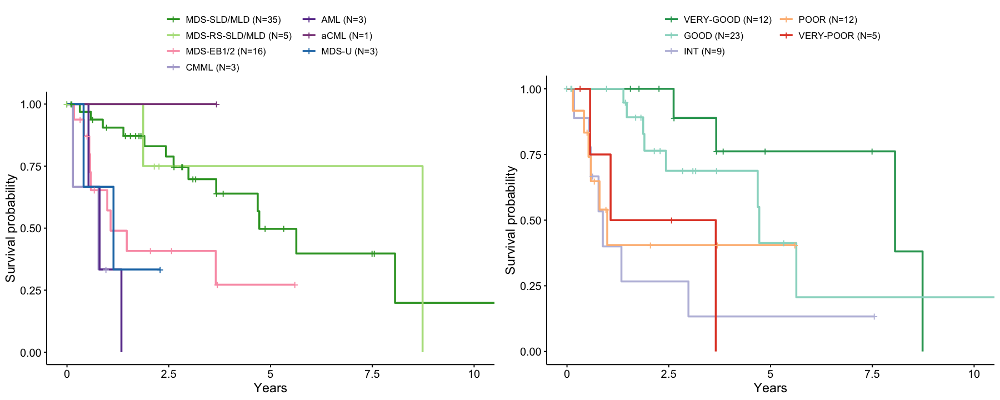

In [122]:
res = ComponentOutcomeStratified(data=ddall,mycomponent="ncomp_7") 
grid.arrange(res$ggwho,res$ggipssr,ncol=2)

## Conclusion:

nComp7 is:

- enriched in U2AF2_34, del20q, MLL-PTD 

- low Plt, low WBC|ANC|Monocytes

- enriched in MDS-SLD/MLD

- outcome stratication with status of del20q (good) as opposed to MLL-PTD (bad), and IPSS-R stratification.


# nComponent 5

In [123]:
paste("count is ",sum(ddall$predicted_component=="ncomp_5"))
paste("freq is ",round(100*sum(ddall$predicted_component=="ncomp_5")/nrow(ddall),2),"%")

[1] "count is  199"

[1] "freq is  6.05 %"

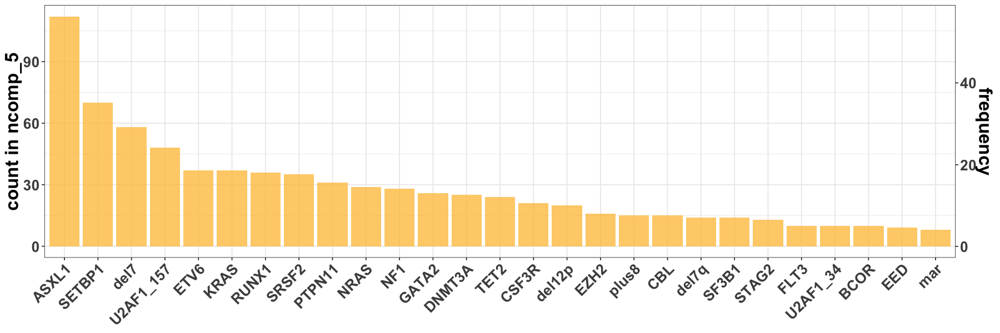

In [124]:
res = ComponentEventFreq(data=ddall, mycomponent="ncomp_5", molecular.features=molecular.features, mycol=col.component[10], mycut=7)
options(repr.plot.width=15, repr.plot.height=5)
res$gbar

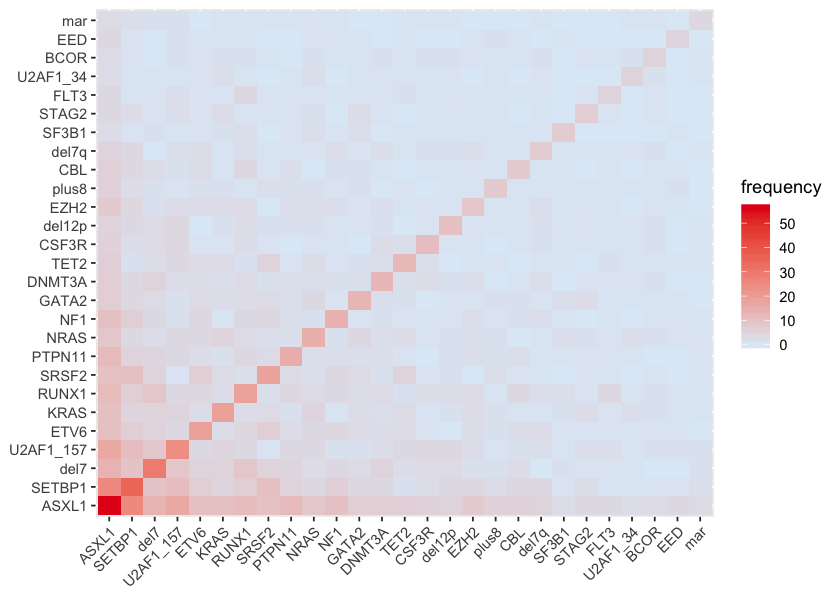

In [125]:
options(repr.plot.width=7, repr.plot.height=5)
res$gfreq

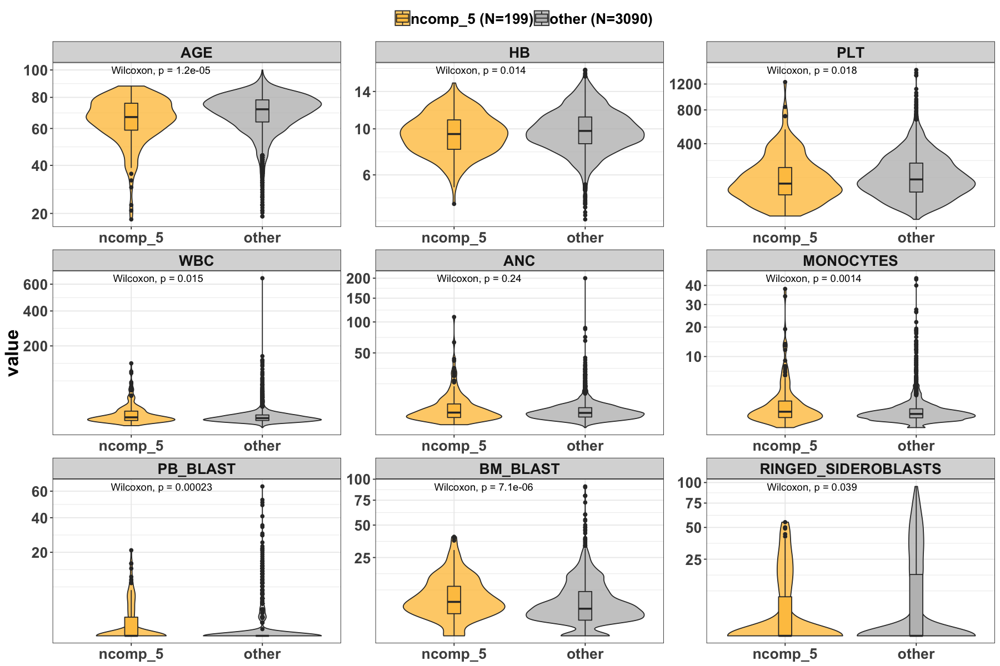

In [126]:
options(repr.plot.width=15, repr.plot.height=10)
ComponentContinuousClinical(data=ddall, mycomponent="ncomp_5", mycol=col.component[4])

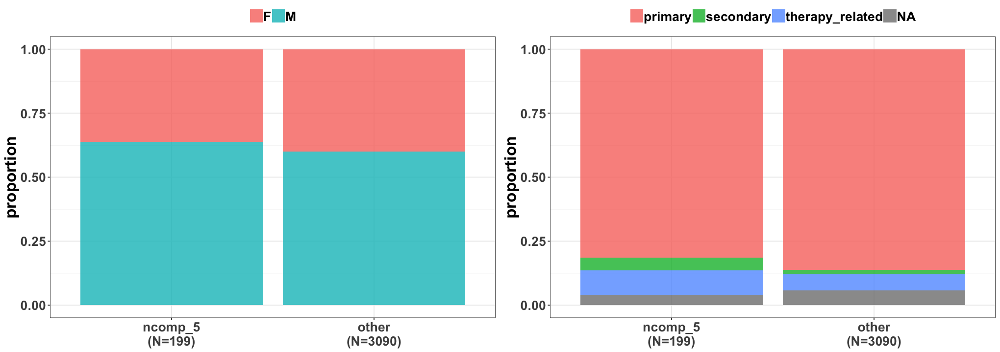

In [127]:
options(repr.plot.width=17, repr.plot.height=6)
gsex = ComponentDiscreteClinical(data=ddall, mycomponent="ncomp_5", mydiscrete="SEX") 
gmds = ComponentDiscreteClinical(data=ddall, mycomponent="ncomp_5", mydiscrete="MDS_TYPE")
grid.arrange(gsex,gmds,ncol=2)

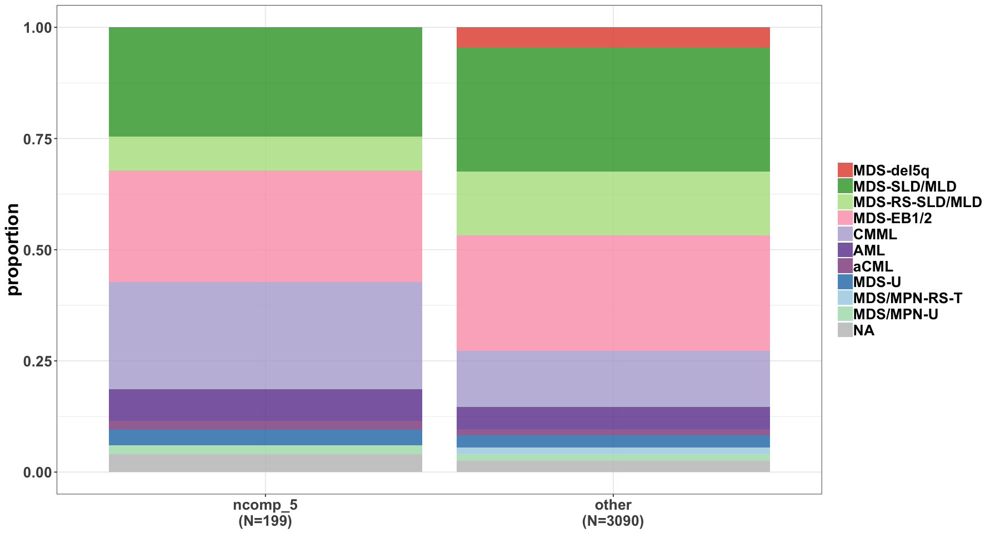

In [128]:
options(repr.plot.width=15, repr.plot.height=8)
ComponentWHO(data=ddall, mycomponent="ncomp_5")

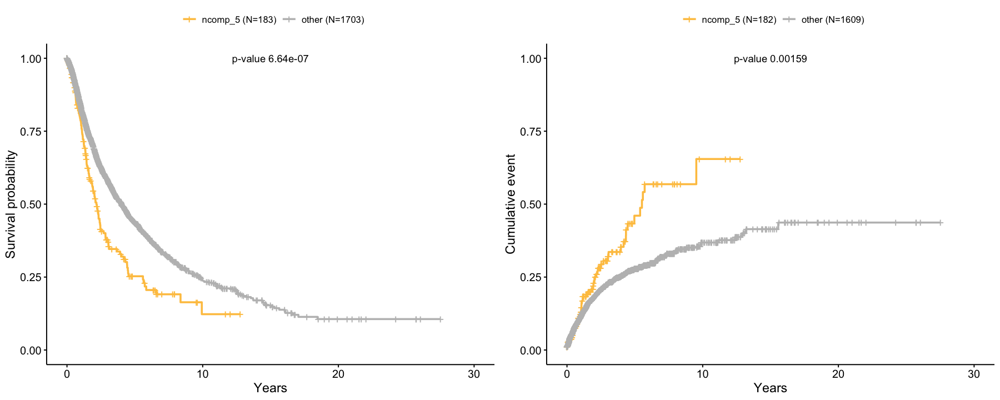

In [129]:
options(repr.plot.width=15, repr.plot.height=6)
res = ComponentOutcome(data=ddall, mycomponent="ncomp_5", mycol=col.component[4])
grid.arrange(res$ggOS,res$ggAML,ncol=2)

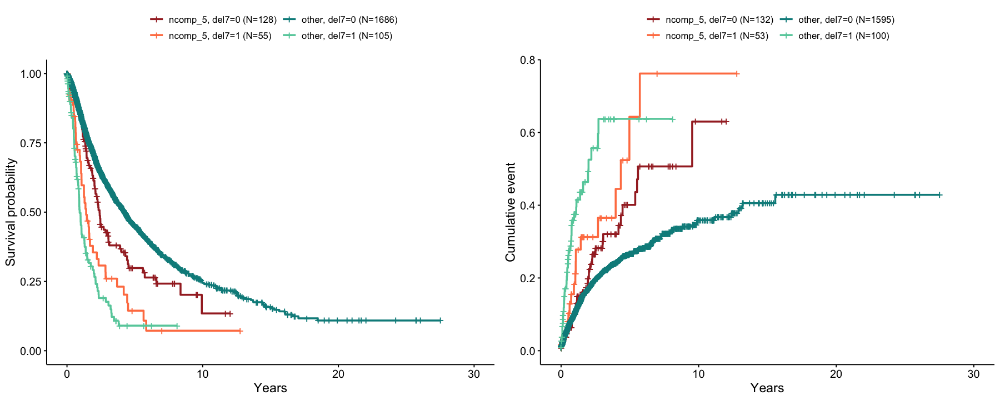

In [130]:
res = MiscComponentOutcome(data=ddall, mycomponent="ncomp_5", mycol=col.component[4], covariate="del7")
grid.arrange(res$ggOS,res$ggAML,ncol=2)

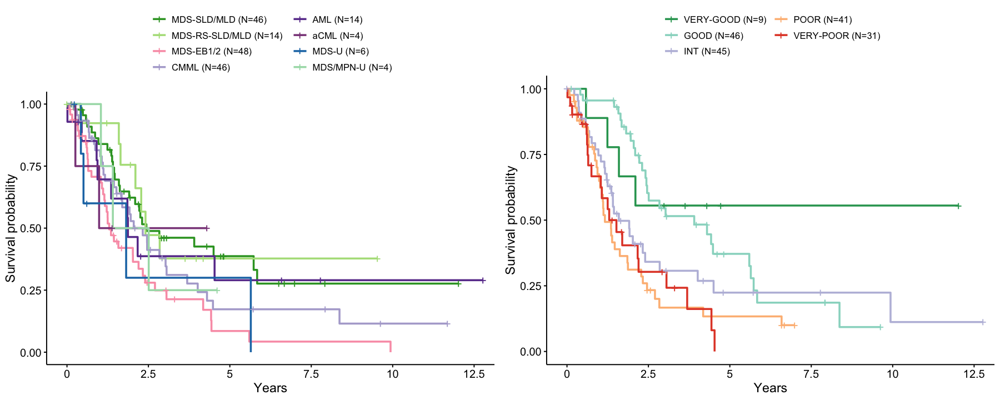

In [131]:
res = ComponentOutcomeStratified(data=ddall,mycomponent="ncomp_5") 
grid.arrange(res$ggwho,res$ggipssr,ncol=2)

## Conclusion

nComponent 5 is:

- enriched in ASXL1, SETBP1, del7, U2AF1_157, ETV6, KRAS, RUNX1 

- lower Age

- high WBC | Monocytes

- enriched in CMML

- poor outcome, somewhat dichotomy with del7 

- segragation of IPPS-R Int within the Poor

# nComponent 2

In [132]:
paste("count is ",sum(ddall$predicted_component=="ncomp_2"))
paste("freq is ",round(100*sum(ddall$predicted_component=="ncomp_2")/nrow(ddall),2),"%")

[1] "count is  449"

[1] "freq is  13.65 %"

In [133]:
res = ComponentEventFreq(data=ddall, mycomponent="ncomp_2", molecular.features=molecular.features, mycol=col.component[3], mycut=7)

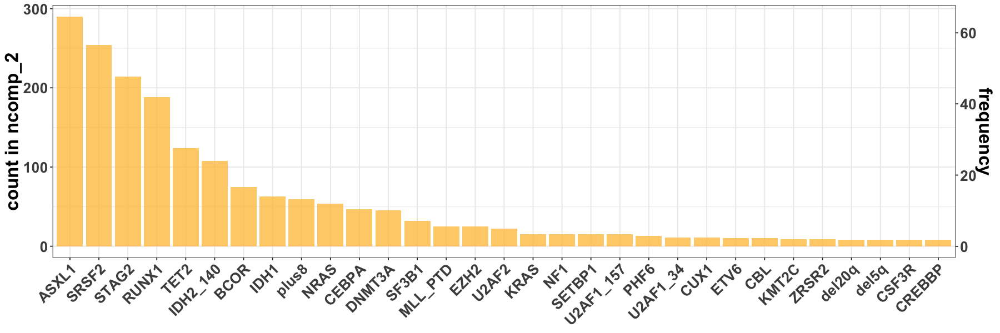

In [134]:
options(repr.plot.width=15, repr.plot.height=5)
res$gbar

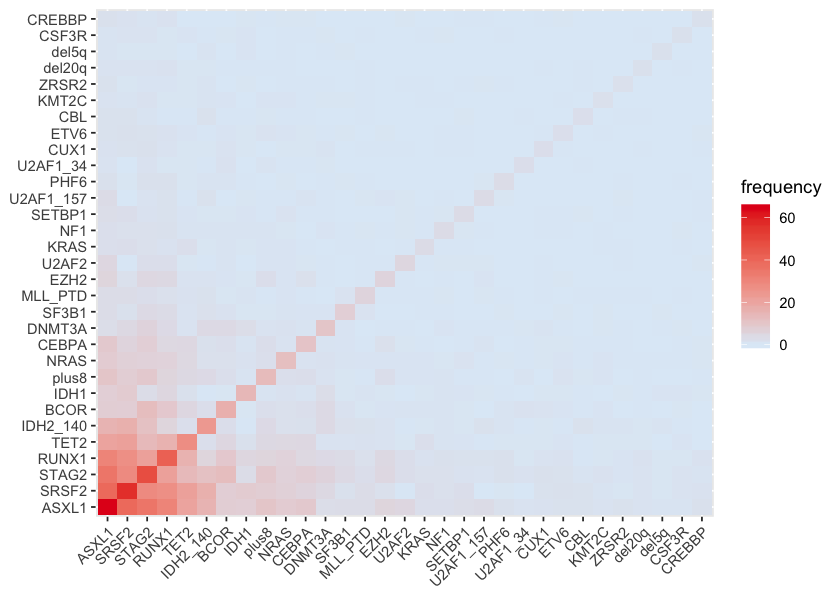

In [135]:
options(repr.plot.width=7, repr.plot.height=5)
res$gfreq

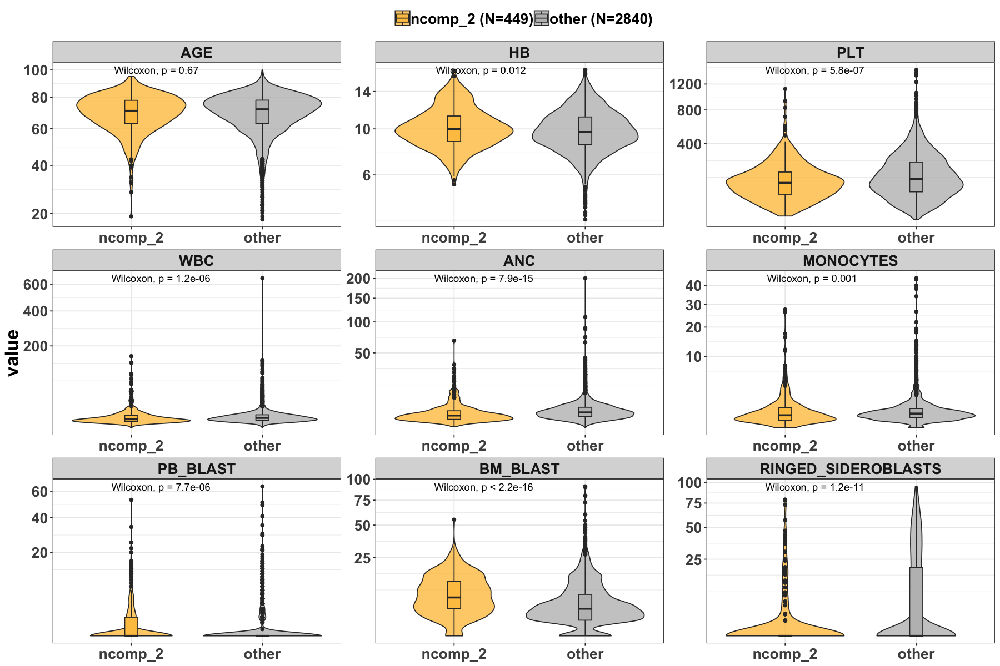

In [136]:
options(warn=-1)
options(repr.plot.width=15, repr.plot.height=10)
ComponentContinuousClinical(data=ddall, mycomponent="ncomp_2", mycol=col.component[3])

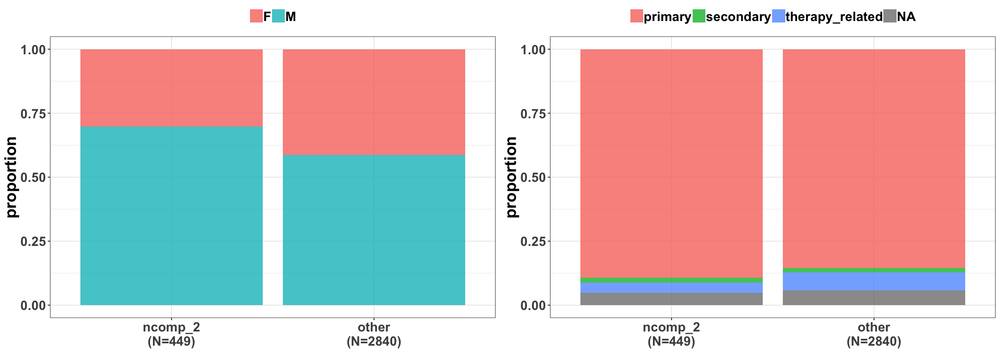

In [137]:
options(repr.plot.width=17, repr.plot.height=6)
gsex = ComponentDiscreteClinical(data=ddall, mycomponent="ncomp_2", mydiscrete="SEX") 
gmds = ComponentDiscreteClinical(data=ddall, mycomponent="ncomp_2", mydiscrete="MDS_TYPE")
grid.arrange(gsex,gmds,ncol=2)

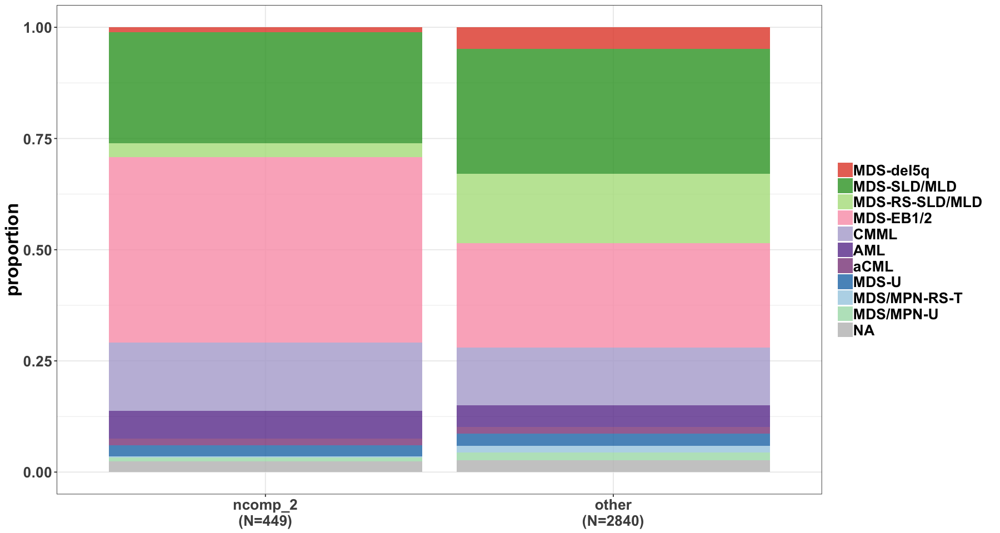

In [138]:
options(repr.plot.width=15, repr.plot.height=8)
ComponentWHO(data=ddall, mycomponent="ncomp_2")

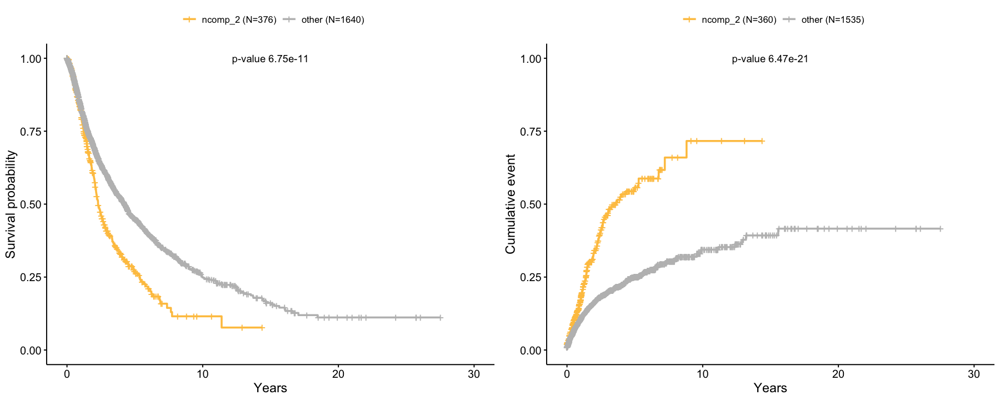

In [139]:
options(repr.plot.width=15, repr.plot.height=6)
res = ComponentOutcome(data=ddall, mycomponent="ncomp_2", mycol=col.component[3])
grid.arrange(res$ggOS,res$ggAML,ncol=2)

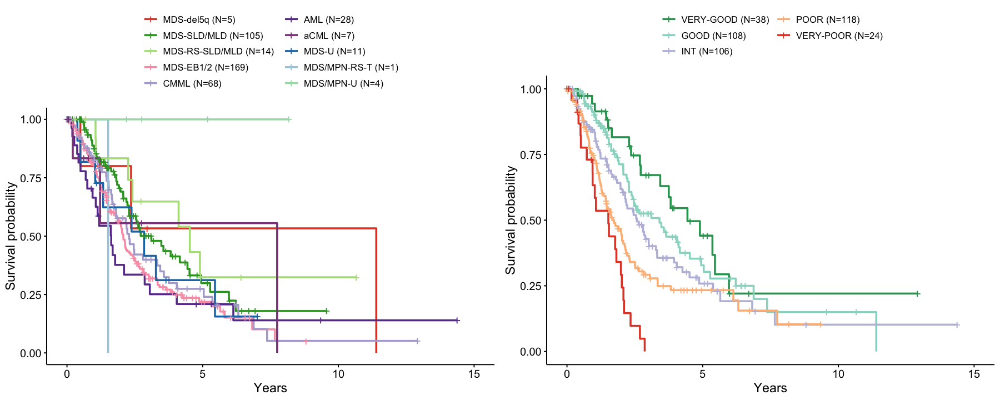

In [140]:
res = ComponentOutcomeStratified(data=ddall,mycomponent="ncomp_2") 
grid.arrange(res$ggwho,res$ggipssr,ncol=2)

## Conclusion

nComponent 2 is:

- enriched in ASXL1 SRSF2 STAG2 RUNX1 TET2 IDH240

- low Plt, low WBC|ANC|Monocytes

- enriched in MDS-EB1/1

- poor outcome, stratification with IPSS-R

# nComponent 4

In [141]:
paste("count is ",sum(ddall$predicted_component=="ncomp_4"))
paste("freq is ",round(100*sum(ddall$predicted_component=="ncomp_4")/nrow(ddall),2),"%")

[1] "count is  221"

[1] "freq is  6.72 %"

In [142]:
res = ComponentEventFreq(data=ddall, mycomponent="ncomp_4", molecular.features=molecular.features, mycol=col.component[1], mycut=5)

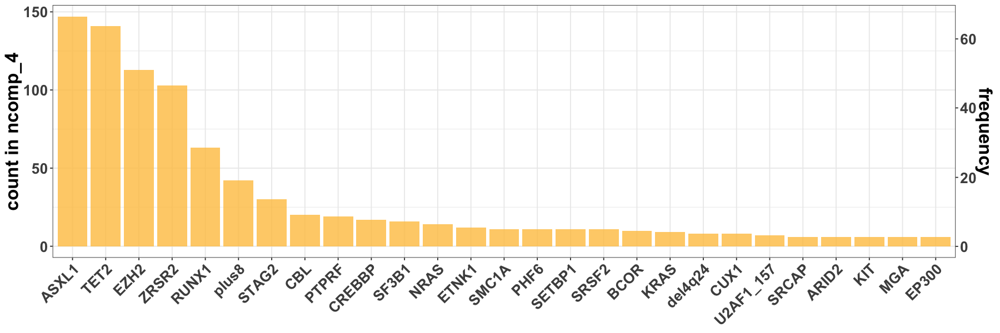

In [143]:
options(repr.plot.width=15, repr.plot.height=5)
res$gbar

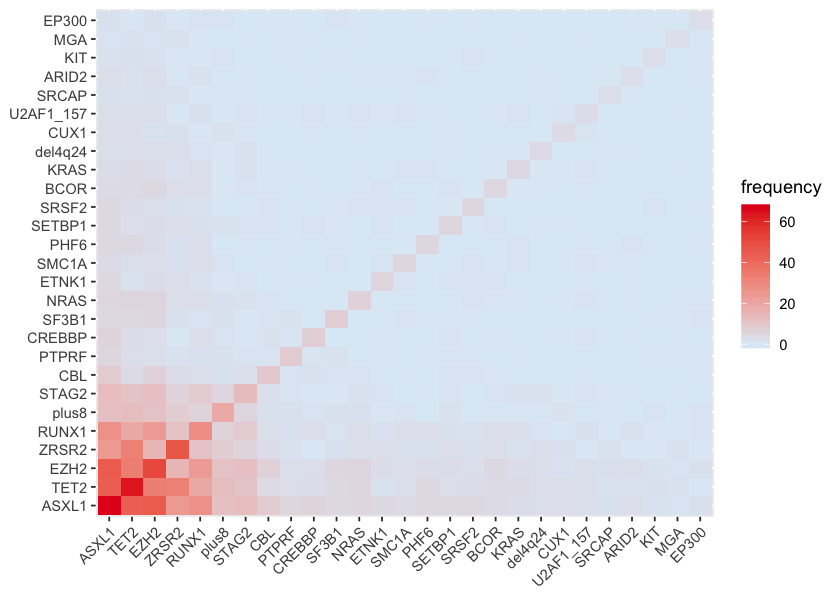

In [144]:
options(repr.plot.width=7, repr.plot.height=5)
res$gfreq

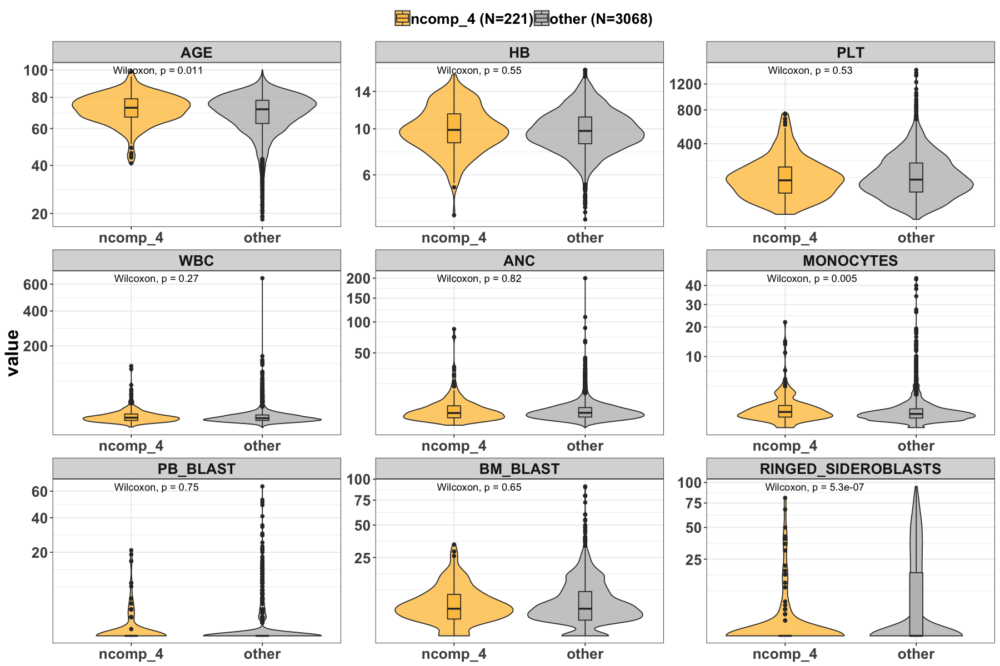

In [145]:
options(warn=-1)
options(repr.plot.width=15, repr.plot.height=10)
ComponentContinuousClinical(data=ddall, mycomponent="ncomp_4", mycol=col.component[1])

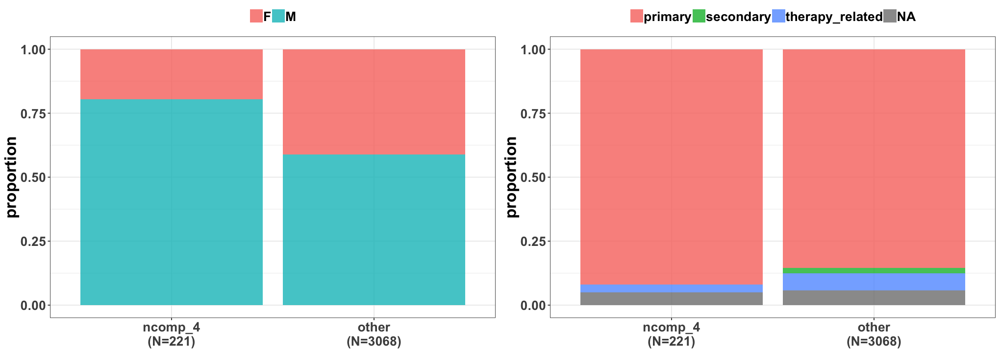

In [146]:
options(repr.plot.width=17, repr.plot.height=6)
gsex = ComponentDiscreteClinical(data=ddall, mycomponent="ncomp_4", mydiscrete="SEX") 
gmds = ComponentDiscreteClinical(data=ddall, mycomponent="ncomp_4", mydiscrete="MDS_TYPE")
grid.arrange(gsex,gmds,ncol=2)

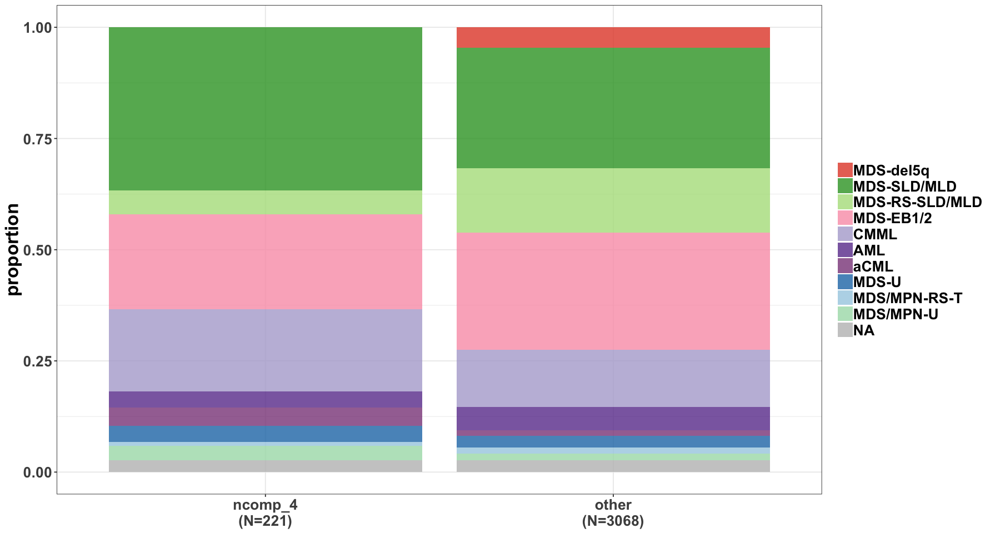

In [147]:
options(repr.plot.width=15, repr.plot.height=8)
ComponentWHO(data=ddall, mycomponent="ncomp_4")

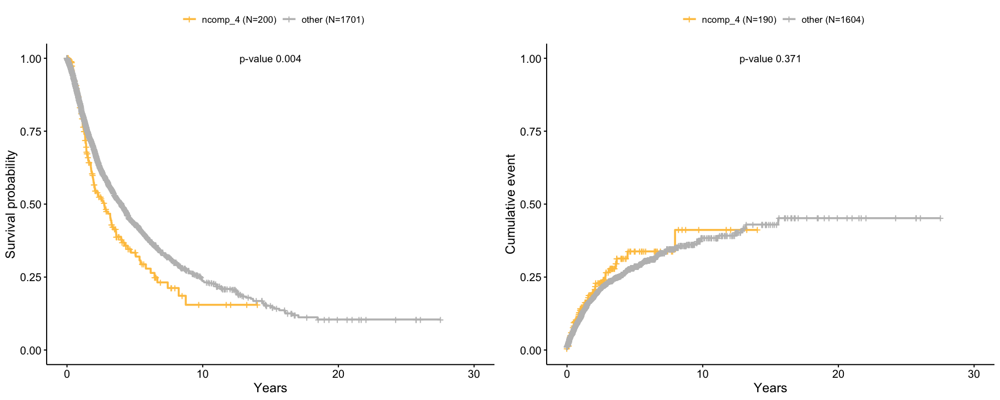

In [148]:
options(repr.plot.width=15, repr.plot.height=6)
res = ComponentOutcome(data=ddall, mycomponent="ncomp_4", mycol=col.component[1])
grid.arrange(res$ggOS,res$ggAML,ncol=2)

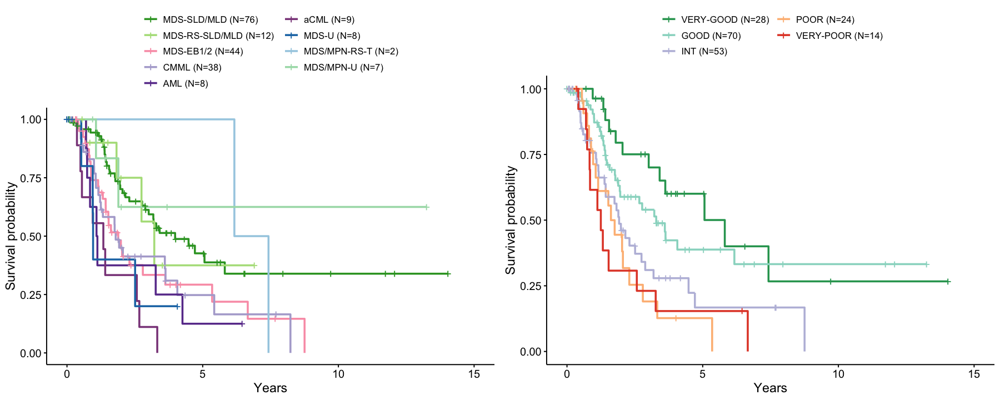

In [149]:
res = ComponentOutcomeStratified(data=ddall,mycomponent="ncomp_4") 
grid.arrange(res$ggwho,res$ggipssr,ncol=2)

## Conclusion:

nComponent 4:

- similar composition as of nComp 2 but with switch from SRSF2 to EZH2|ZRSR2

- stratification with IPSSR

# nComponent 3

In [150]:
paste("count is ",sum(ddall$predicted_component=="ncomp_3"))
paste("freq is ",round(100*sum(ddall$predicted_component=="ncomp_3")/nrow(ddall),2),"%")

[1] "count is  374"

[1] "freq is  11.37 %"

In [151]:
res = ComponentEventFreq(data=ddall, mycomponent="ncomp_3", molecular.features=molecular.features, mycol=col.component[1], mycut=10)

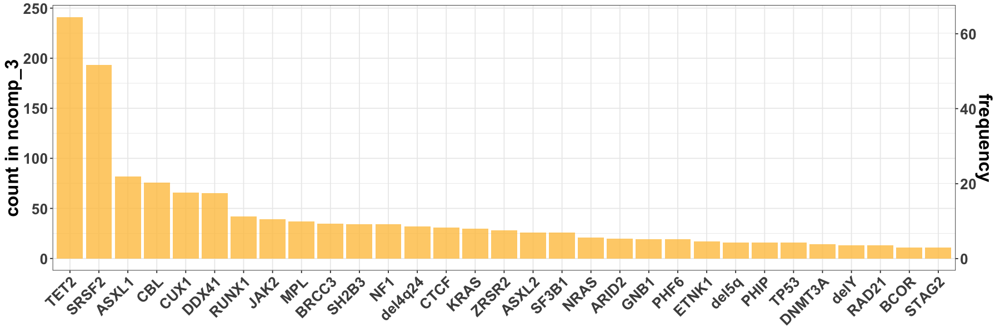

In [152]:
options(repr.plot.width=15, repr.plot.height=5)
res$gbar

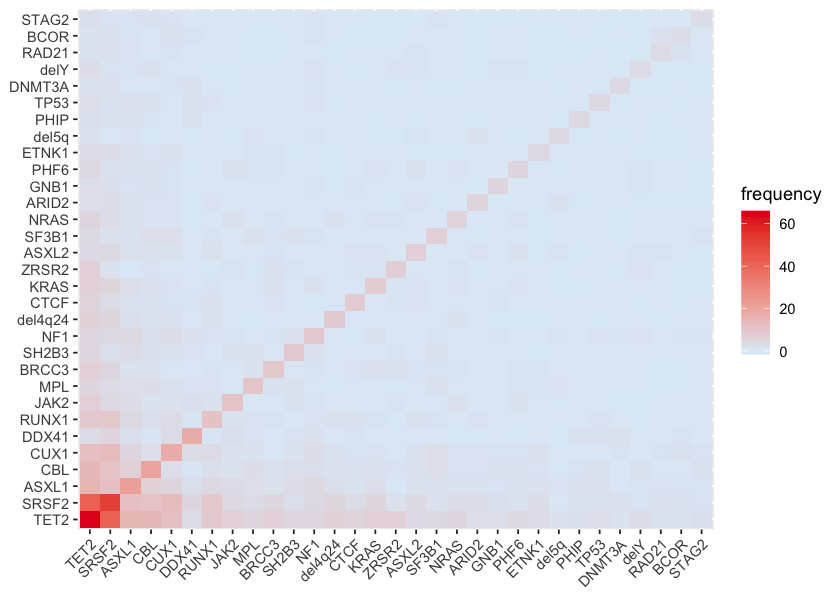

In [153]:
options(repr.plot.width=7, repr.plot.height=5)
res$gfreq

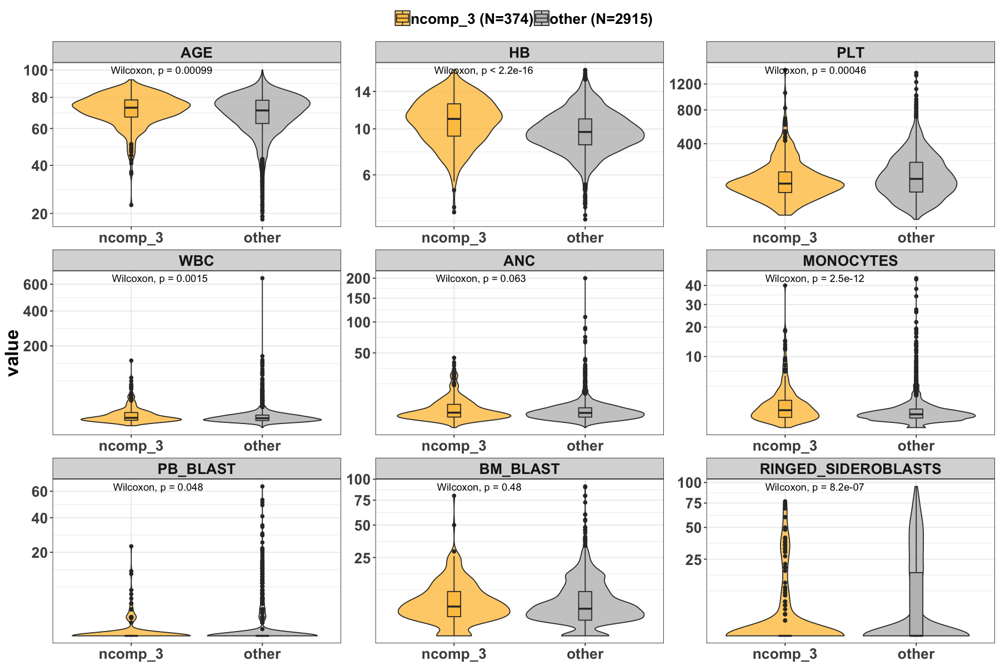

In [154]:
options(repr.plot.width=15, repr.plot.height=10)
ComponentContinuousClinical(data=ddall, mycomponent="ncomp_3", mycol=col.component[1])

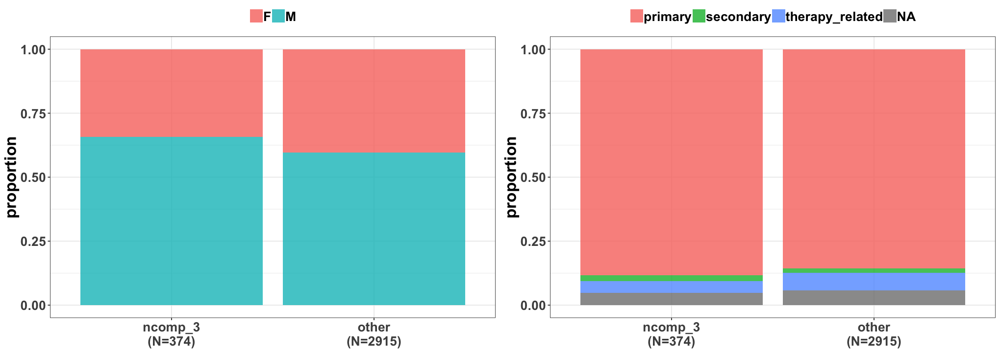

In [155]:
options(repr.plot.width=17, repr.plot.height=6)
gsex = ComponentDiscreteClinical(data=ddall, mycomponent="ncomp_3", mydiscrete="SEX") 
gmds = ComponentDiscreteClinical(data=ddall, mycomponent="ncomp_3", mydiscrete="MDS_TYPE")
grid.arrange(gsex,gmds,ncol=2)

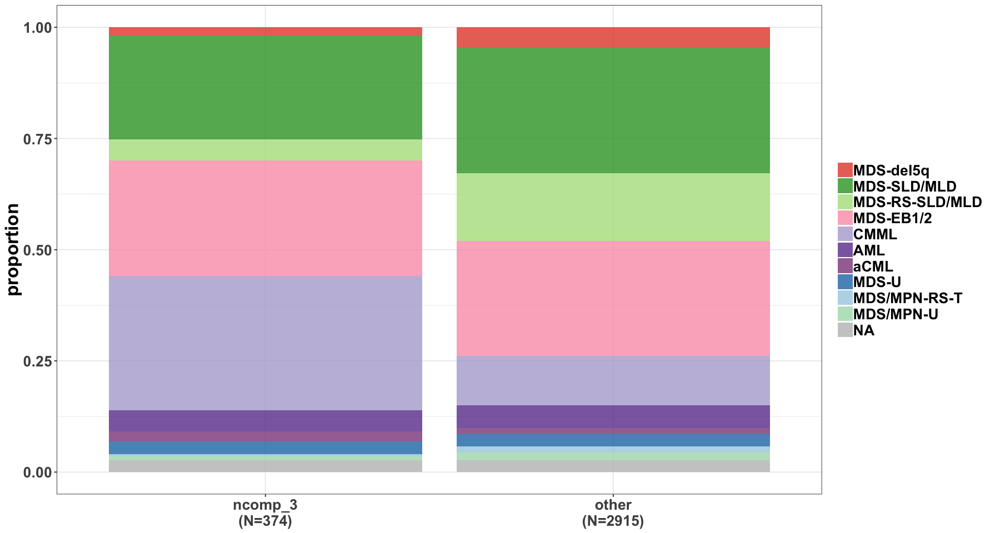

In [156]:
options(repr.plot.width=15, repr.plot.height=8)
ComponentWHO(data=ddall, mycomponent="ncomp_3")

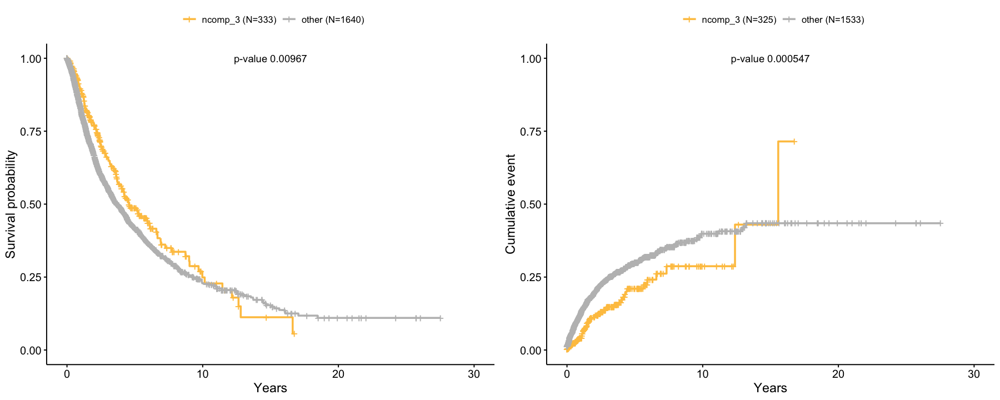

In [157]:
options(repr.plot.width=15, repr.plot.height=6)
res = ComponentOutcome(data=ddall, mycomponent="ncomp_3", mycol=col.component[1])
grid.arrange(res$ggOS,res$ggAML,ncol=2)

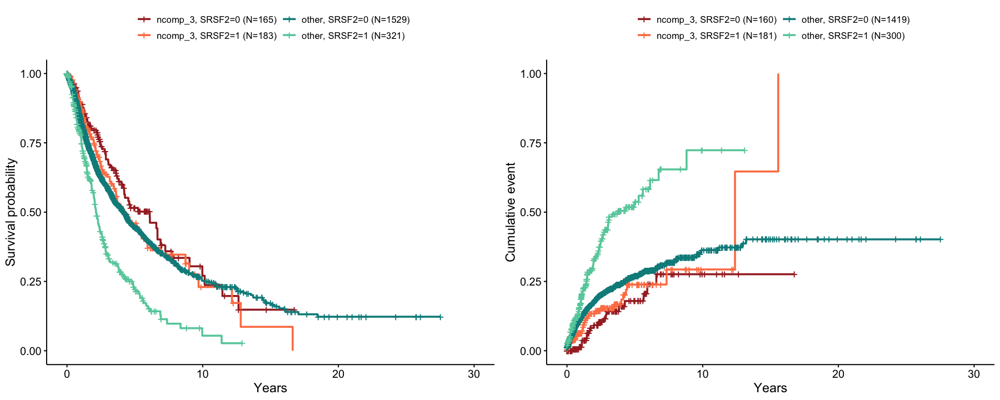

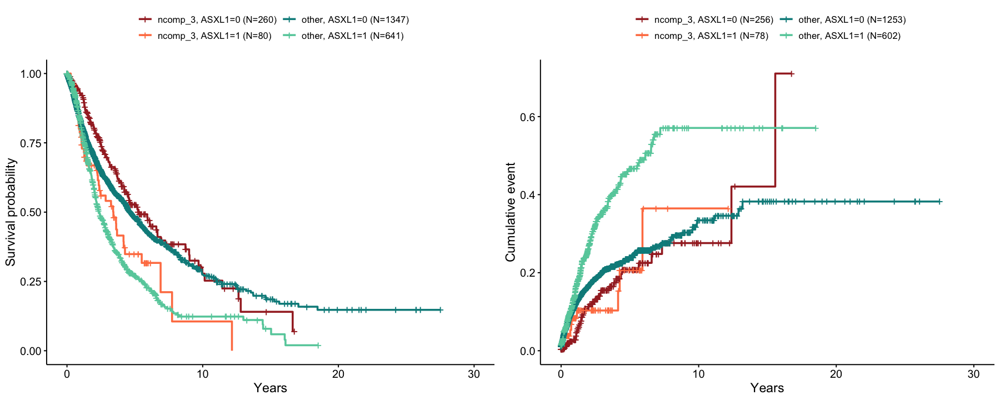

In [158]:
res = MiscComponentOutcome(data=ddall, mycomponent="ncomp_3", covariate="SRSF2")
grid.arrange(res$ggOS,res$ggAML,ncol=2)
res = MiscComponentOutcome(data=ddall, mycomponent="ncomp_3", covariate="ASXL1")
grid.arrange(res$ggOS,res$ggAML,ncol=2)

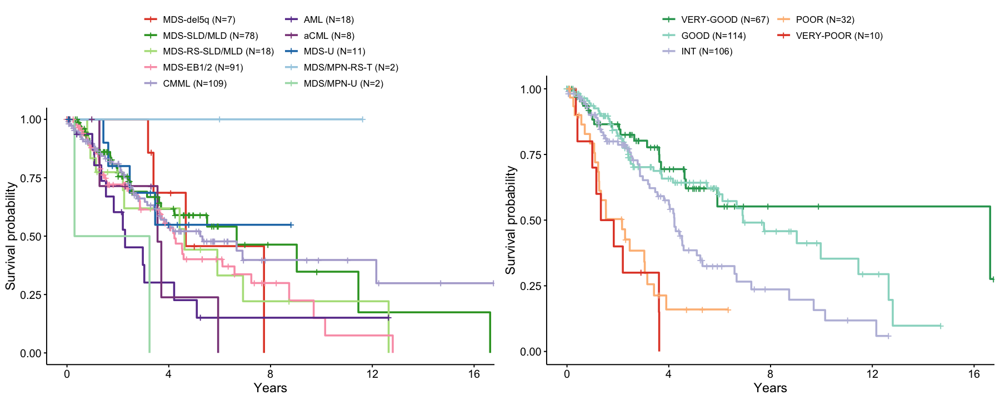

In [159]:
res = ComponentOutcomeStratified(data=ddall,mycomponent="ncomp_3") 
grid.arrange(res$ggwho,res$ggipssr,ncol=2)

## Conclusion:

nCompoent 3 is:

- enriched in TET2 SRSF2 ASXL1 CBL CUX1 DDX41

- note the presene of del4q24 so that TET2-2-hit

- high Hb, high Monocytes

- mild enriched in CMML 

- mild outcome

- **importantly,** patients with SRSF2 in that components better than SRSF2 from others.

# nComponent 0

In [160]:
paste("count is ",sum(ddall$predicted_component=="ncomp_0"))
paste("freq is ",round(100*sum(ddall$predicted_component=="ncomp_0")/nrow(ddall),2),"%")

[1] "count is  294"

[1] "freq is  8.94 %"

In [161]:
res = ComponentEventFreq(data=ddall, mycomponent="ncomp_0", molecular.features=molecular.features, mycol=col.component[1], mycut=8)

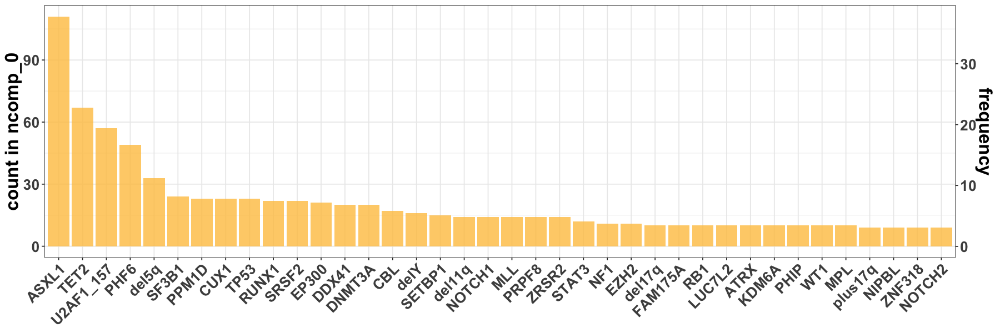

In [162]:
options(repr.plot.width=15, repr.plot.height=5)
res$gbar

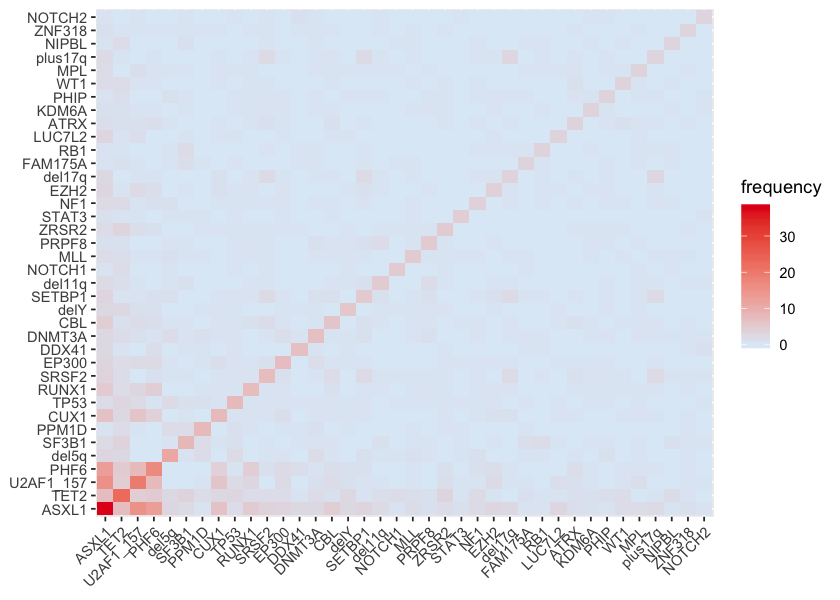

In [163]:
options(repr.plot.width=7, repr.plot.height=5)
res$gfreq

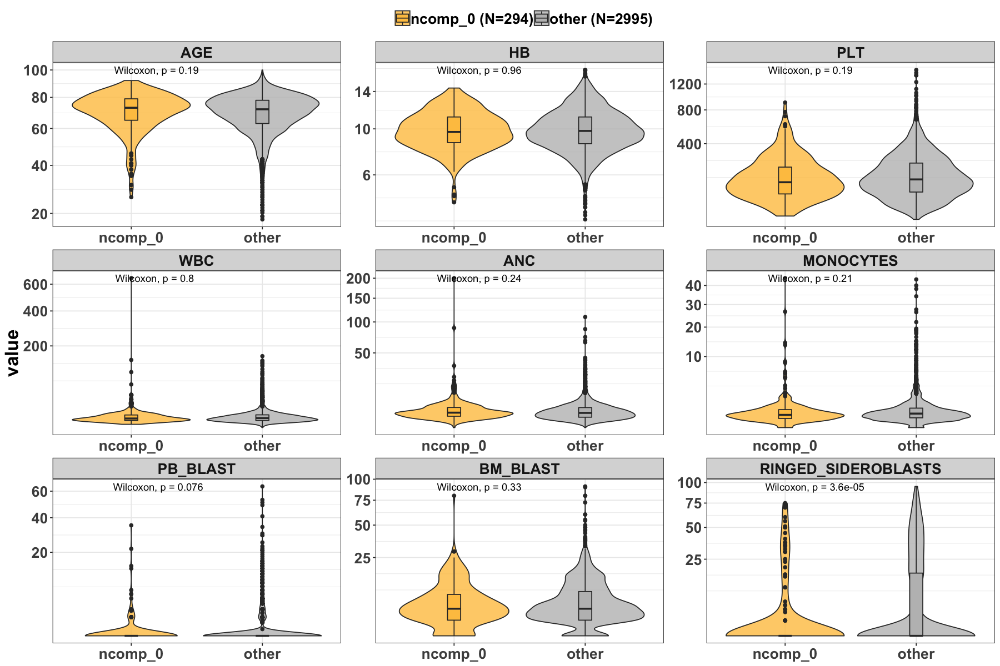

In [164]:
options(repr.plot.width=15, repr.plot.height=10)
ComponentContinuousClinical(data=ddall, mycomponent="ncomp_0", mycol=col.component[1])

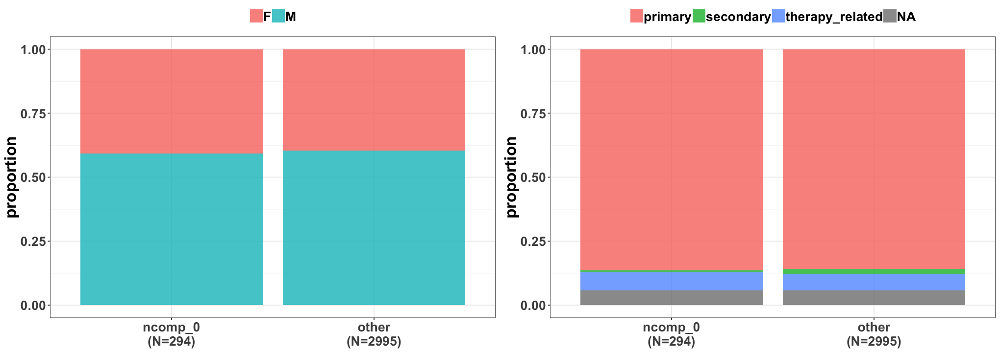

In [165]:
options(repr.plot.width=17, repr.plot.height=6)
gsex = ComponentDiscreteClinical(data=ddall, mycomponent="ncomp_0", mydiscrete="SEX") 
gmds = ComponentDiscreteClinical(data=ddall, mycomponent="ncomp_0", mydiscrete="MDS_TYPE")
grid.arrange(gsex,gmds,ncol=2)

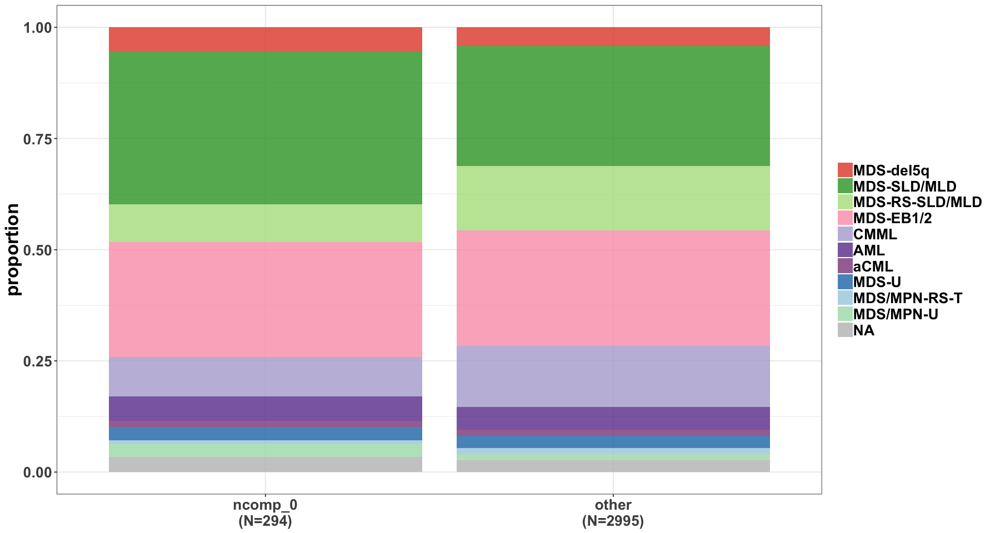

In [166]:
options(repr.plot.width=15, repr.plot.height=8)
ComponentWHO(data=ddall, mycomponent="ncomp_0")

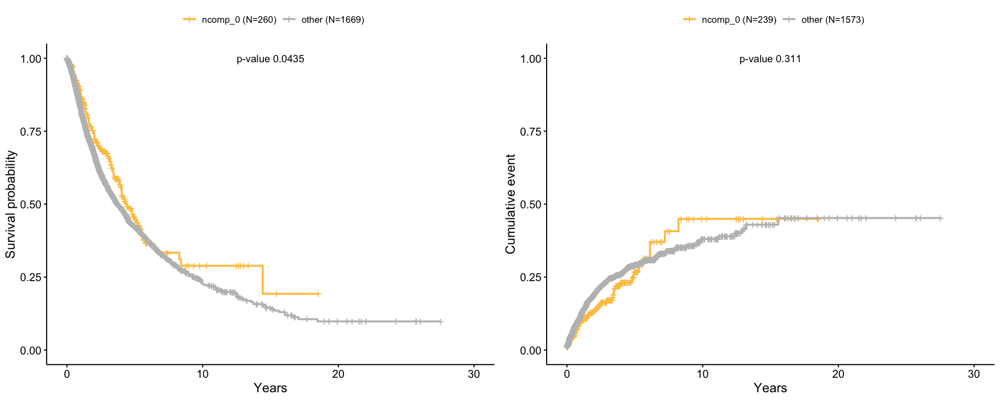

In [167]:
options(repr.plot.width=15, repr.plot.height=6)
res = ComponentOutcome(data=ddall, mycomponent="ncomp_0", mycol=col.component[1])
grid.arrange(res$ggOS,res$ggAML,ncol=2)

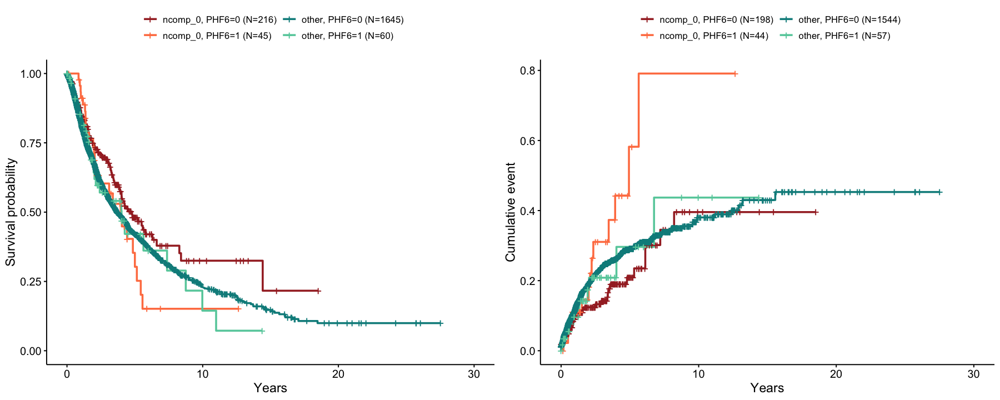

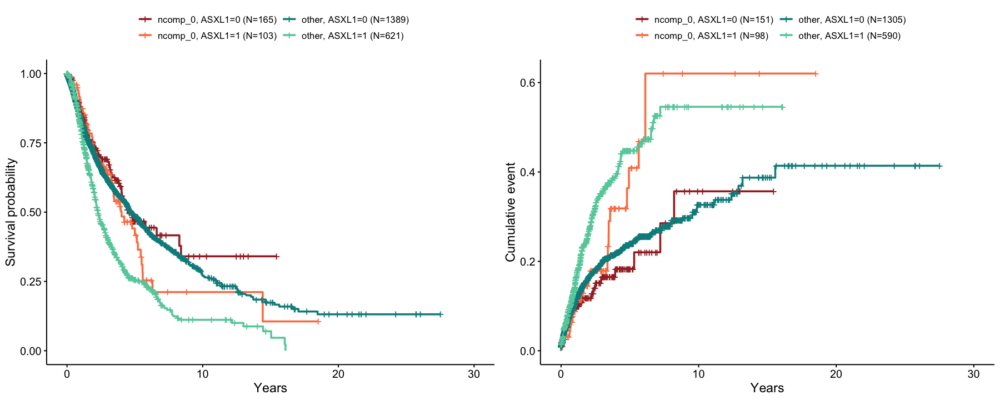

In [168]:
res = MiscComponentOutcome(data=ddall, mycomponent="ncomp_0", covariate="PHF6")
grid.arrange(res$ggOS,res$ggAML,ncol=2)
res = MiscComponentOutcome(data=ddall, mycomponent="ncomp_0", covariate="ASXL1")
grid.arrange(res$ggOS,res$ggAML,ncol=2)

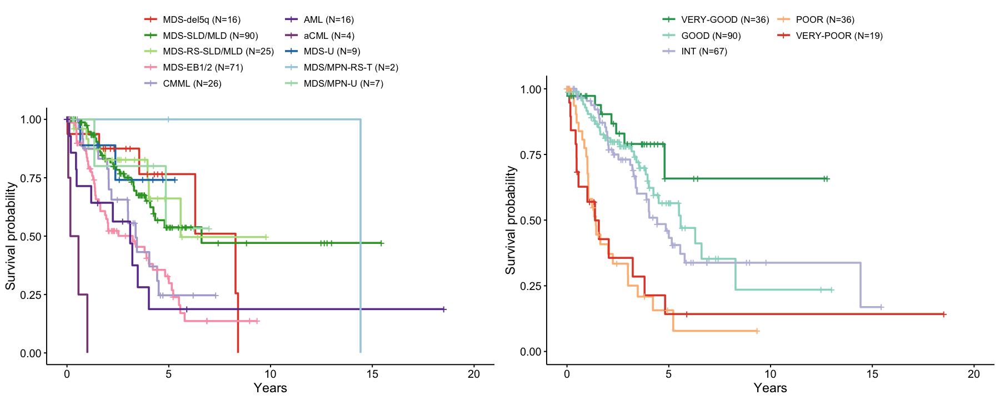

In [169]:
res = ComponentOutcomeStratified(data=ddall,mycomponent="ncomp_0") 
grid.arrange(res$ggwho,res$ggipssr,ncol=2)

## Conclusion

nComponent 0 is:

- enriched in PHF6

- segregation of the IPPS-R Int with the Good.

# Component Nan

In [170]:
paste("count is ",sum(ddall$predicted_component=="ncomp_NaN"))
paste("freq is ",round(100*sum(ddall$predicted_component=="ncomp_NaN")/nrow(ddall),2),"%")

[1] "count is  155"

[1] "freq is  4.71 %"

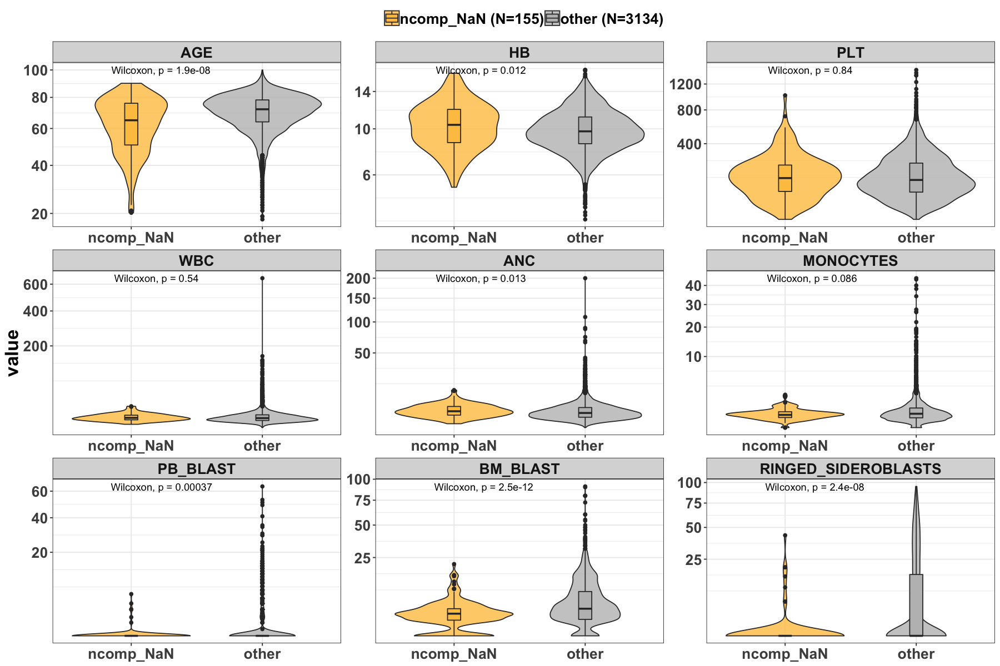

In [171]:
options(warn=-1)
options(repr.plot.width=15, repr.plot.height=10)
ComponentContinuousClinical(data=ddall, mycomponent="ncomp_NaN", mycol=col.component[1])

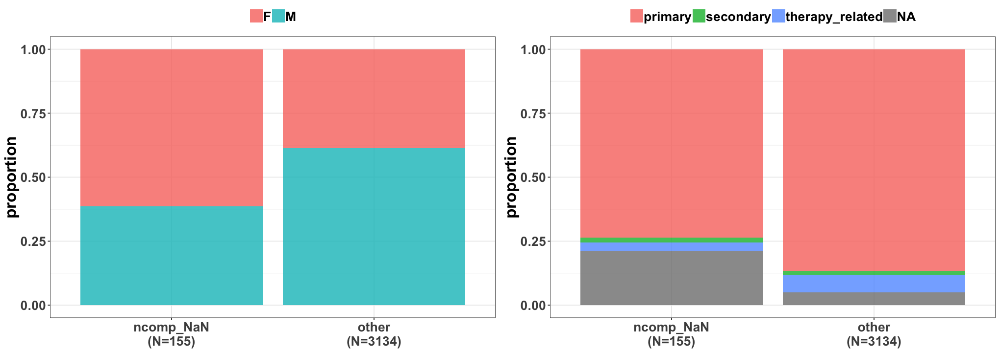

In [172]:
options(repr.plot.width=17, repr.plot.height=6)
gsex = ComponentDiscreteClinical(data=ddall, mycomponent="ncomp_NaN", mydiscrete="SEX") 
gmds = ComponentDiscreteClinical(data=ddall, mycomponent="ncomp_NaN", mydiscrete="MDS_TYPE")
grid.arrange(gsex,gmds,ncol=2)

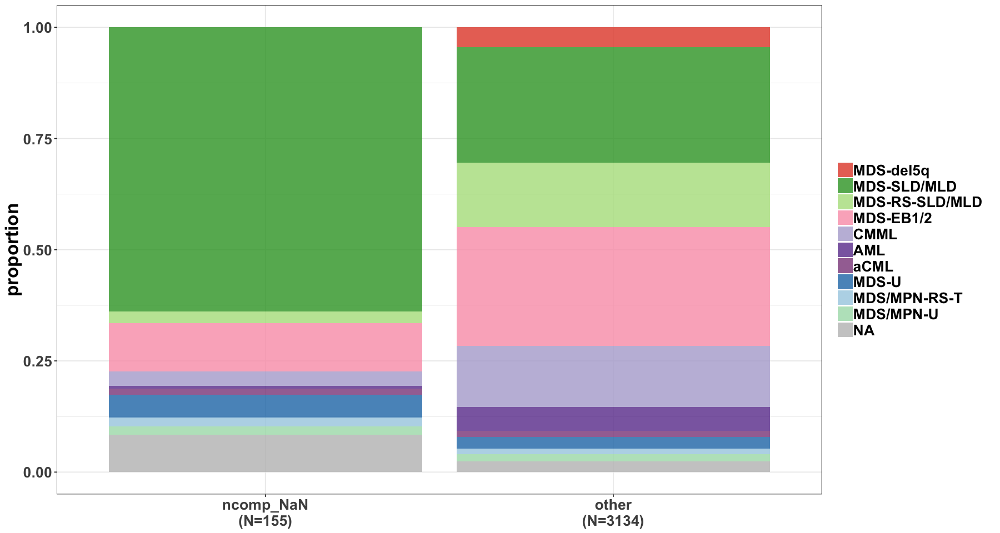

In [173]:
options(repr.plot.width=15, repr.plot.height=8)
ComponentWHO(data=ddall, mycomponent="ncomp_NaN")

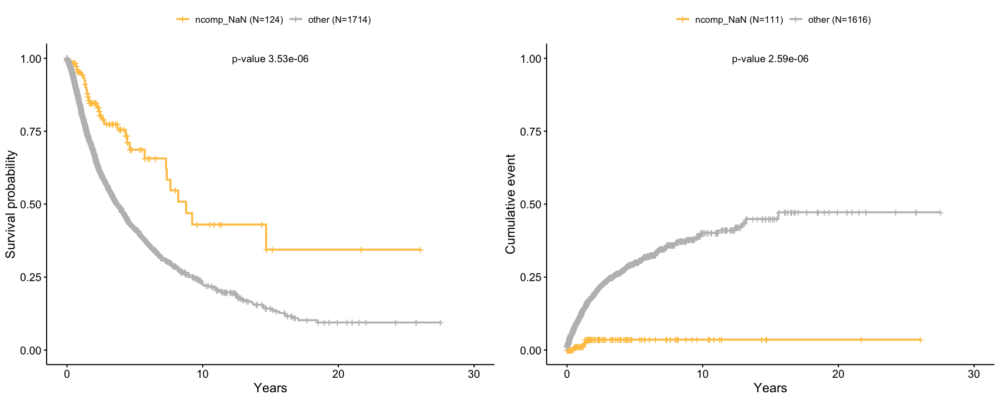

In [174]:
options(repr.plot.width=15, repr.plot.height=6)
res = ComponentOutcome(data=ddall, mycomponent="ncomp_NaN", mycol=col.component[8])
grid.arrange(res$ggOS,res$ggAML,ncol=2)

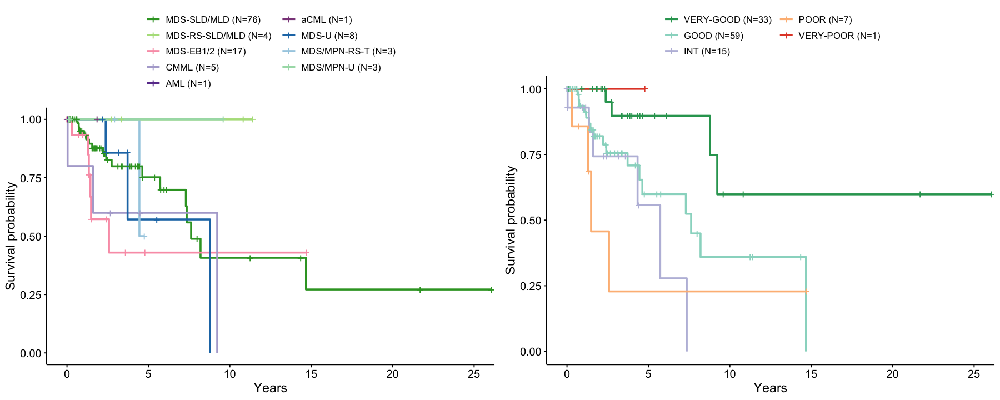

In [175]:
res = ComponentOutcomeStratified(data=ddall,mycomponent="ncomp_NaN") 
grid.arrange(res$ggwho,res$ggipssr,ncol=2)

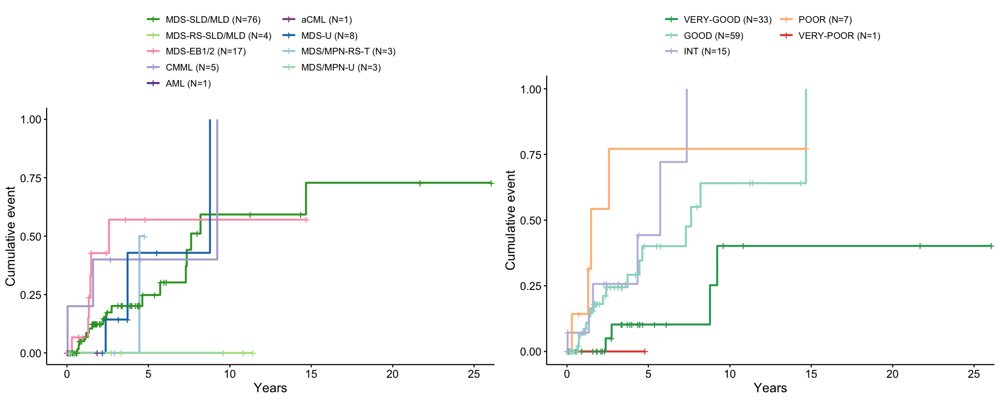

In [176]:
res = ComponentOutcomeAMLStratified(data=ddall,mycomponent="ncomp_NaN") 
grid.arrange(res$ggwho,res$ggipssr,ncol=2)

In [177]:
data = ddall[ddall$predicted_component=="ncomp_NaN",]
data$AGE = data$AGE_AT_SAMPLE_TIME
myclinical=c("AGE","HB","PLT","WBC","ANC","MONOCYTES","PB_BLAST","BM_BLAST","RINGED_SIDEROBLASTS")
hh = melt(data[,c(myclinical,"LEUKID","WHO_2016_SIMPLIFY_2")], id.vars=c("LEUKID","WHO_2016_SIMPLIFY_2"))

In [178]:
options(repr.plot.width=25, repr.plot.height=15)
levels.who = levels=c("MDS-del5q","MDS-SLD/MLD","MDS-RS-SLD/MLD","MDS-EB1/2","CMML","AML","aCML","MDS-U","MDS/MPN-RS-T","MDS/MPN-U")
hh$WHO_2016_SIMPLIFY_2[which(hh$WHO_2016_SIMPLIFY_2=="other")] = NA
hh$WHO_2016_SIMPLIFY_2 = factor(as.vector(hh$WHO_2016_SIMPLIFY_2),levels=levels.who)

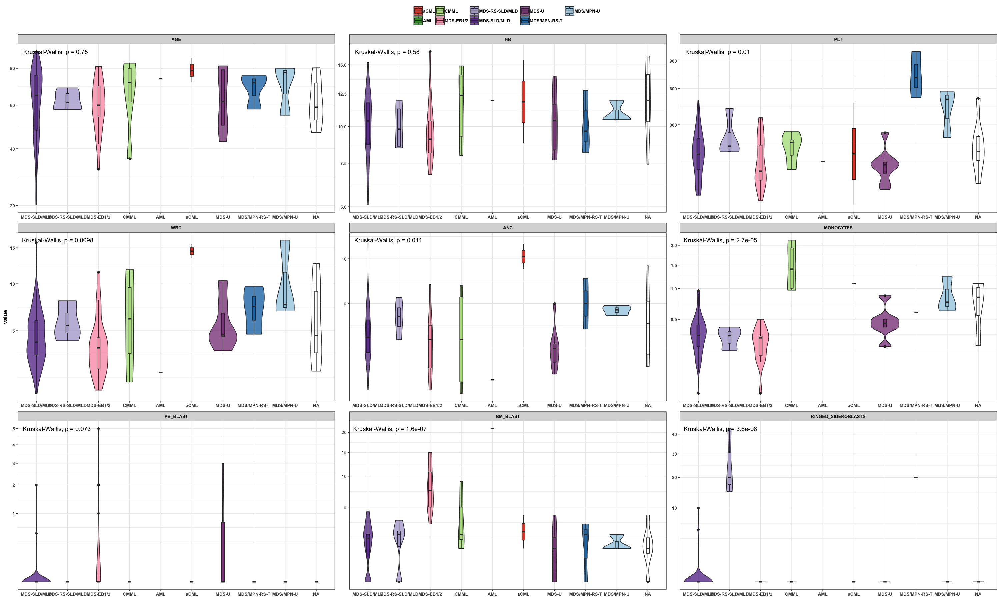

In [179]:
col.who=c("#e34a33","#33a02c","#b2df8a","#fa9fb5","#b2abd2","#6a3d9a","orchid4","#1f78b4","#a6cee3","#a8ddb5")
ggplot(hh,aes(x=WHO_2016_SIMPLIFY_2,y=value,fill=WHO_2016_SIMPLIFY_2)) + geom_violin(alpha=0.8) + geom_boxplot(width=0.1) + facet_wrap(~variable,scales="free") + theme0 + topleg + scale_fill_manual(values=col.who) + nolegtitle + noxtitle + stat_compare_means() + scale_y_sqrt()

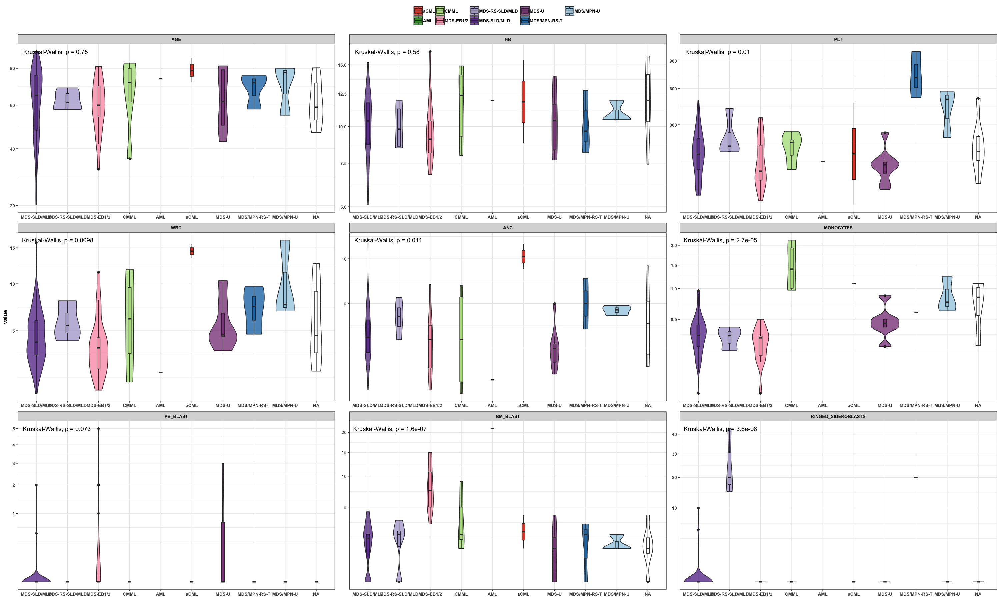

In [180]:
ggplot(hh,aes(x=WHO_2016_SIMPLIFY_2,y=value,fill=WHO_2016_SIMPLIFY_2)) + geom_violin(alpha=0.8) + geom_boxplot(width=0.1) + facet_wrap(~variable,scales="free") + theme0 + topleg + scale_fill_manual(values=col.who) + nolegtitle + noxtitle + stat_compare_means() + scale_y_sqrt()

# Genes Across Components

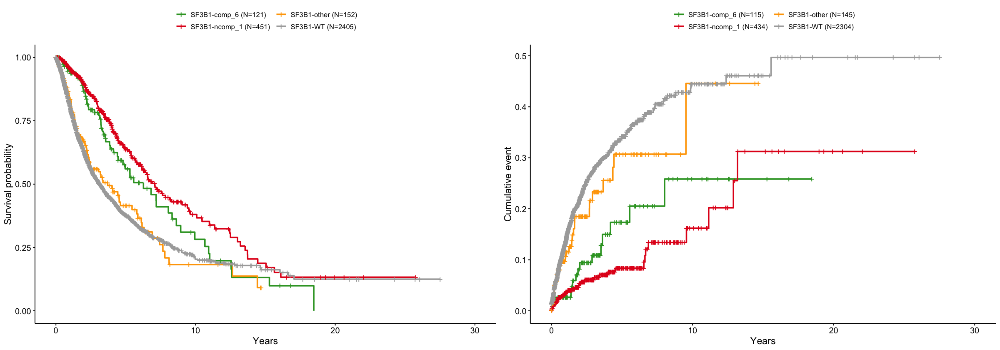

In [29]:
source("./src_utils//my_components.R")
options(repr.plot.width=20, repr.plot.height=7)
res = GeneAcrossComponent(data=ddall, gene="SF3B1",num_comp_select=2,col.component)
grid.arrange(res$ggOS,res$ggAML,ncol=2)

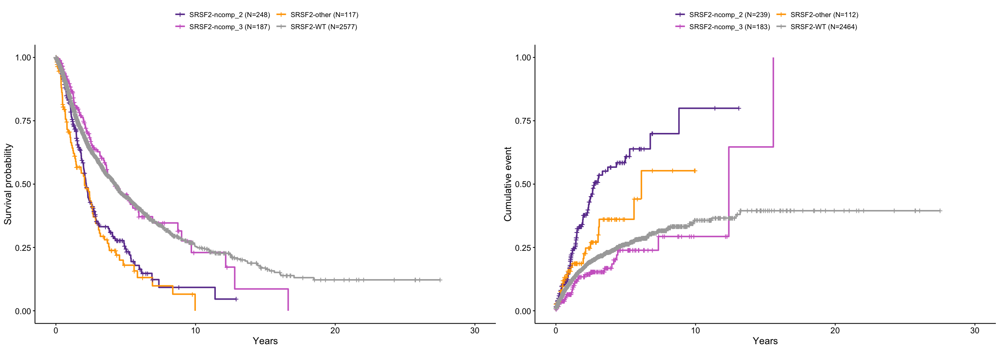

In [30]:
res = GeneAcrossComponent(data=ddall, gene="SRSF2",num_comp_select=2,col.component)
grid.arrange(res$ggOS,res$ggAML,ncol=2)

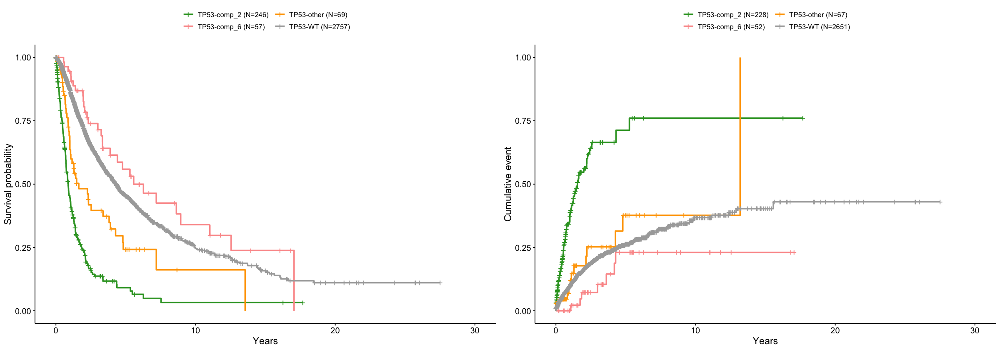

In [31]:
res = GeneAcrossComponent(data=ddall, gene="TP53",num_comp_select=2,col.component)
grid.arrange(res$ggOS,res$ggAML,ncol=2)

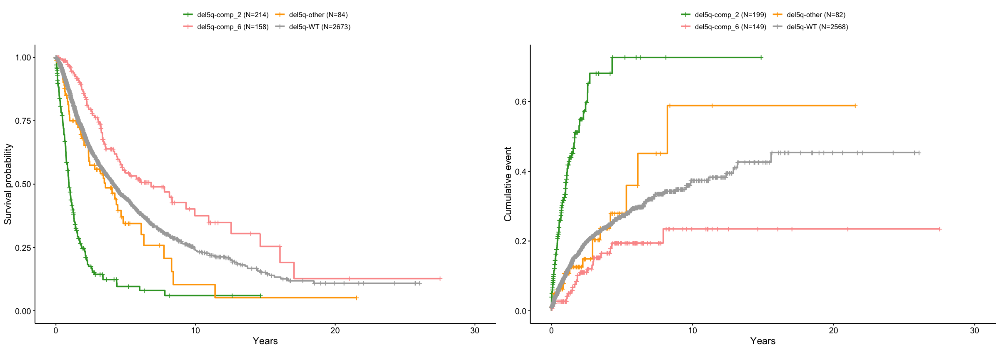

In [32]:
res = GeneAcrossComponent(data=ddall, gene="del5q",num_comp_select=2,col.component)
grid.arrange(res$ggOS,res$ggAML,ncol=2)

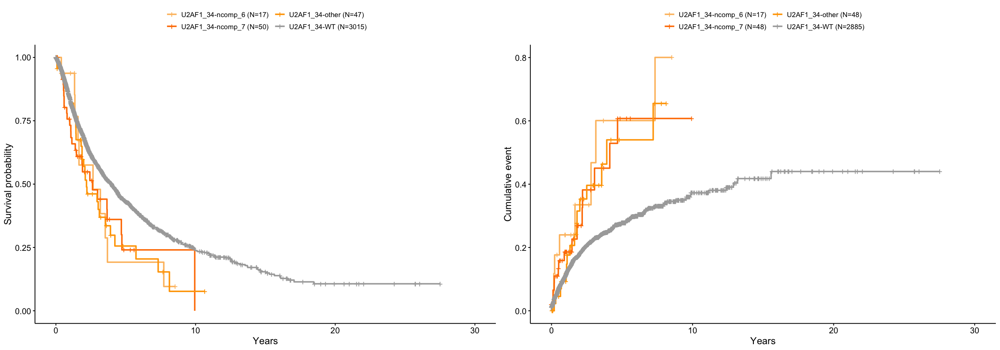

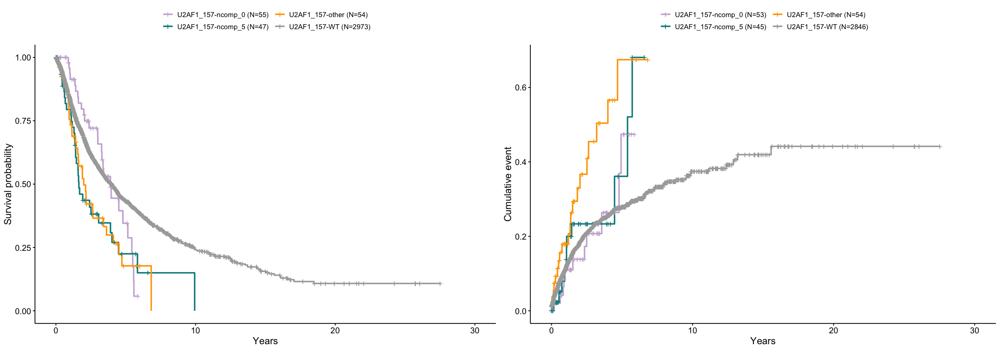

In [481]:
res = GeneAcrossComponent(data=ddall, gene="U2AF1_34",num_comp_select=2,col.component)
grid.arrange(res$ggOS,res$ggAML,ncol=2)
res = GeneAcrossComponent(data=ddall, gene="U2AF1_157",num_comp_select=2,col.component)
grid.arrange(res$ggOS,res$ggAML,ncol=2)

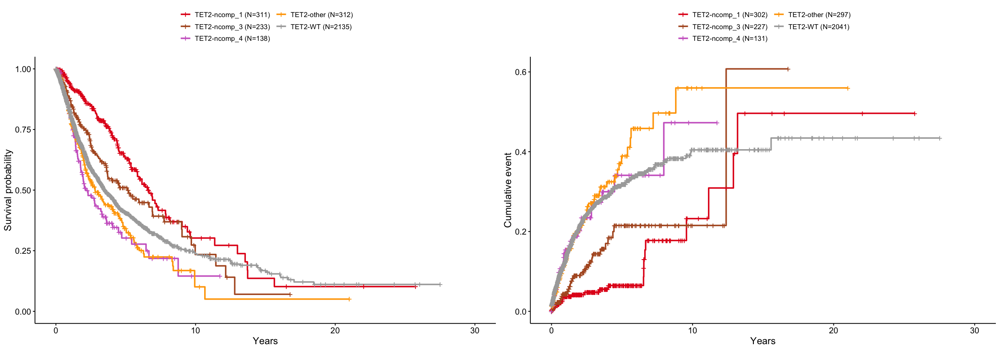

In [483]:
res = GeneAcrossComponent(data=ddall, gene="TET2",num_comp_select=3,col.component)
grid.arrange(res$ggOS,res$ggAML,ncol=2)

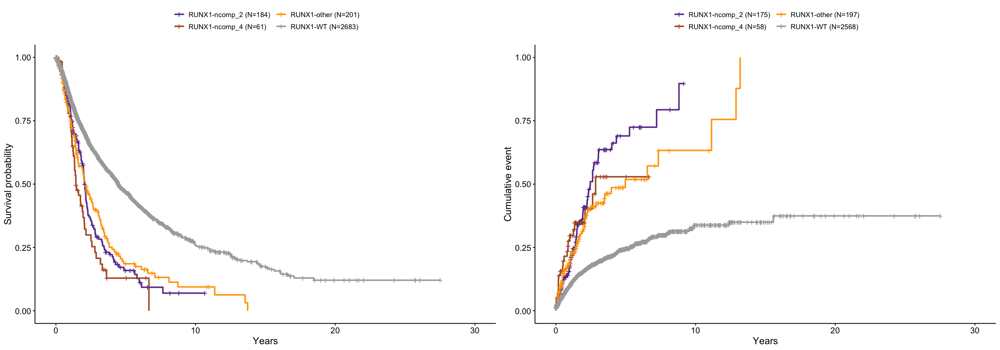

In [485]:
res = GeneAcrossComponent(data=ddall, gene="RUNX1",num_comp_select=2,col.component)
grid.arrange(res$ggOS,res$ggAML,ncol=2)

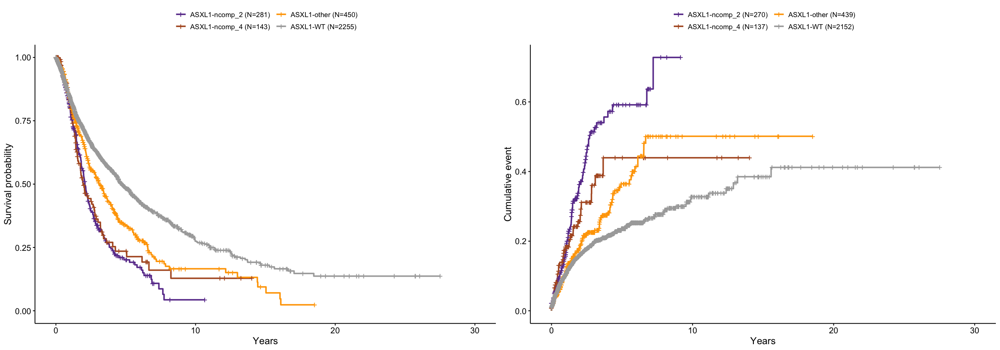

In [486]:
res = GeneAcrossComponent(data=ddall, gene="ASXL1",num_comp_select=2,col.component)
grid.arrange(res$ggOS,res$ggAML,ncol=2)

# Prognosis Analysis

## Univariate OS and AML

Here we compute the univariate OS and AML curves overall and across risk strata.

For OS we use KM estimates,
for AML transformation we use competing risk models.


In [108]:
# GET READY DATA FOR PROGNOSIS ANALYSIS AND COMPETING RISKS
# CENSOR DATA AT 15 YEARS
data = ddall
ios15 = which(data$os_diag_years>15)
iaml15 = which(data$aml_diag_years>15)
data[ios15,"os_diag_years"] = 15
data[ios15,"os_status"] = 0
data[iaml15,"aml_diag_years"] = 15
data[iaml15,"aml_status"] = 0
# ------------------------ #
# TIME AND STATUS FOR COMPETING RISK
data$ftime = pmin(data$os_diag_years, data$aml_diag_years)
data$event = "censor"
data$event[data$os_status==1] = "death"
data$event[data$aml_status==1] = "aml"

In [109]:
table(ddall$predicted_component)
data$my_ipssr = data$IPSSR_CALCULATED
data$my_ipssr[data$my_ipssr%in%c("VERY-GOOD","GOOD")] = "(VERY)-GOOD"
data$my_ipssr[data$my_ipssr%in%c("VERY-POOR","POOR")] = "(VERY)-POOR"
data$my_ipssr = factor(data$my_ipssr, levels=c("(VERY)-GOOD","INT","(VERY)-POOR"))
table(data$my_ipssr, exclude=F)
igood = which(data$my_ipssr=="(VERY)-GOOD")
iint = which(data$my_ipssr=="INT")
ipoor = which(data$my_ipssr=="(VERY)-POOR")


  comp_10    comp_2    comp_6    comp_8    comp_9   ncomp_0   ncomp_1   ncomp_2 
       17       363       284        77        26       294       720       449 
  ncomp_3   ncomp_4   ncomp_5   ncomp_6   ncomp_7 ncomp_NaN 
      374       221       199        40        70       155 


(VERY)-GOOD         INT (VERY)-POOR        <NA> 
       1605         633         799         252 

290 cases omitted due to missing values
169 cases omitted due to missing values
29 cases omitted due to missing values
42 cases omitted due to missing values


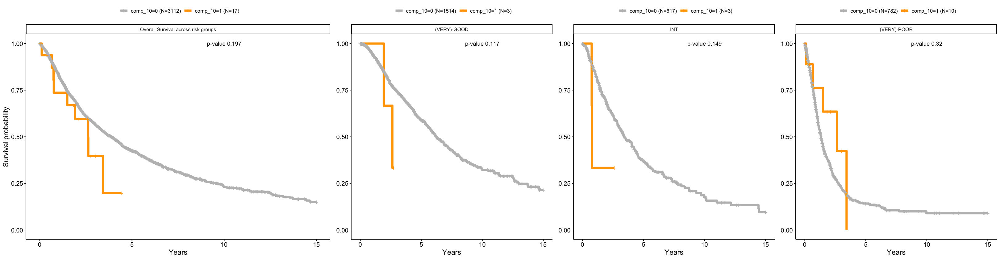

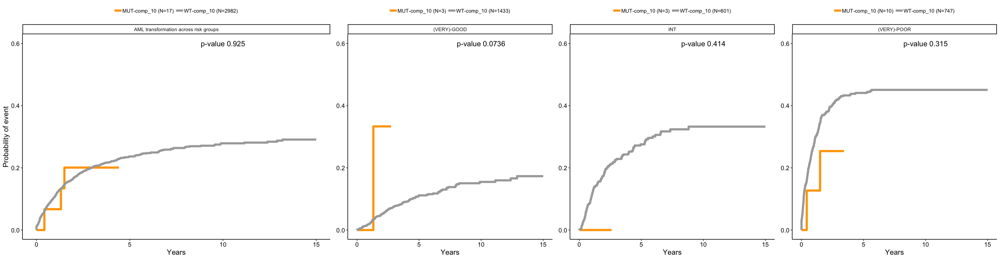

290 cases omitted due to missing values
169 cases omitted due to missing values
29 cases omitted due to missing values
42 cases omitted due to missing values


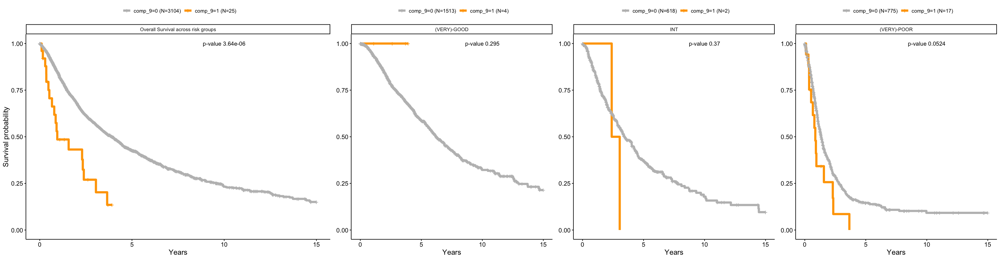

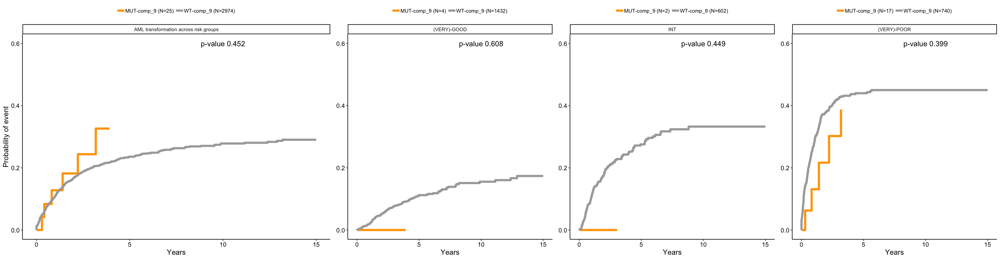

290 cases omitted due to missing values
169 cases omitted due to missing values
29 cases omitted due to missing values
42 cases omitted due to missing values


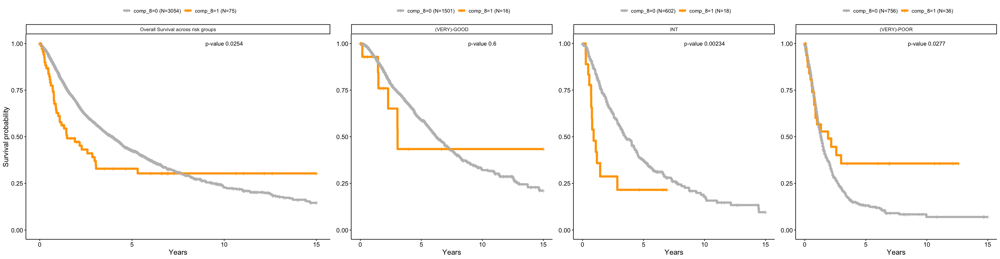

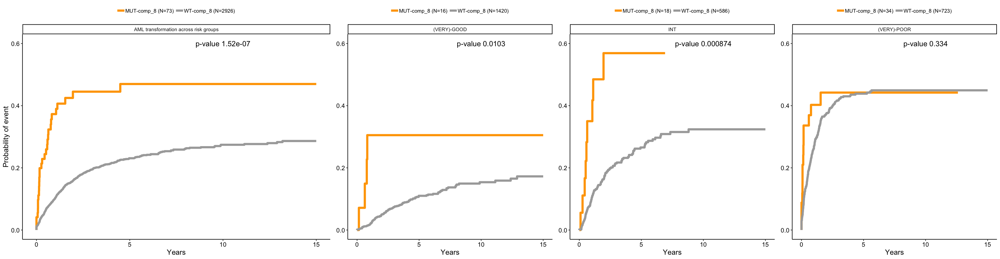

290 cases omitted due to missing values
169 cases omitted due to missing values
29 cases omitted due to missing values
42 cases omitted due to missing values


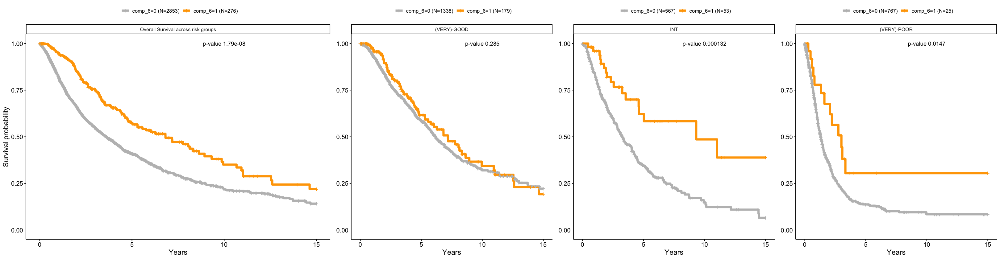

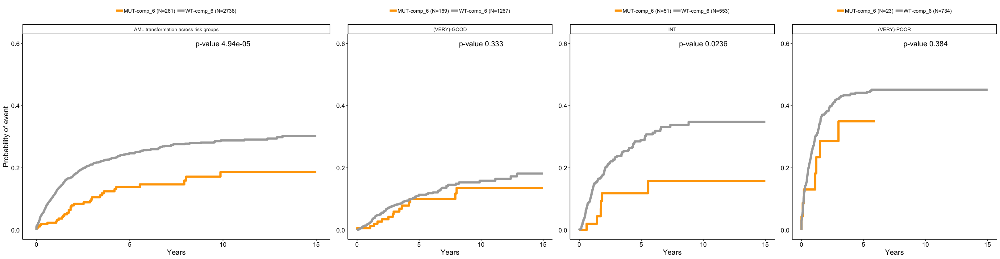

290 cases omitted due to missing values
169 cases omitted due to missing values
29 cases omitted due to missing values
42 cases omitted due to missing values


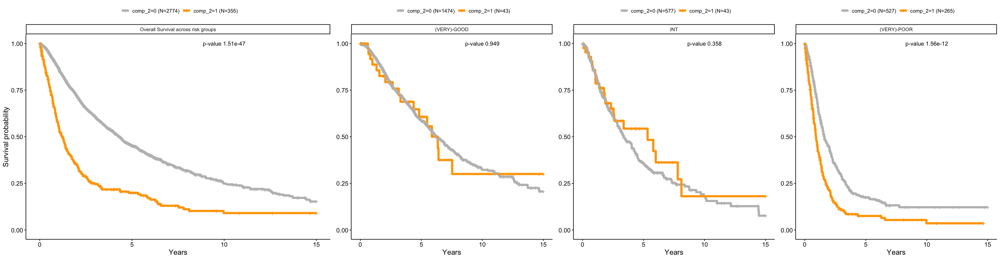

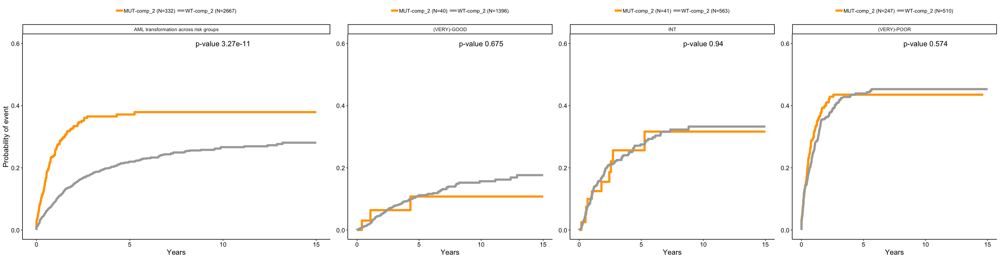

290 cases omitted due to missing values
169 cases omitted due to missing values
29 cases omitted due to missing values
42 cases omitted due to missing values


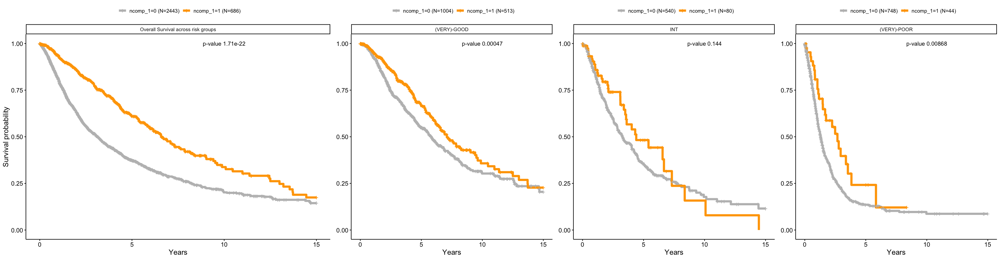

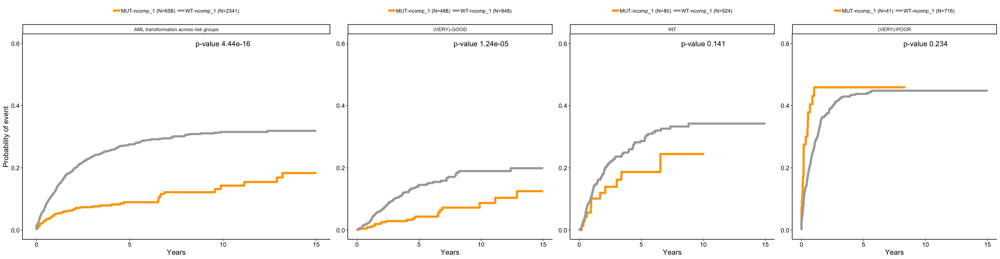

290 cases omitted due to missing values
169 cases omitted due to missing values
29 cases omitted due to missing values
42 cases omitted due to missing values


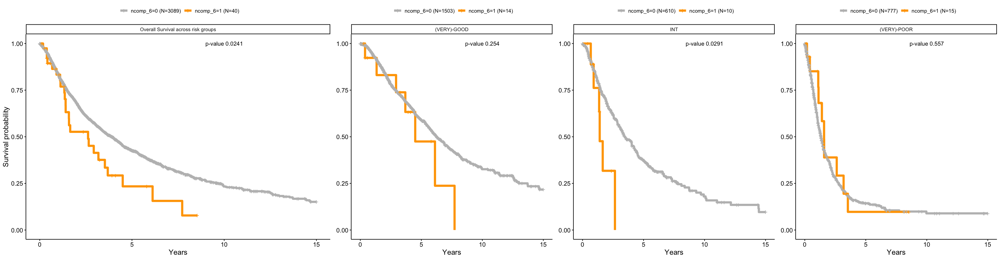

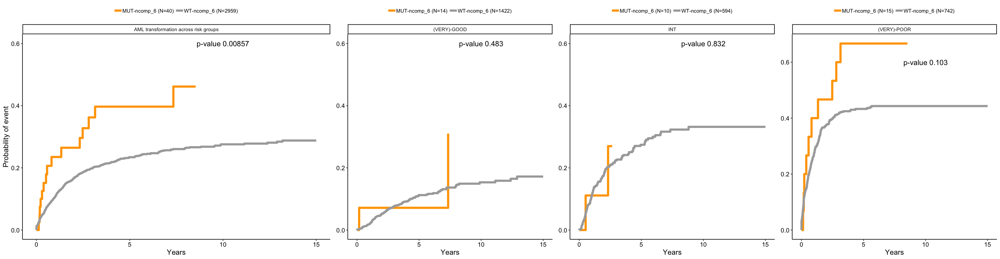

290 cases omitted due to missing values
169 cases omitted due to missing values
29 cases omitted due to missing values
42 cases omitted due to missing values


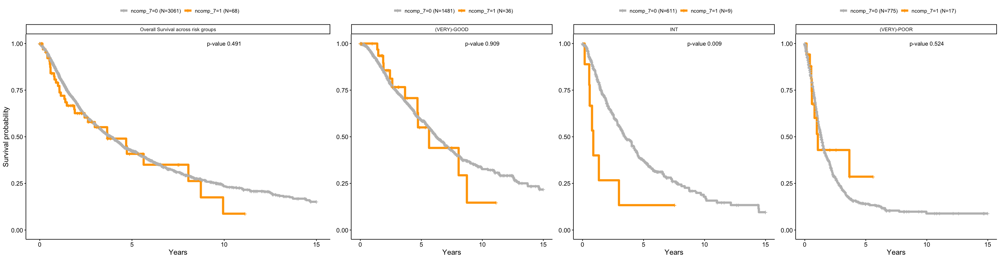

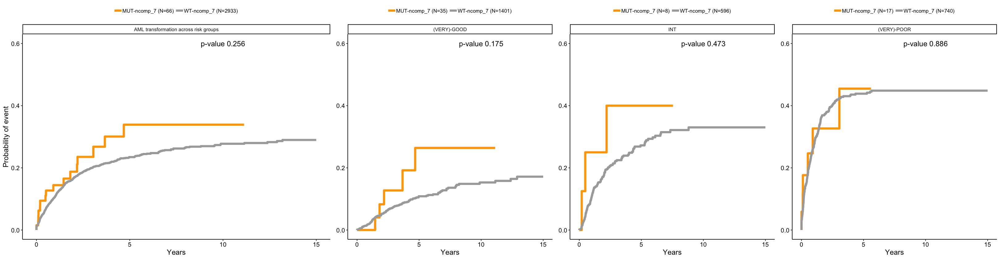

290 cases omitted due to missing values
169 cases omitted due to missing values
29 cases omitted due to missing values
42 cases omitted due to missing values


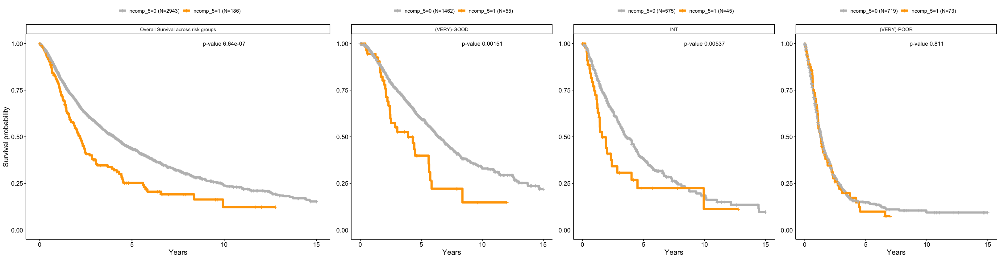

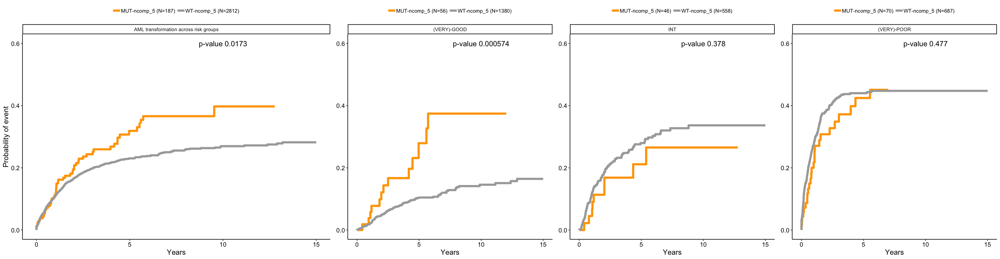

290 cases omitted due to missing values
169 cases omitted due to missing values
29 cases omitted due to missing values
42 cases omitted due to missing values


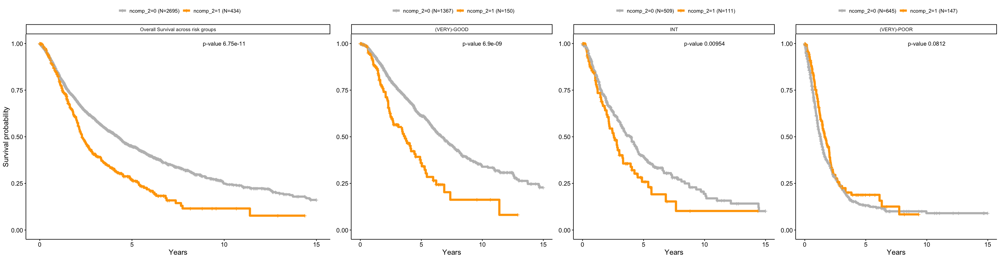

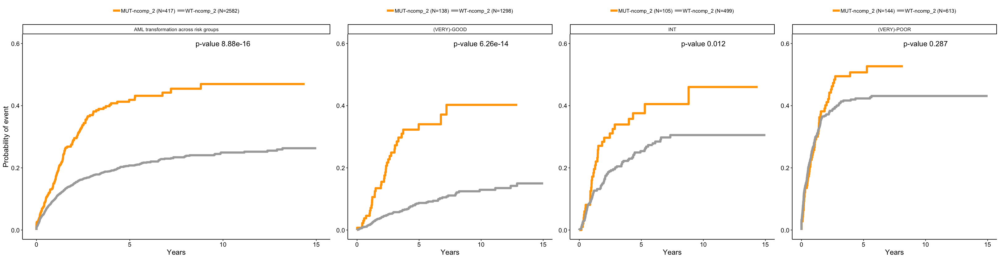

290 cases omitted due to missing values
169 cases omitted due to missing values
29 cases omitted due to missing values
42 cases omitted due to missing values


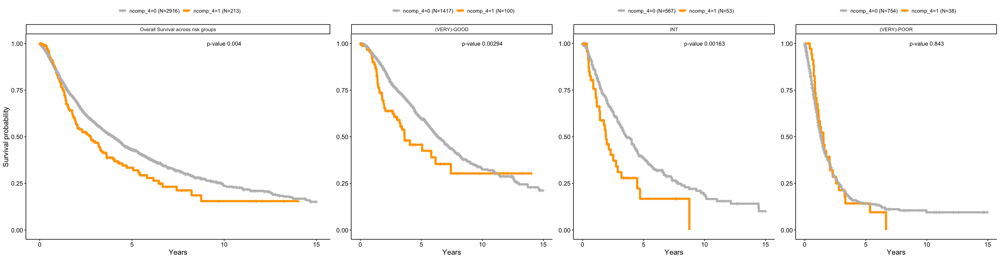

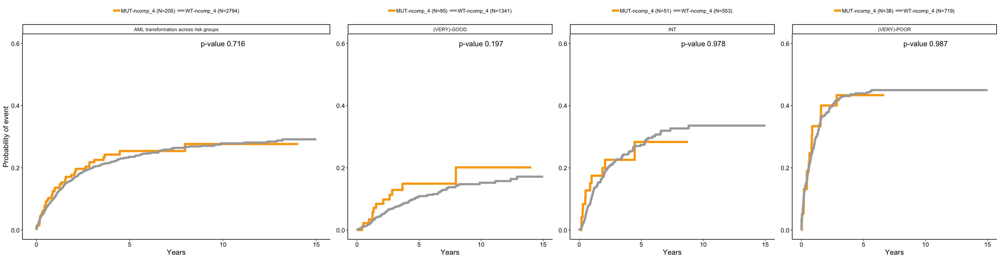

290 cases omitted due to missing values
169 cases omitted due to missing values
29 cases omitted due to missing values
42 cases omitted due to missing values


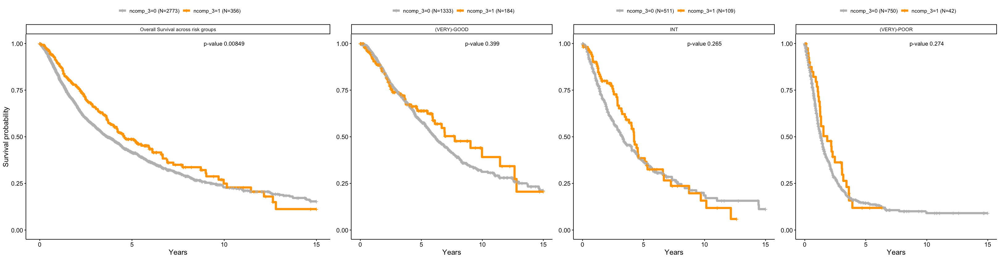

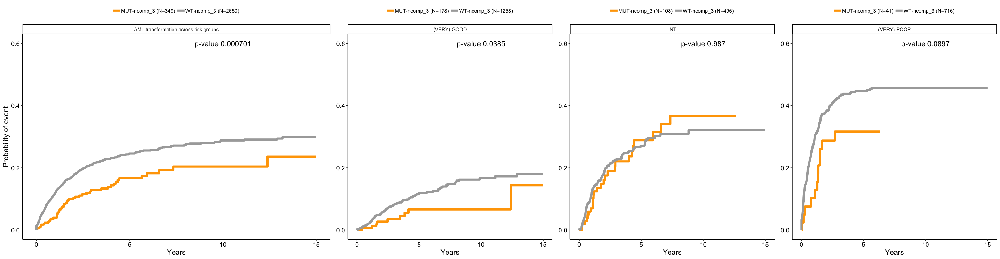

290 cases omitted due to missing values
169 cases omitted due to missing values
29 cases omitted due to missing values
42 cases omitted due to missing values


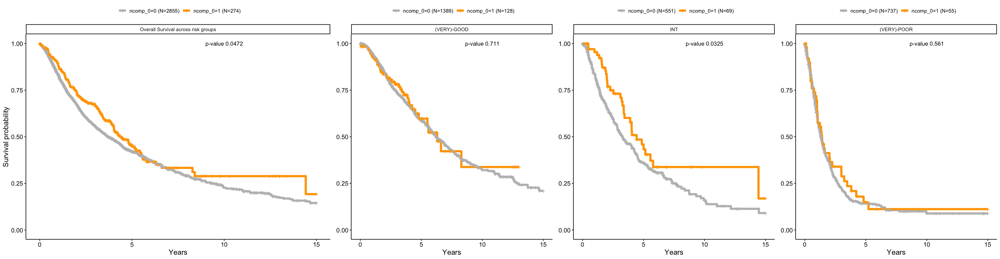

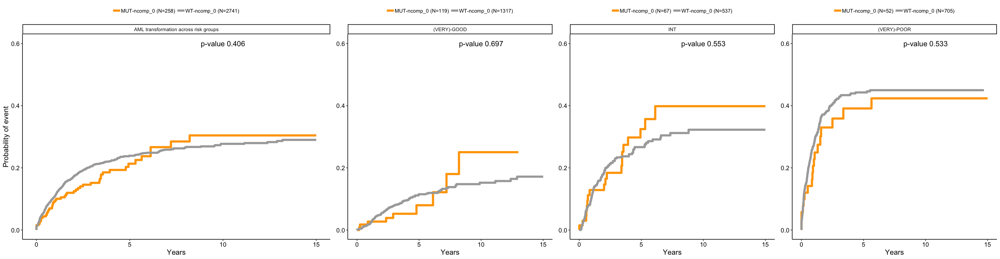

290 cases omitted due to missing values
169 cases omitted due to missing values
29 cases omitted due to missing values
42 cases omitted due to missing values


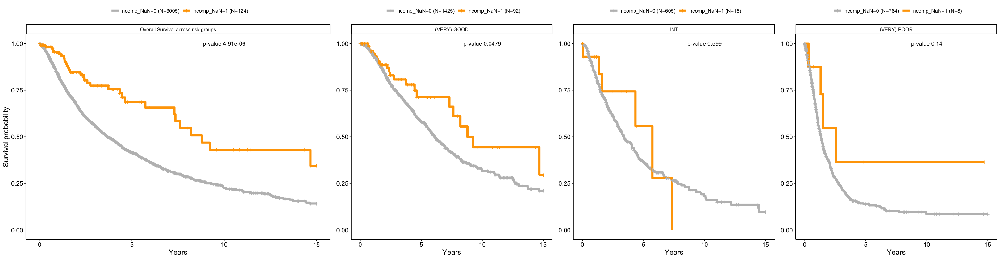

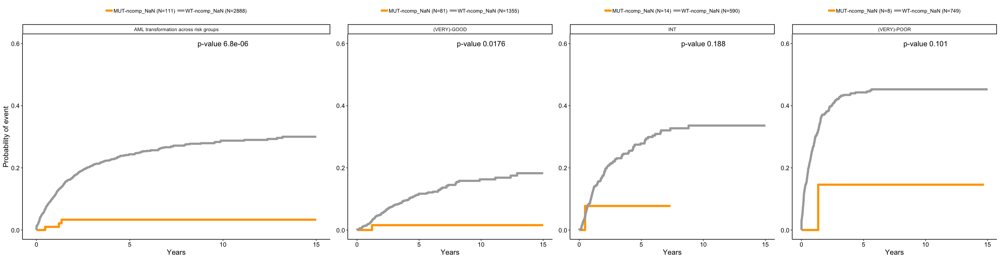

In [110]:
options(repr.plot.width=27, repr.plot.height=7)
for (comp in components) {
    data[,comp] = 0
    data[data$predicted_component==comp,comp] = 1
# Overall Survival
gos.all = gg_os_withlabels(data=data, gene=comp, line.size=2, grid.label="Overall Survival across risk groups")
# OS across IPSS-R Strata
gos.good = gg_os_withlabels(data=data[igood,], gene=comp, line.size=2, grid.label="(VERY)-GOOD") + noytitle 
gos.int = gg_os_withlabels(data=data[iint,], gene=comp, line.size=2, grid.label="INT") + noytitle
gos.poor = gg_os_withlabels(data=data[ipoor,], gene=comp, line.size=2, grid.label="(VERY)-POOR") + noytitle
grid.arrange(gos.all, gos.good, gos.int, gos.poor, ncol=4, widths=c(1.5,1,1,1))
# AML with competing risk
gcr.all = gg_competingrisks_withlabels(data=data, gene=comp, grid.label="AML transformation across risk groups")
# Across IPSS-R Strata
gcr.good = gg_competingrisks_withlabels(data=data[igood,], gene=comp, grid.label="(VERY)-GOOD") + noytitle
gcr.int = gg_competingrisks_withlabels(data=data[iint,], gene=comp, grid.label="INT")  + noytitle
gcr.poor = gg_competingrisks_withlabels(data=data[ipoor,], gene=comp, grid.label="(VERY)-POOR") + noytitle
grid.arrange(gcr.all, gcr.good, gcr.int, gcr.poor, ncol=4, widths=c(1.5,1,1,1))
}

## Volcano Plots for OS and AML

In [113]:
data$AGE = data$AGE_AT_SAMPLE_TIME

In [114]:
get_os_cox_ipss_age <- function(data, gene) {
    # OS ADJUSTED FOR IPPS_R
    ff = as.formula(paste("Surv(os_diag_years, os_status) ~",gene,"+ IPSSR_CALCULATED + AGE"))
    fit.cox = coxph(ff, data=data)
    x = summary(fit.cox)
    beta <- x$coef[gene,1]
    HR <- x$coef[gene,2]
    HR.confint.lower <- signif(x$conf.int[gene,"lower .95"], 2)
    HR.confint.upper <- signif(x$conf.int[gene,"upper .95"],2)
    pval <- x$coef[gene,5]
    frequency <- 100*sum(data[,gene]==1)/nrow(data)
    return(data.frame(gene=gene, frequency=frequency, HR=HR, HRlow95=HR.confint.lower, HRup95=HR.confint.upper,pval=pval))
}

get_os_cox_age <- function(data, gene, formcov="AGE") {
    # OS ADJUSTED FOR IPPS_R
    ff = as.formula(paste("Surv(os_diag_years, os_status) ~",gene,"+ AGE"))
    fit.cox = coxph(ff, data=data)
    x = summary(fit.cox)
    beta <- x$coef[gene,1]
    HR <- x$coef[gene,2]
    HR.confint.lower <- signif(x$conf.int[gene,"lower .95"], 2)
    HR.confint.upper <- signif(x$conf.int[gene,"upper .95"],2)
    pval <- x$coef[gene,5]
    frequency <- round(100*sum(data[,gene]==1)/nrow(data))
    return(data.frame(gene=gene, frequency=frequency, HR=HR, HRlow95=HR.confint.lower, HRup95=HR.confint.upper,pval=pval))
}

volcano_HR_plot <- function(ddres,baselog=10,label_qval_cutoff=0.05,vjust=0,nudge_y=0.5,nudge_x=0.01,label.color="orchid4",label.size=2) {
    ddres$logq = -log(ddres$qval,base=baselog)
    # for text annotation
    ddres$toannotate = NA
    ddres$toannotate[ddres$qval<label_qval_cutoff] = as.vector(ddres$gene[ddres$qval<label_qval_cutoff])

    gg = ggplot(ddres,aes(x=HR,y=-log(ddres$qval,base=baselog))) + geom_point(aes(size=frequency),col="#636363") + theme_classic() + bold20 + xlab("Hazard Ratio") + 
    geom_vline(xintercept=1,linetype="dotted",size=0.5,color="#636363") + 
    geom_hline(yintercept=-log(label_qval_cutoff,base=baselog),linetype="dotted",size=0.5,color="#636363") + 
    scale_x_continuous(trans=paste0("log",baselog)) + topleg + geom_label_repel(aes(label=toannotate),vjust=vjust, nudge_y=nudge_y, nudge_x=nudge_x, color=label.color, size=label.size) 

    if (baselog==10) {
        gg = gg + ylab(expression(paste(-log[10], ,Qvalue)))
    }
    if (baselog==2) {
        gg = gg + ylab(expression(paste(-log[2], ,Qvalue)))
    }
    return(gg)
}

get_aml_crr_ipss_age <- function(data, gene) {
    # AML ADJUSTED FOR IPPS_R AND AGE
    design = model.matrix(as.formula(paste0("~IPSSR_CALCULATED+AGE+",gene)),data=data)
    tmp = data[match(rownames(design),data$LEUKID),]
    fit.crr = crr(ftime=tmp$ftime, fstatus=tmp$event, cov1=design[,-1],cencode="censor",failcode="aml")
    
    x = summary(fit.crr)
    beta <- x$coef[gene,1]
    HR <- x$coef[gene,2]
    #HR.confint.lower <- signif(x$conf.int[gene,"lower .95"], 2)
    #HR.confint.upper <- signif(x$conf.int[gene,"upper .95"],2)
    pval <- x$coef[gene,5]
    frequency <- 100*sum(data[,gene]==1)/nrow(data)
    return(data.frame(gene=gene, frequency=frequency, HR=HR,pval=pval))
}

get_aml_crr_age <- function(data, gene, formcov="AGE") {
    # AML ADJUSTED FOR AGE
    design = model.matrix(as.formula(paste0("~AGE+",gene)),data=data)
    tmp = data[match(rownames(design),data$LEUKID),]
    fit.crr = crr(ftime=tmp$ftime, fstatus=tmp$event, cov1=design[,-1],cencode="censor",failcode="aml")
    
    x = summary(fit.crr)
    beta <- x$coef[gene,1]
    HR <- x$coef[gene,2]
    #HR.confint.lower <- signif(x$conf.int[gene,"lower .95"], 2)
    #HR.confint.upper <- signif(x$conf.int[gene,"upper .95"],2)
    pval <- x$coef[gene,5]
    frequency <- round(100*sum(data[,gene]==1)/nrow(data))
    return(data.frame(gene=gene, frequency=frequency, HR=HR,pval=pval))
}

In [116]:
list.os = list()
list.os.good = list.os.int = list.os.poor =list()
i = 0
for (comp in components) {
    i = i + 1
    # OS ADJUSTED FOR IPPS_R
    list.os[[i]] = get_os_cox_ipss_age(data=data,gene=comp)
    list.os.good[[i]] = get_os_cox_age(data=data[igood,],gene=comp)
    list.os.int[[i]] = get_os_cox_age(data=data[iint,],gene=gene)
    list.os.poor[[i]] = get_os_cox_age(data=data[ipoor,],gene=comp)
}
list.aml = list()
list.aml.good = list.aml.int = list.aml.poor =list()
i = 0
for (comp in components) {
    i = i + 1
    # OS ADJUSTED FOR IPPS_R
    list.aml[[i]] = get_aml_crr_ipss_age(data=data,gene=comp)
    list.aml.good[[i]] = get_aml_crr_age(data=data[igood,],gene=comp)
    list.aml.int[[i]] = get_aml_crr_age(data=data[iint,],gene=comp)
    list.aml.poor[[i]] = get_aml_crr_age(data=data[ipoor,],gene=comp)
}

Warning message in fitter(X, Y, strats, offset, init, control, weights = weights, :
“Loglik converged before variable  1 ; beta may be infinite. ”

240 cases omitted due to missing values
169 cases omitted due to missing values
29 cases omitted due to missing values
42 cases omitted due to missing values
240 cases omitted due to missing values
169 cases omitted due to missing values
29 cases omitted due to missing values
42 cases omitted due to missing values
240 cases omitted due to missing values
169 cases omitted due to missing values
29 cases omitted due to missing values
42 cases omitted due to missing values
240 cases omitted due to missing values
169 cases omitted due to missing values
29 cases omitted due to missing values
42 cases omitted due to missing values
240 cases omitted due to missing values
169 cases omitted due to missing values
29 cases omitted due to missing values
42 cases omitted due to missing values
240 cases omitted due to missing values
169 cases omitted due to missing values
29 cases omitted due to missing values
42 cases omitted due to missing values
240 cases omitted due to missing values
169 cases om

In [120]:
dat.os = do.call("rbind",list.os)
dat.os.good = do.call("rbind",list.os.good)
dat.os.int = do.call("rbind",list.os.int)
dat.os.poor = do.call("rbind",list.os.poor)
dat.os$qval = p.adjust(dat.os$pval,method="BH")
dat.os.good$qval = p.adjust(dat.os.good$pval,method="BH")
dat.os.int$qval = p.adjust(dat.os.int$pval,method="BH")
dat.os.poor$qval = p.adjust(dat.os.poor$pval,method="BH")
dat.aml= do.call("rbind",list.aml)
dat.aml.good = do.call("rbind",list.aml.good)
dat.aml.int = do.call("rbind",list.aml.int)
dat.aml.poor = do.call("rbind",list.aml.poor)
dat.aml$qval = p.adjust(dat.aml$pval,method="BH")
dat.aml.good$qval = p.adjust(dat.aml.good$pval,method="BH")
dat.aml.int$qval = p.adjust(dat.aml.int$pval,method="BH")
dat.aml.poor$qval = p.adjust(dat.aml.poor$pval,method="BH")

Warning message:
“Removed 8 rows containing missing values (geom_label_repel).”Warning message:
“Removed 11 rows containing missing values (geom_label_repel).”

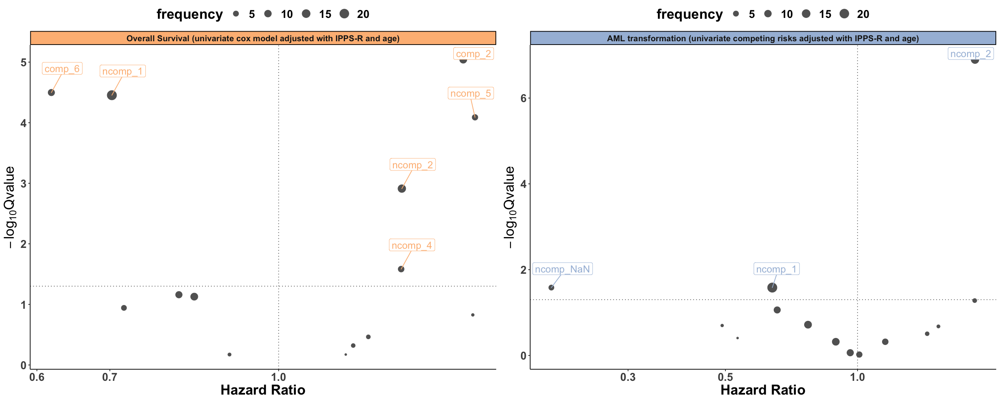

In [121]:
library(ggrepel)
# Volcano Plot of OS across Risk Strata
options(repr.plot.width=20, repr.plot.height=8)
hos = volcano_HR_plot(ddres=dat.os,baselog=10,label_qval_cutoff=0.05,vjust=0,nudge_y=0.3,nudge_x=0.01,label.color="#fdbb84",label.size=5) + 
facet_grid(.~"Overall Survival (univariate cox model adjusted with IPPS-R and age)") +
theme( strip.text = element_text(size=12, face="bold"), strip.background = element_rect(fill="#fdbb84"))
haml = volcano_HR_plot(ddres=dat.aml,baselog=10,label_qval_cutoff=0.05,vjust=0,nudge_y=0.3,nudge_x=0.01,label.color="#a6bddb",label.size=5) + 
facet_grid(.~"AML transformation (univariate competing risks adjusted with IPPS-R and age)") +
theme( strip.text = element_text(size=12, face="bold"), strip.background = element_rect(fill="#a6bddb"))
grid.arrange(hos,haml,ncol=2)

In [122]:
# Volcano Plot of OS per Risk Strata
options(repr.plot.width=27, repr.plot.height=10)
pgood = volcano_HR_plot(ddres=dat.os.good[!dat.os.good$gene%in%c("comp_9"),],baselog=10,label_qval_cutoff=0.05,vjust=0,nudge_y=0.3,nudge_x=0.01,label.color="#59A08B",label.size=6) + facet_grid(.~"(VERY)-GOOD") + theme( strip.text = element_text(size=25, face="bold"), strip.background = element_rect(fill="#59A08B"))
pint = volcano_HR_plot(ddres=dat.os.int,baselog=10,label_qval_cutoff=0.05,vjust=0,nudge_y=0.1,nudge_x=0.05,label.color="#2b8cbe",label.size=6) + facet_grid(.~"INT") + theme( strip.text = element_text(size=25, face="bold"), strip.background = element_rect(fill="#2b8cbe"))
ppoor = volcano_HR_plot(ddres=dat.os.poor,baselog=10,label_qval_cutoff=0.05,vjust=0,nudge_y=0.3,nudge_x=0.01,label.color="#fdbb84",label.size=6) + facet_grid(.~"(VERY)-POOR") + theme( strip.text = element_text(size=25, face="bold"), strip.background = element_rect(fill="#fdbb84"))

# Volcano Plot of AML per Risk Strata
options(repr.plot.width=27, repr.plot.height=10)
pgood.aml = volcano_HR_plot(ddres=dat.aml.good[!dat.aml.good$gene%in%c("comp_9"),],baselog=10,label_qval_cutoff=0.05,vjust=0,nudge_y=0.3,nudge_x=0,label.color="#59A08B",label.size=6) + facet_grid(.~"(VERY)-GOOD") + theme( strip.text = element_text(size=25, face="bold"), strip.background = element_rect(fill="#59A08B"))
pint.aml = volcano_HR_plot(ddres=dat.aml.int,baselog=10,label_qval_cutoff=0.05,vjust=0,nudge_y=0.3,nudge_x=0,label.color="#2b8cbe",label.size=6) + facet_grid(.~"INT") + theme( strip.text = element_text(size=25, face="bold"), strip.background = element_rect(fill="#2b8cbe"))
ppoor.aml = volcano_HR_plot(ddres=dat.aml.poor,baselog=10,label_qval_cutoff=0.05,vjust=0,nudge_y=-.1,nudge_x=0,label.color="#fdbb84",label.size=6) + facet_grid(.~"(VERY)-POOR") + theme( strip.text = element_text(size=25, face="bold"), strip.background = element_rect(fill="#fdbb84"))

Warning message:
“Removed 9 rows containing missing values (geom_label_repel).”Warning message:
“Removed 14 rows containing missing values (geom_label_repel).”Warning message:
“Removed 12 rows containing missing values (geom_label_repel).”Warning message:
“Removed 10 rows containing missing values (geom_label_repel).”Warning message:
“Removed 10 rows containing missing values (geom_label_repel).”Warning message:
“Removed 14 rows containing missing values (geom_label_repel).”

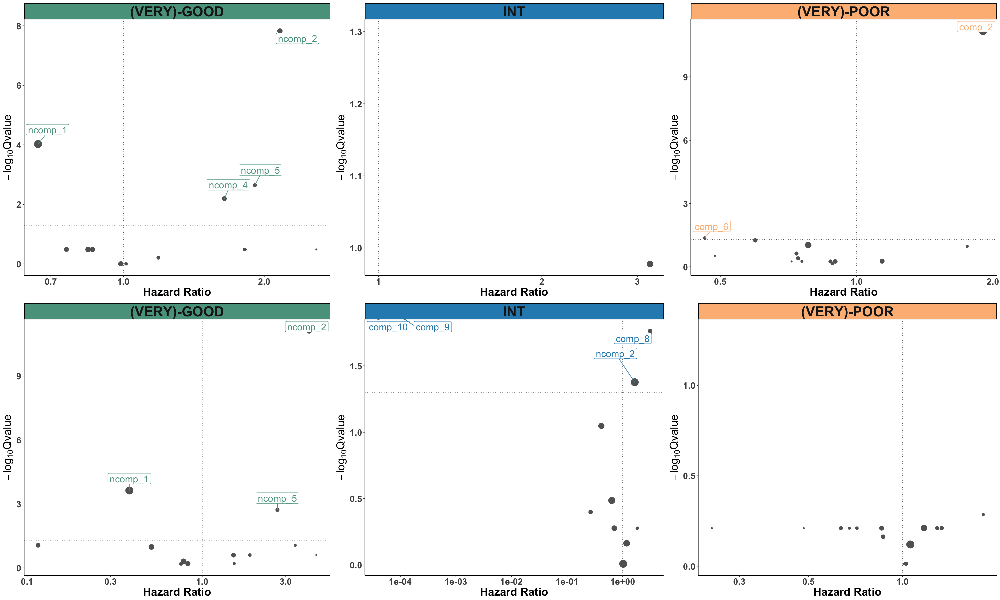

In [123]:
options(repr.plot.width=25, repr.plot.height=15)
grid.arrange(pgood+noleg,pint+noleg,ppoor+noleg,pgood.aml+noleg,pint.aml+noleg,ppoor.aml+noleg,ncol=3)

In [82]:
dat.os.good

gene,frequency,HR,HRlow95,HRup95,pval,qval
comp_10,0,2.584843e+00,0.64,10.00,1.808570e-01,3.266786e-01
comp_9,0,8.995133e-07,0.00,Inf,9.894957e-01,9.894957e-01
comp_8,1,1.813513e+00,0.81,4.10,1.497894e-01,3.266786e-01
comp_6,11,8.589081e-01,0.67,1.10,2.338907e-01,3.274470e-01
comp_2,3,1.187776e+00,0.73,1.90,4.865688e-01,6.192694e-01
ncomp_1,33,6.572326e-01,0.54,0.79,1.342575e-05,9.398026e-05
ncomp_6,1,1.820873e+00,0.86,3.80,1.162466e-01,3.254904e-01
ncomp_7,2,1.013474e+00,0.57,1.80,9.634676e-01,9.894957e-01
ncomp_5,4,1.910173e+00,1.30,2.70,4.833938e-04,2.255838e-03
ncomp_2,10,2.160575e+00,1.70,2.80,1.065141e-09,1.491198e-08


In [84]:
dat.aml.good

gene,frequency,HR,pval,qval
comp_10,0,4.4870092305,1.5e-01,2.488889e-01
comp_9,0,0.0003198865,0.0e+00,0.000000e+00
comp_8,1,3.3963585224,3.7e-02,8.633333e-02
comp_6,11,0.7820662308,3.8e-01,4.836364e-01
comp_2,3,0.7566855250,6.4e-01,6.400000e-01
ncomp_1,33,0.3834012046,5.0e-05,2.333333e-04
ncomp_6,1,1.5243773438,5.4e-01,6.246154e-01
ncomp_7,2,1.8708727101,1.6e-01,2.488889e-01
ncomp_5,4,2.6896163948,5.4e-04,1.890000e-03
ncomp_2,10,4.0838524826,1.1e-12,7.700000e-12


# Multivariate OS

In [351]:
table(data$predicted_component)
table(data$IPSSR_CALCULATED)


  comp_10    comp_2    comp_6    comp_8    comp_9   ncomp_0   ncomp_1   ncomp_2 
       17       363       284        77        26       294       720       449 
  ncomp_3   ncomp_4   ncomp_5   ncomp_6   ncomp_7 ncomp_NaN 
      374       221       199        40        70       155 


     GOOD       INT      POOR VERY-GOOD VERY-POOR 
     1113       633       444       492       355 

In [352]:
design = model.matrix(~0+predicted_component + IPSSR_CALCULATED,data=data)
colnames(design) = gsub("predicted_component","",colnames(design))
colnames(design) = gsub("CALCULATED","",colnames(design))
colnames(design) = gsub("-","",colnames(design))

In [353]:
mydf = cbind(design,data[match(rownames(design),data$LEUKID),c("AGE","os_diag_years", "os_status", "aml_diag_years","aml_status")])

In [396]:
ff = as.formula(paste0("Surv(os_diag_years, os_status) ~",paste0(colnames(design),collapse="+"),"+AGE"))
res.cox = coxph(ff, data=mydf)
res.cox

Call:
coxph(formula = ff, data = mydf)

                   coef exp(coef) se(coef)     z       p
comp_10         0.68001   1.97391  0.38141  1.78 0.07461
comp_2          0.79532   2.21515  0.19587  4.06 4.9e-05
comp_6         -0.11618   0.89031  0.20629 -0.56 0.57329
comp_8          0.68142   1.97668  0.24790  2.75 0.00598
comp_9          0.95163   2.58992  0.31235  3.05 0.00231
ncomp_0         0.18746   1.20619  0.20486  0.92 0.36016
ncomp_1         0.01484   1.01496  0.19298  0.08 0.93868
ncomp_2         0.62560   1.86937  0.19372  3.23 0.00124
ncomp_3         0.17959   1.19672  0.19873  0.90 0.36617
ncomp_4         0.62474   1.86777  0.20598  3.03 0.00242
ncomp_5         0.83307   2.30036  0.20443  4.08 4.6e-05
ncomp_6         0.37737   1.45844  0.27882  1.35 0.17591
ncomp_7         0.51808   1.67881  0.26122  1.98 0.04733
ncomp_NaN            NA        NA  0.00000    NA      NA
IPSSR_INT       0.43863   1.55058  0.07667  5.72 1.1e-08
IPSSR_POOR      0.97377   2.64792  0.08254 11.80

In [397]:
x <- summary(res.cox)
res.df = as.data.frame(cbind(x$coef[,c(2,5)],x$conf.int[,c(3,4)]))
res.df$variable = rownames(res.df)
colnames(res.df) = c("HR","pval","HRlow","HRhigh","variable")
res.df = res.df[!is.na(res.df$HR),]
oo = res.df[grep("comp",res.df$variable),]
res.df$variable = factor(res.df$variable, levels=rev(c(oo$variable[sort(oo$HR,decreasing=T,index.r=T)$ix],"IPSSR_VERYPOOR","IPSSR_POOR","IPSSR_INT","IPSSR_VERYGOOD","AGE")))
res.df$annot = NA
res.df$annot[res.df$pval<0.05] = signif(res.df$pval[res.df$pval<0.05],2)

In [398]:
fos = ggplot(res.df, aes(x=variable,y=HR)) + geom_point(size=5,color="#fdbb84") + geom_hline(yintercept=1,color="darkgrey") + geom_errorbar(aes(ymin=HRlow,ymax=HRhigh),color="#fdbb84",size=1) + geom_text(aes(x=variable,y=-0.5,label=annot),col="darkgrey") + theme1 + coord_flip()

Warning message:
“Removed 6 rows containing missing values (geom_text).”

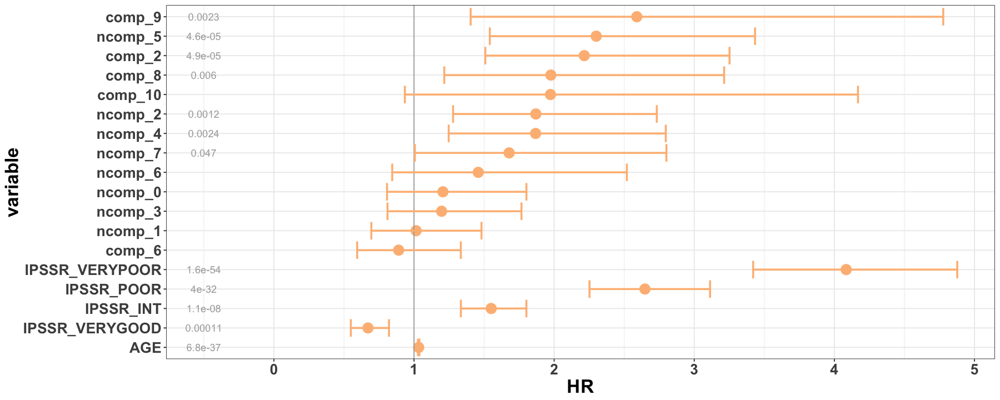

In [399]:
options(repr.plot.width=15, repr.plot.height=6)
fos

# Multivariate AMLt

In [404]:
ff = as.formula(paste0("Surv(aml_diag_years, aml_status) ~",paste0(colnames(design),collapse="+"),"+AGE"))
res.cox = coxph(ff, data=mydf)
res.cox

Call:
coxph(formula = ff, data = mydf)

                   coef exp(coef) se(coef)     z       p
comp_10         1.36604   3.91981  0.81934  1.67 0.09547
comp_2          1.82284   6.18944  0.59027  3.09 0.00201
comp_6          1.07936   2.94278  0.60928  1.77 0.07647
comp_8          2.29586   9.93299  0.61253  3.75 0.00018
comp_9          1.28386   3.61054  0.73586  1.74 0.08104
ncomp_0         1.57228   4.81764  0.59704  2.63 0.00845
ncomp_1         1.14896   3.15492  0.59474  1.93 0.05338
ncomp_2         2.22822   9.28335  0.58613  3.80 0.00014
ncomp_3         1.35499   3.87673  0.59678  2.27 0.02318
ncomp_4         1.86752   6.47225  0.60113  3.11 0.00189
ncomp_5         1.82659   6.21267  0.59752  3.06 0.00224
ncomp_6         1.98148   7.25345  0.64050  3.09 0.00198
ncomp_7         2.07180   7.93907  0.63697  3.25 0.00114
ncomp_NaN            NA        NA  0.00000    NA      NA
IPSSR_INT       0.81367   2.25616  0.13135  6.19 5.8e-10
IPSSR_POOR      1.37840   3.96853  0.13662 10.09

In [408]:

x <- summary(res.cox)
res.df = as.data.frame(cbind(x$coef[,c(2,5)],x$conf.int[,c(3,4)]))
res.df$variable = rownames(res.df)
colnames(res.df) = c("HR","pval","HRlow","HRhigh","variable")
res.df = res.df[!is.na(res.df$HR),]
oo = res.df[grep("comp",res.df$variable),]
res.df$variable = factor(res.df$variable, levels=rev(c(oo$variable[sort(oo$HR,decreasing=T,index.r=T)$ix],"IPSSR_VERYPOOR","IPSSR_POOR","IPSSR_INT","IPSSR_VERYGOOD","AGE")))
res.df$annot = NA
res.df$annot[res.df$pval<0.05] = signif(res.df$pval[res.df$pval<0.05],2)

faml = ggplot(res.df, aes(x=variable,y=HR)) + geom_point(size=5,color="#a6bddb") + geom_hline(yintercept=1,color="darkgrey") + geom_errorbar(aes(ymin=HRlow,ymax=HRhigh),color="#a6bddb",size=1) + geom_text(aes(x=variable,y=-1,label=annot),col="darkgrey") + theme1 + coord_flip()

Warning message:
“Removed 5 rows containing missing values (geom_text).”

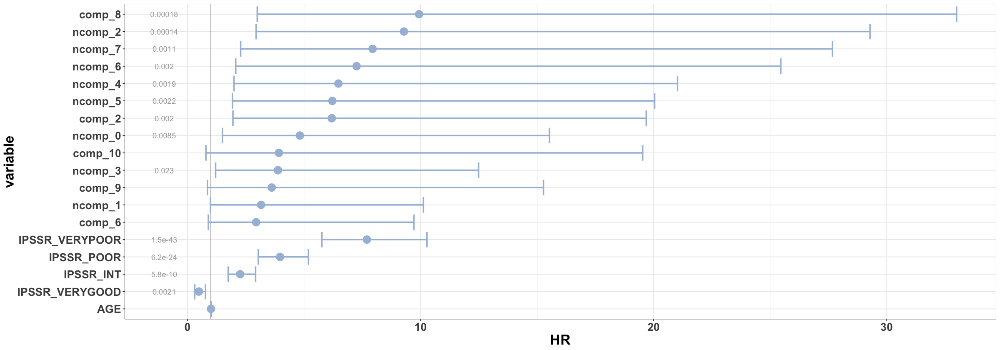

In [409]:
faml

Warning message:
“Removed 6 rows containing missing values (geom_text).”Warning message:
“Removed 5 rows containing missing values (geom_text).”

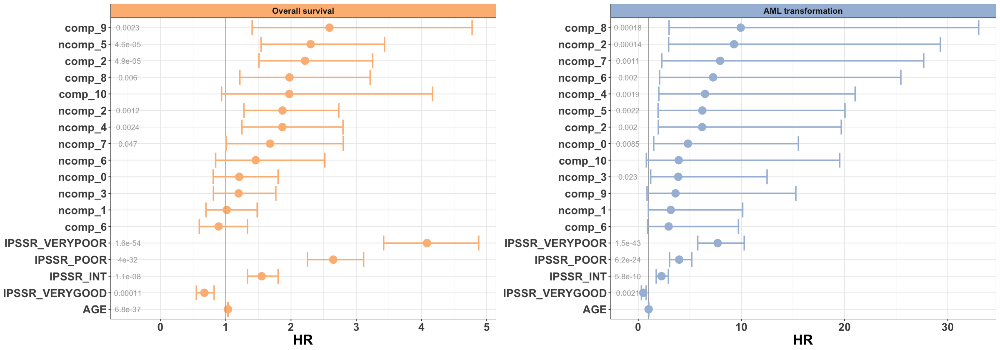

In [410]:
options(repr.plot.width=20, repr.plot.height=7)

grid.arrange(fos+noytitle+facet_grid(.~"Overall survival")+theme( strip.text = element_text(size=12, face="bold"), strip.background = element_rect(fill="#fdbb84")),faml+noytitle+facet_grid(.~"AML transformation")+theme( strip.text = element_text(size=12, face="bold"), strip.background = element_rect(fill="#a6bddb")),ncol=2)

# Multivariate Competing Risk For AML

TODO